In [23]:
#import gdal
from osgeo import gdal
from numpy import *

import matplotlib.pyplot as plt
%matplotlib inline

import rasterio
from rasterio import plot

from spectral import *
import spectral.io.envi

from rasterio.plot import show

import pandas as pd
import geopandas

import shapely
from shapely.geometry import Point
from shapely.geometry import Polygon
from shapely.geometry import MultiPolygon
from shapely import wkt
from shapely.geometry import shape, mapping

#import shapely.wkt
import shapely.geometry as geometry

In [2]:
noneuc = geopandas.read_file("Non_Eucalyptus_Reg_Ecos_2017/Non_Eucalypt_RE.shp")
euc = geopandas.read_file("Monospecies_Reg_Ecos_2017/FF_SingleSp_RE_2017_V11.shp")
eucmg = geopandas.read_file("Monogenus_Monotribe_Eucalypt_Reg_Ecos_2017/Monotribe_Eucalypt_REs_2017_100pct.shp")

ucl = euc['QLD_REG_EC'].unique().tolist()
uclm = eucmg['RE'].unique().tolist()

uclb = ucl + uclm

euco = {k: v for v, k in enumerate(ucl)} 

nonucl = noneuc['RE'].unique().tolist()
noneuco = {k: v for v, k in enumerate(nonucl)}

zg = {**euco, **noneuco}
import copy
zgz = copy.deepcopy(zg)
counter = 10
zk = list(zgz.keys())
for p in range(0,len(zgz)):
    zgz[zk[p]] = counter
    counter += 1

In [3]:
import json
from shapely.geometry import shape, GeometryCollection

with open("australian-states.json") as f:
    features = json.load(f)["features"]

# NOTE: buffer(0) is a trick for fixing scenarios where polygons have overlapping coordinates 
x = GeometryCollection([shape(feature["geometry"]).buffer(0) for feature in features])

queensland = x[2]

In [4]:

kirrama = Polygon([
                    [145.5744, -18.27014],
                    [145.78456, -18.27014],
                    [145.78456, -18.1522],
                    [145.5744, -18.1522],
                    [145.5744, -18.27014]
                ])

danbulla = Polygon([
                    [145.555, -17.275],
                    [145.755, -17.275],
                    [145.755, -17.00],
                    [145.555, -17.00],
                    [145.555, -17.275]
                ])

herberton = Polygon([
            [145.41327472275032, -17.36669084460675],
            [145.41327472275032, -17.55535805363121],
            [145.5425637008542, -17.55535805363121],
            [145.5425637008542, -17.36669084460675],
            [145.41327472275032, -17.36669084460675]
          ])    

mountbarney =  Polygon([[
              152.39999999999998,
              -28
            ],
            [
              152.39999999999998,
              -28.6
            ],
            [
              153,
              -28.6
            ],
            [
              153,
              -28
            ],
            [
              152.39999999999998,
              -28
            ]])

belyando =  Polygon([[
              146.8,
              -21.55
            ],
            [
              146.8,
              -21.95
            ],
            [
              147.2,
              -21.95
            ],
            [
              147.2,
              -21.55
            ],
            [
              146.8,
              -21.55
            ]])

andromache =  Polygon([[
              148.15,
              -20.35
            ],
            [
              148.15,
              -20.75
            ],
            [
              148.54999999999998,
              -20.75
            ],
            [
              148.54999999999998,
              -20.35
            ],
            [
              148.15,
              -20.35
            ]])

kirrama_gp = geopandas.GeoSeries([kirrama])
danbulla_gp = geopandas.GeoSeries([danbulla])
herberton_gp = geopandas.GeoSeries([herberton])
mountbarney_gp = geopandas.GeoSeries([mountbarney])
belyando_gp = geopandas.GeoSeries([belyando])
andromache_gp = geopandas.GeoSeries([andromache])

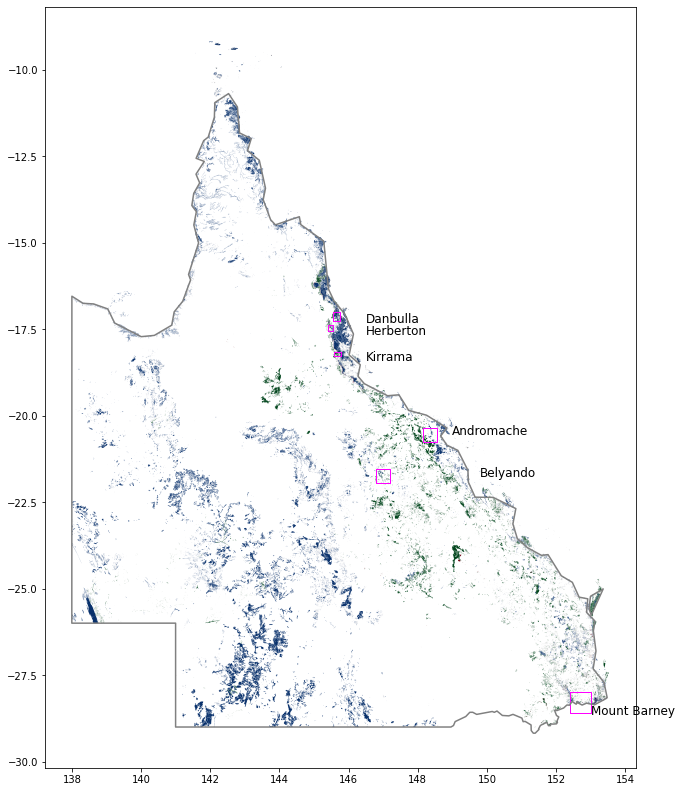

In [623]:
cmap_reds=plt.cm.get_cmap('Reds', 2)
cmap_blues=plt.cm.get_cmap('Blues', 2)
cmap_greens=plt.cm.get_cmap('Greens', 2)

fg=14

queensland_gs = geopandas.GeoSeries(queensland)
ax = queensland_gs.geometry.boundary.plot(color='grey',figsize=(fg,fg))
#ax = queensland.plot(color='black',figsize=(fg,fg))

noneuc.plot(ax=ax,color=cmap_blues(2),figsize=(fg,fg))
euc.plot(ax=ax,color=cmap_reds(2),figsize=(fg,fg))
eucmg.plot(ax=ax,color=cmap_greens(2),figsize=(fg,fg))

kirrama_gp.plot(ax=ax,color='None',edgecolor='magenta',figsize=(fg,fg))
plt.text(146.5, -18.4, "Kirrama", fontsize=12)
danbulla_gp.plot(ax=ax,color='None',edgecolor='magenta',figsize=(fg,fg))
plt.text(146.5, -17.32, "Danbulla", fontsize=12)
herberton_gp.plot(ax=ax,color='None',edgecolor='magenta',figsize=(fg,fg))
plt.text(146.5, -17.64, "Herberton", fontsize=12)
andromache_gp.plot(ax=ax,color='None',edgecolor='magenta',figsize=(fg,fg))
plt.text(149, -20.55, "Andromache", fontsize=12)
belyando_gp.plot(ax=ax,color='None',edgecolor='magenta',figsize=(fg,fg))
plt.text(149.8, -21.75, "Belyando", fontsize=12)
mountbarney_gp.plot(ax=ax,color='None',edgecolor='magenta',figsize=(fg,fg))
plt.text(153, -28.64, "Mount Barney", fontsize=12)
fg=12

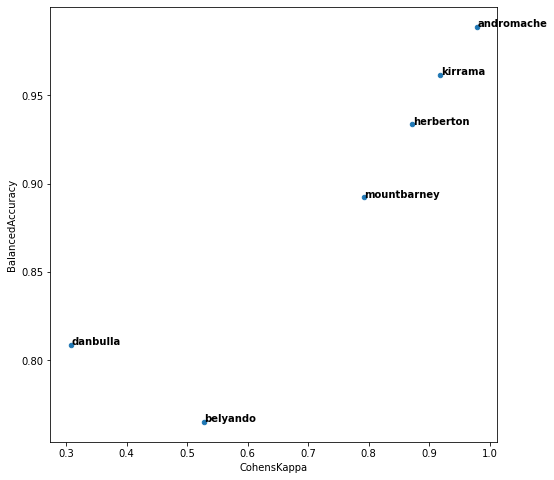

In [678]:
res = pd.read_csv("res.csv")
ax = res.plot.scatter(x="CohensKappa",y="BalancedAccuracy",figsize=(8,8))
for line in range(0,res.shape[0]):
     ax.text(res.CohensKappa[line]+0.001, res.BalancedAccuracy[line], res.location[line], horizontalalignment='left', size='medium', color='black', weight='semibold')

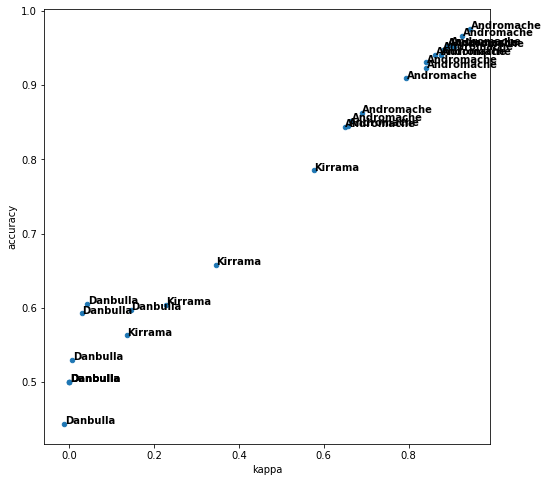

In [853]:
res = pd.read_csv("point_training_results.csv")
ax = res.plot.scatter(x="kappa",y="accuracy",figsize=(8,8))
for line in range(0,res.shape[0]):
     ax.text(res.kappa[line]+0.001, res.accuracy[line], res.location[line], horizontalalignment='left', size='medium', color='black', weight='semibold')

___


# First Location: Herberton
___

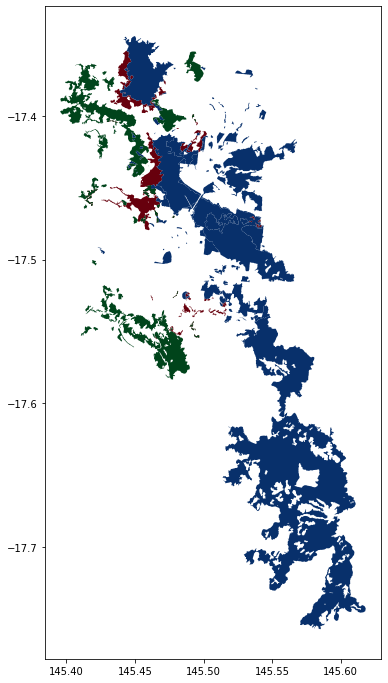

In [6]:
fg = 12
subset2m = eucmg[eucmg.intersects(herberton)]
subset2 = euc[euc.intersects(herberton)]
subset2ne = noneuc[noneuc.intersects(herberton)]
ax = subset2.plot(color='white',figsize=(fg,fg))

cmap_reds=plt.cm.get_cmap('Reds', 2)
cmap_blues=plt.cm.get_cmap('Blues', 2)
cmap_greens=plt.cm.get_cmap('Greens', 2)

subset2x = subset2
subset2x.plot(ax=ax,color=cmap_reds(2),figsize=(fg,fg))
        
subset2x = subset2ne
subset2x.plot(ax=ax,color=cmap_blues(2),figsize=(fg,fg))

subset2x = subset2m
subset2x.plot(ax=ax,color=cmap_greens(2),figsize=(fg,fg))

needed_herberton_polygons = pd.concat([subset2,subset2ne,subset2m])

In [10]:
%run filmstrip

ready...


<Figure size 432x288 with 0 Axes>

In [11]:
rpath = "/Users/brian/code/Eucalyptus_GLMClassifier/herberton/b98622c4-4dbc-408d-8394-4bfbb8d46524/Landsat8L1G/"
stem = "LC08_L1TP_096072_20190905_20190917"
fntag = "herberton"
ls2envi_full(rpath,stem,fntag)

sds = gdal.Open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.tif")
driver = gdal.GetDriverByName('ENVI')
dst = driver.CreateCopy("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil",sds)
dst = None
spy_image_herberton = envi.open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.hdr",
                      image="/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil")

ImageView object:
  Display bands       :  (3, 2, 1)
  Interpolation       :  <default>
  RGB data limits     :
    R: [0.0, 19434.0]
    G: [0.0, 18586.0]
    B: [0.0, 17098.0]

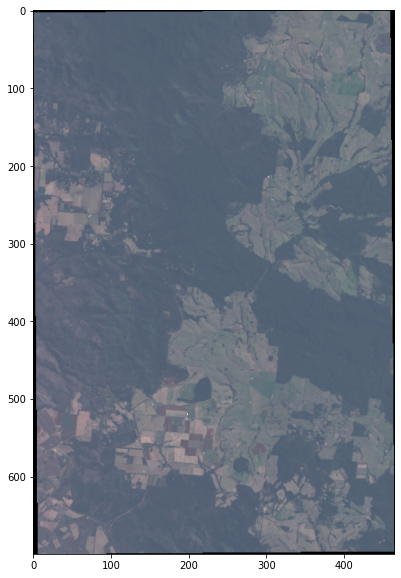

In [12]:
imshow(spy_image_herberton, (3,2,1), figsize=(10,10))

In [13]:
hsf = "/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.tif"
src = rasterio.open(hsf)

#l, b, r, t = warp.transform_bounds(src.crs, dest_crs, src.bounds[0], src.bounds[1], src.bounds[2], src.bounds[3])
l = src.bounds[0]
b = src.bounds[1]
r = src.bounds[2]
t = src.bounds[3]
print("---------lbrt-------------")
print(l,b,r,t)                                  
spoly = Polygon([(l,t),(l,b),(r,b),(r,t),(l,t)])

---------lbrt-------------
331395.0 -1941705.0 345345.0 -1920705.0


In [16]:
src.crs

CRS.from_epsg(32655)

In [18]:
l, b, r, t = warp.transform_bounds(src.crs, 4326, src.bounds[0], src.bounds[1], src.bounds[2], src.bounds[3])

print("---------lbrt-------------")
print(l,b,r,t)                                  
spoly = Polygon([(l,t),(l,b),(r,b),(r,t),(l,t)])

---------lbrt-------------
145.4114238677614 -17.556429013887286 145.5443350146014 -17.36566963332578


In [24]:
spoly
from geopandas import GeoSeries
gp = GeoSeries([spoly])

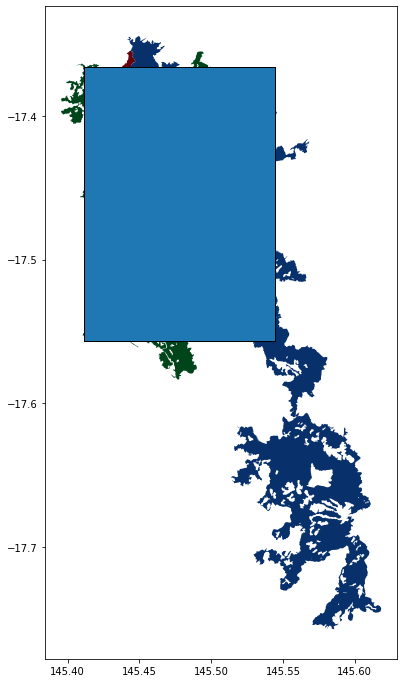

In [27]:
fg = 12
subset2m = eucmg[eucmg.intersects(herberton)]
subset2 = euc[euc.intersects(herberton)]
subset2ne = noneuc[noneuc.intersects(herberton)]
ax = subset2.plot(color='white',figsize=(fg,fg))

cmap_reds=plt.cm.get_cmap('Reds', 2)
cmap_blues=plt.cm.get_cmap('Blues', 2)
cmap_greens=plt.cm.get_cmap('Greens', 2)

subset2x = subset2
subset2x.plot(ax=ax,color=cmap_reds(2),figsize=(fg,fg))
        
subset2x = subset2ne
subset2x.plot(ax=ax,color=cmap_blues(2),figsize=(fg,fg))

subset2x = subset2m
subset2x.plot(ax=ax,color=cmap_greens(2),figsize=(fg,fg))

gp.plot(ax=ax,color=None,edgecolor="black",figsize=(fg,fg))

needed_herberton_polygons = pd.concat([subset2,subset2ne,subset2m])

In [29]:
import pygeos
import geopandas
herberton_clip = geopandas.clip(needed_herberton_polygons, spoly, keep_geom_type=False)

ImportError: Spatial indexes require either `rtree` or `pygeos`. See installation instructions at https://geopandas.org/install.html

In [29]:
noneuc = geopandas.read_file("Non_Eucalyptus_Reg_Ecos_2017/Non_Eucalypt_RE.shp")
euc = geopandas.read_file("Monospecies_Reg_Ecos_2017/FF_SingleSp_RE_2017_V11.shp")
eucmg = geopandas.read_file("Monogenus_Monotribe_Eucalypt_Reg_Ecos_2017/Monotribe_Eucalypt_REs_2017_100pct.shp")
eucmgs = eucmg[['RE', 'Descriptio', 'geometry']].copy()
noneucs = noneuc[['RE', 'Descriptio', 'geometry']].copy()
eucs = euc[['QLD_REG_EC','FF_singl_1','geometry']].copy()
eucs.rename(columns={'QLD_REG_EC': 'RE', 'FF_singl_1': 'Descriptio', 'geometry': 'geometry'}, inplace=True)
eucs['euc'] = 1
eucmgs['euc'] = 1
noneucs['euc'] = 0
merged = eucs.append(eucmgs,sort=False)
fpdf = merged.append(noneucs,sort=False)


In [50]:
subset2mi = fpdf[fpdf.intersects(herberton)]

In [42]:
subset2mic = fpdf[fpdf.contains(herberton)]

In [327]:
len(subset2mi)

333

In [336]:
subset2mi

,RE,Descriptio,geometry,euc
1858,7.12.63,71263,"POLYGON ((145.70709 -18.20720, 145.70680 -18.2...",1
1859,7.12.63,71263,"POLYGON ((145.70223 -18.20073, 145.70238 -18.2...",1
1860,7.12.63,71263,"POLYGON ((145.67549 -18.18329, 145.67537 -18.1...",1
1861,7.12.63,71263,"POLYGON ((145.66473 -18.17576, 145.66473 -18.1...",1
1862,7.12.63,71263,"POLYGON ((145.66651 -18.17559, 145.66639 -18.1...",1
...,...,...,...,...
74487,7.12.50,Simple microphyll vine-fern forest. Highlands ...,"POLYGON ((145.77112 -18.25698, 145.77089 -18.2...",0
74488,7.12.50,Simple microphyll vine-fern forest. Highlands ...,"POLYGON ((145.75803 -18.24717, 145.75817 -18.2...",0
74490,7.12.50,Simple microphyll vine-fern forest. Highlands ...,"POLYGON ((145.78118 -18.23209, 145.78111 -18.2...",0
74495,7.12.50,Simple microphyll vine-fern forest. Highlands ...,"POLYGON ((145.79183 -18.18246, 145.79183 -18.1...",0


In [589]:
def train_and_apply_single(hnon_training_loc,hnon_target_loc,spy_image,fg):
    traint_training_loc_full = spy.create_training_classes(spy_image,hnon_training_loc)
    gmlc1_training_loc_full = GaussianClassifier(traint_training_loc_full)
    clmap1_target_loc_training_loc_full = gmlc1_training_loc_full.classify_image(spy_image)

    gtresults_target_loc_training_loc_full = clmap1_target_loc_training_loc_full * (hnon_target_loc != 0)

    v = imshow(classes=gtresults_target_loc_training_loc_full,figsize=(fg,fg),interpolation='none')
    testing_errors2_target_loc_training_loc_full = gtresults_target_loc_training_loc_full * (gtresults_target_loc_training_loc_full != hnon_target_loc)
    unique, counts = np.unique(testing_errors2_danbulla, return_counts=True)

    imshow(classes=testing_errors2_target_loc_training_loc_full,figsize=(fg,fg),interpolation='none')

    classification_metrics(hnon_target_loc,gtresults_target_loc_training_loc_full)

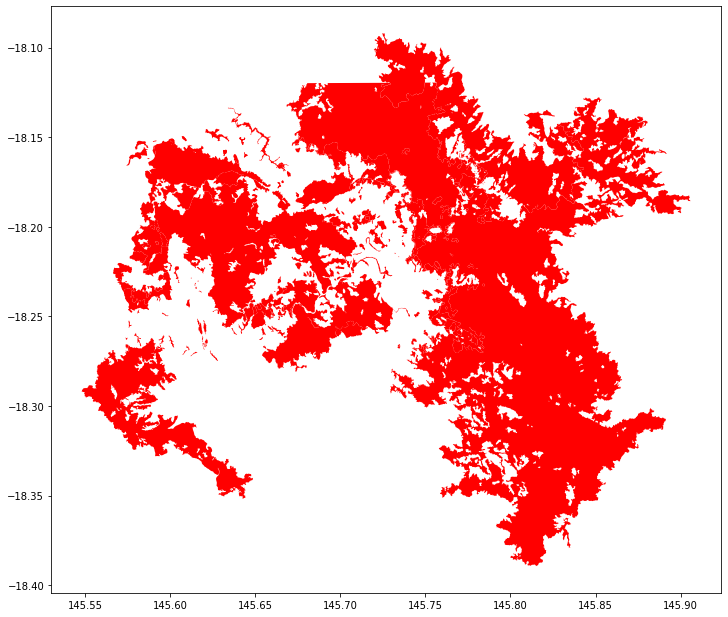

In [328]:
subset2mi.plot(color='red',figsize=(fg,fg))

In [591]:
#ax = subset2mi.plot(color='red',figsize=(fg,fg))
d = { 'geometry': []}
gdf = GeoDataFrame(d,crs="EPSG:4326")
#gdf = GeoDataFrame(crs="4326")

glat = []
glon = []
geuc = []

for x in subset2mi.euc:
    #print(x.representative_point())
    geuc.append(x)

for x in subset2mi.geometry:
    p = x.representative_point()
    glat.append(p.y)
    glon.append(p.x)

 
gdf = geopandas.GeoDataFrame(gdf, geometry=geopandas.points_from_xy(glon, glat))

gdf['euc'] = geuc


pgeom = []
for i,x in gdf.iterrows():
    p = Point(x[0])
    pp = x.geometry.buffer(0.002)
    pgeom.append(pp)
    x.geometry = pp
    
    
gdf['geometry'] = pgeom    
   

,geometry,euc
0,"POLYGON ((145.70839 -18.20641, 145.70838 -18.2...",1
1,"POLYGON ((145.70491 -18.20241, 145.70490 -18.2...",1
2,"POLYGON ((145.67705 -18.18221, 145.67704 -18.1...",1
3,"POLYGON ((145.66660 -18.17684, 145.66659 -18.1...",1
4,"POLYGON ((145.66813 -18.17500, 145.66812 -18.1...",1
...,...,...
328,"POLYGON ((145.77522 -18.26076, 145.77522 -18.2...",0
329,"POLYGON ((145.76447 -18.24230, 145.76446 -18.2...",0
330,"POLYGON ((145.77856 -18.23355, 145.77855 -18.2...",0
331,"POLYGON ((145.79328 -18.18981, 145.79327 -18.1...",0


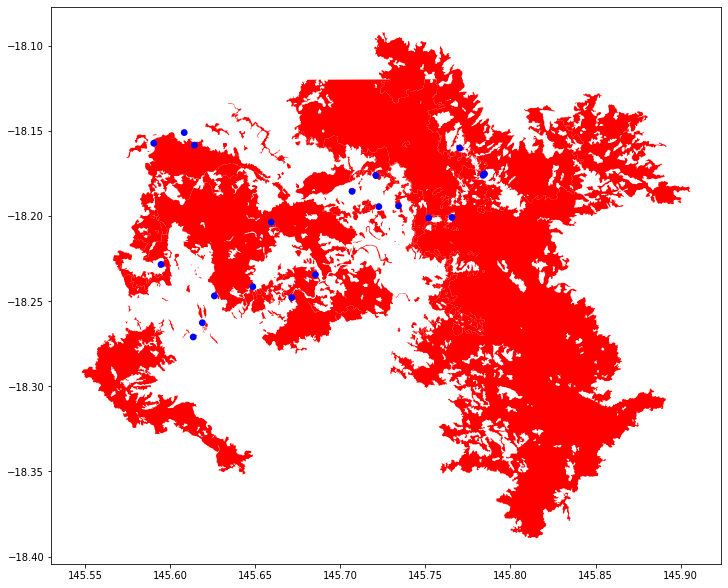

In [597]:
ax = subset2mi.plot(color='red',figsize=(fg,fg))
#udfw = gdf..sample(n=3)
udfw = gdf[gdf.intersects(kirrama)]
udfws = udfw.sample(n=20)
udfws.plot(ax=ax,color="blue",figsize=(fg,fg))

In [598]:
udfws

,geometry,euc
111,"POLYGON ((145.68746 -18.23439, 145.68745 -18.2...",1
313,"POLYGON ((145.67360 -18.24788, 145.67359 -18.2...",0
287,"POLYGON ((145.78678 -18.17517, 145.78677 -18.1...",0
67,"POLYGON ((145.76769 -18.20077, 145.76768 -18.2...",1
286,"POLYGON ((145.78589 -18.17603, 145.78588 -18.1...",0
105,"POLYGON ((145.59246 -18.15717, 145.59245 -18.1...",1
172,"POLYGON ((145.62100 -18.26264, 145.62099 -18.2...",0
266,"POLYGON ((145.72468 -18.19442, 145.72467 -18.1...",0
15,"POLYGON ((145.73625 -18.19398, 145.73624 -18.1...",1
132,"POLYGON ((145.59675 -18.22839, 145.59674 -18.2...",1


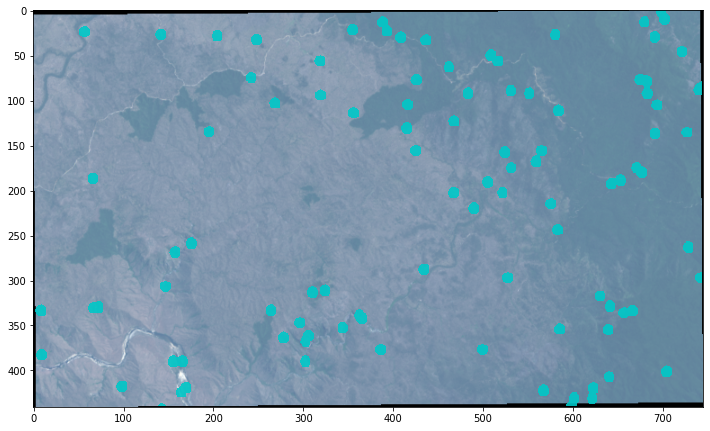

In [599]:
view = imshow(spy_image_kirrama, (3, 2, 1), classes=hnon_kirrama_sample,figsize=(fg,fg))
view.set_display_mode('overlay')
view.class_alpha = 0.9

ready...
------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
349185.0 -2020665.0 371535.0 -2007435.0
---------spoly-------------
POLYGON ((349185 -2007435, 349185 -2020665, 371535 -2020665, 371535 -2007435, 349185 -2007435))
image pixel dimensions:
(441, 745, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (349185.0, -2020665.0, 371535.0, -2007435.0)
chd:13230.0 cwd:22350.0
poly number: 1
0
dfn: 20
0
hits number: 20
done.


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.2841219820794483

Balanced Accuracy:
0.6331176798731821


               precision    recall  f1-score   support

   Eucalyptus      0.672     0.872     0.759    104779
NonEucalyptus      0.684     0.394     0.500     73610

     accuracy                          0.675    178389
    macro avg      0.678     0.633     0.630    178389
 weighted avg      0.677     0.675     0.652    178389



<Figure size 432x288 with 0 Axes>

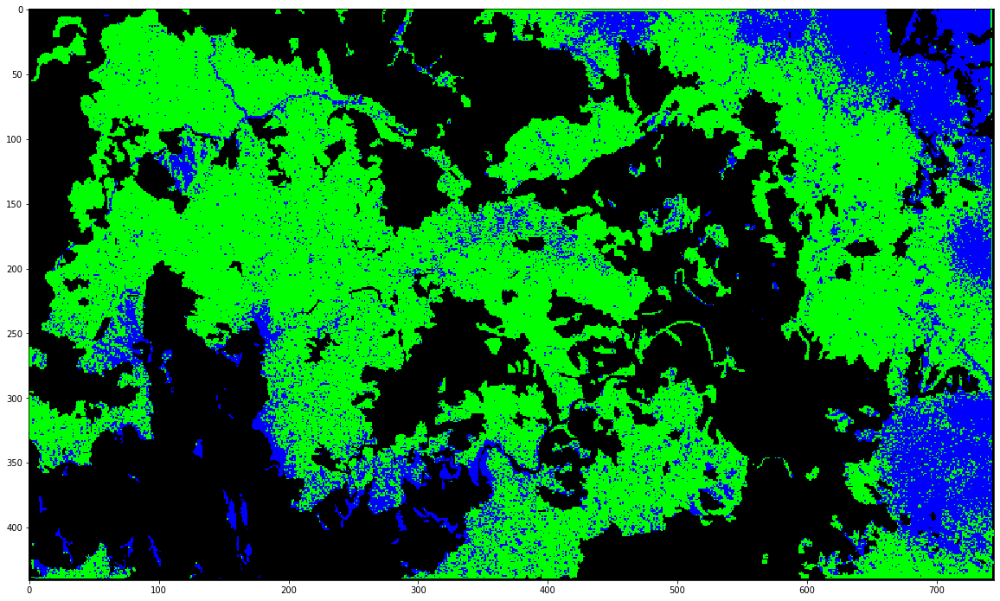

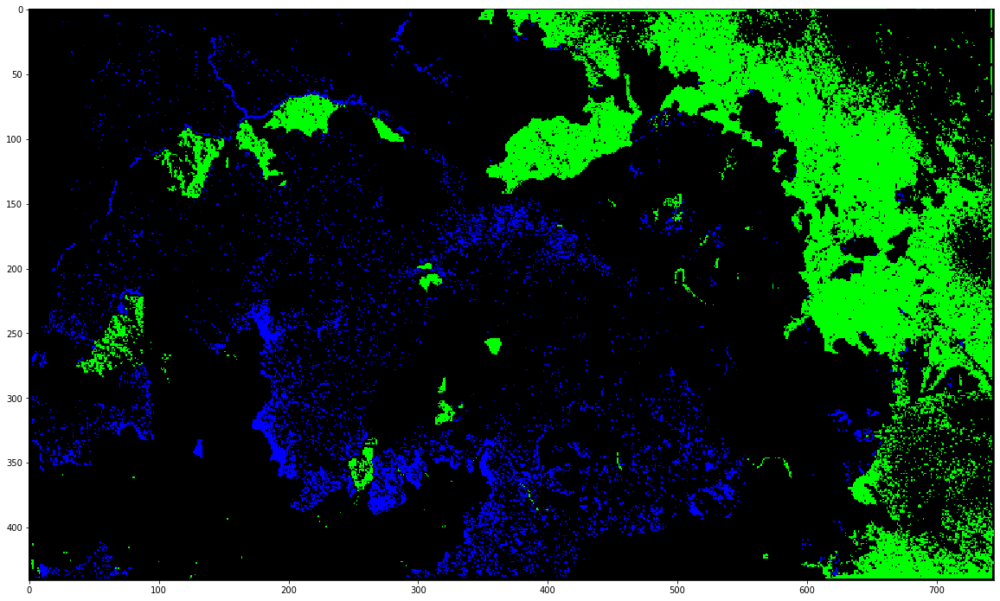

In [600]:
%run create_training_polygons
hsf_kirrama = "/Users/brian/code/Eucalyptus_GLMClassifier/kirrama_reflectance_full.tif"
#hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
hnon_kirrama_sample = xkpls_m(hsf_kirrama,spy_image_kirrama,8,udfws,4326,4283,32655,0,441,0,745,zgz)

train_and_apply_single(hnon_kirrama_sample,hnon_kirrama,spy_image_kirrama,20)

In [813]:
%run create_training_polygons

def train_and_apply_singlex(hnon_training_loc,hnon_target_loc,spy_image,fg):
    traint_training_loc_full = spy.create_training_classes(spy_image,hnon_training_loc)
    #counts = np.unique(traint_training_loc_full,return_counts=True)
    print(traint_training_loc_full.__dir__())
    print(traint_training_loc_full.classes)
    
    gmlc1_training_loc_full = GaussianClassifier(traint_training_loc_full)
    clmap1_target_loc_training_loc_full = gmlc1_training_loc_full.classify_image(spy_image)

    gtresults_target_loc_training_loc_full = clmap1_target_loc_training_loc_full * (hnon_target_loc != 0)

    v = imshow(classes=gtresults_target_loc_training_loc_full,figsize=(fg,fg),interpolation='none')
    testing_errors2_target_loc_training_loc_full = gtresults_target_loc_training_loc_full * (gtresults_target_loc_training_loc_full != hnon_target_loc)
    unique, counts = np.unique(testing_errors2_danbulla, return_counts=True)

    imshow(classes=testing_errors2_target_loc_training_loc_full,figsize=(fg,fg),interpolation='none')

    classification_metrics(hnon_target_loc,gtresults_target_loc_training_loc_full)
    
    
def train_and_apply_single_quiet(hnon_training_loc,hnon_target_loc,spy_image,fg):
    traint_training_loc_full = spy.create_training_classes(spy_image,hnon_training_loc)
    #return(traint_training_loc_full)
    print(type(traint_training_loc_full))
    #unique, counts = np.unique(traint_training_loc_full, return_counts=True)
    #print(type(traint_training_loc_full))
    #print("unique counts:",unique,counts)
        
    gmlc1_training_loc_full = GaussianClassifier(traint_training_loc_full)
    clmap1_target_loc_training_loc_full = gmlc1_training_loc_full.classify_image(spy_image)

    gtresults_target_loc_training_loc_full = clmap1_target_loc_training_loc_full * (hnon_target_loc != 0)
    
    testing_errors2_target_loc_training_loc_full = gtresults_target_loc_training_loc_full * (gtresults_target_loc_training_loc_full != hnon_target_loc)
    unique, counts = np.unique(testing_errors2_danbulla, return_counts=True)
    

    classification_metrics(hnon_target_loc,gtresults_target_loc_training_loc_full)
    
    
def patch_sample(locpoly,locname,spy_image,hnon_loc,patchsize,count,fpdf,zgz,fdim,sdim,lcs):
    subset2mi = fpdf[fpdf.intersects(locpoly)]

    d = { 'geometry': []}
    gdf = GeoDataFrame(d,crs="EPSG:4326")
    #gdf = GeoDataFrame(crs="4326")

    glat = []
    glon = []
    geuc = []

    for x in subset2mi.euc:
        #print(x.representative_point())
        geuc.append(x)

    for x in subset2mi.geometry:
        p = x.representative_point()
        glat.append(p.y)
        glon.append(p.x)


    gdf = geopandas.GeoDataFrame(gdf, geometry=geopandas.points_from_xy(glon, glat))

    gdf['euc'] = geuc

    pgeom = []
    for i,x in gdf.iterrows():
        p = Point(x[0])
        pp = x.geometry.buffer(patchsize)
        pgeom.append(pp)
        x.geometry = pp


    gdf['geometry'] = pgeom 

    ax = subset2mi.plot(color='red',figsize=(fg,fg))
    #udfw = gdf..sample(n=3)
    udfw = gdf[gdf.intersects(locpoly)]
    #udfws = udfw.sample(n=count)
    
    udfws_euc = udfw[udfw.euc == 1].sample(n=20,replace=True)
    print(udfws_euc)
    udfws_noneuc = udfw[udfw.euc == 0].sample(n=20,replace=True)
    udfws = pd.concat([udfws_euc,udfws_noneuc])
    
    
    udfws.plot(ax=ax,color="blue",figsize=(fg,fg))
    hsf_loc = "/Users/brian/code/Eucalyptus_GLMClassifier/"+locname+"_reflectance_full.tif"
    #hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
    hnon_loc_sample = xkpls_m(hsf_loc,spy_image,8,udfws,4326,4283,lcs,0,fdim,0,sdim,zgz)
    
    view = imshow(spy_image, (3, 2, 1), classes=hnon_loc_sample,figsize=(fg,fg))
    view.set_display_mode('overlay')
    view.class_alpha = 0.9
    print(udfws)

    train_and_apply_singlex(hnon_loc_sample,hnon_loc,spy_image,12)

    
    
def patch_sample_quiet(locpoly,locname,spy_image,hnon_loc,patchsize,count,fpdf,zgz,fdim,sdim,lcs):
    subset2mi = fpdf[fpdf.intersects(locpoly)]

    d = { 'geometry': []}
    gdf = GeoDataFrame(d,crs="EPSG:4326")
    #gdf = GeoDataFrame(crs="4326")

    glat = []
    glon = []
    geuc = []

    for x in subset2mi.euc:
        #print(x.representative_point())
        geuc.append(x)

    for x in subset2mi.geometry:
        p = x.representative_point()
        glat.append(p.y)
        glon.append(p.x)


    gdf = geopandas.GeoDataFrame(gdf, geometry=geopandas.points_from_xy(glon, glat))

    gdf['euc'] = geuc

    pgeom = []
    for i,x in gdf.iterrows():
        p = Point(x[0])
        pp = x.geometry.buffer(patchsize)
        pgeom.append(pp)
        x.geometry = pp


    gdf['geometry'] = pgeom 

    ax = subset2mi.plot(color='red',figsize=(fg,fg))
    #udfw = gdf..sample(n=3)
    udfw = gdf[gdf.intersects(locpoly)]
    #udfws = udfw.sample(n=count)
    udfws_euc = udfw[udfw.euc == 1].sample(n=20,replace=True)
    udfws_noneuc = udfw[udfw.euc == 0].sample(n=20,replace=True)
    udfws = pd.concat([udfws_euc,udfws_noneuc])
    
    
    udfws.plot(ax=ax,color="blue",figsize=(fg,fg))
    hsf_loc = "/Users/brian/code/Eucalyptus_GLMClassifier/"+locname+"_reflectance_full.tif"
    #hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
    hnon_loc_sample = xkpls_m(hsf_loc,spy_image,8,udfws,4326,4283,lcs,0,fdim,0,sdim,zgz)
    
    #view = imshow(spy_image, (3, 2, 1), classes=hnon_loc_sample,figsize=(fg,fg))
    #view.set_display_mode('overlay')
    
    #view.class_alpha = 0.9
    #print(udfws)

    train_and_apply_single_quiet(hnon_loc_sample,hnon_loc,spy_image,12)
    


ready...


<Figure size 432x288 with 0 Axes>

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
479265.0 -2427315.0 520725.0 -2383005.0
---------spoly-------------
POLYGON ((479265 -2383005, 479265 -2427315, 520725 -2427315, 520725 -2383005, 479265 -2383005))
image pixel dimensions:
(1477, 1382, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (479265.0, -2427315.0, 520725.0, -2383005.0)
chd:44310.0 cwd:41460.0
poly number: 1
0
dfn: 30
0
hits number: 30
done.
(array([0., 2., 3.]), array([1972805,   33536,   34873]))


spectral:INFO: Setting min samples to 12


<class 'spectral.algorithms.algorithms.TrainingClassSet'>
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.0%

LinAlgError: Singular matrix

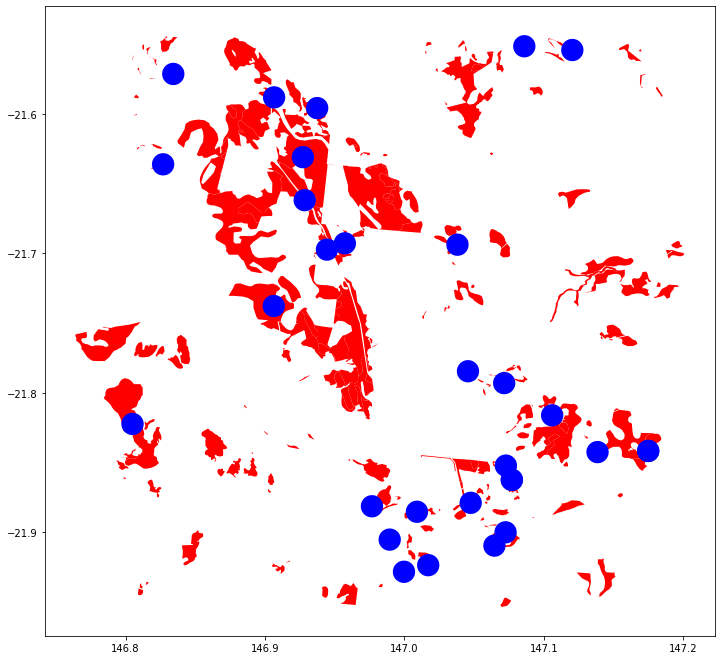

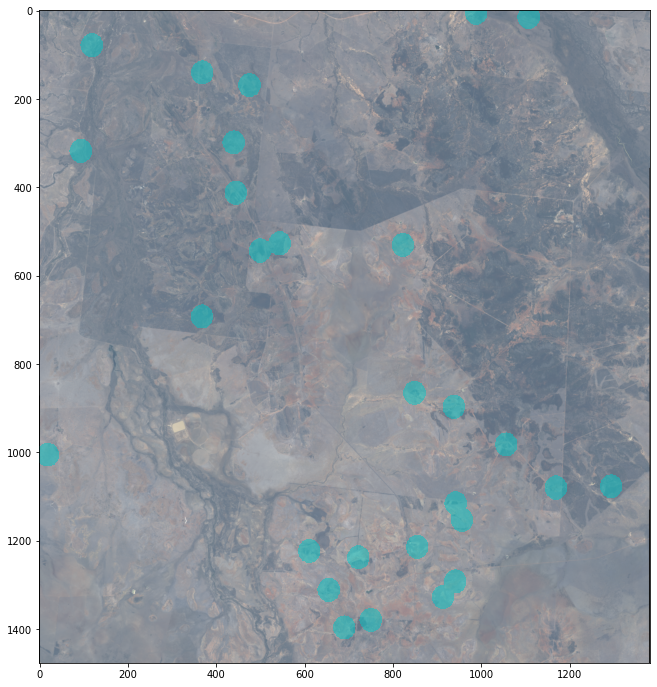

In [814]:

    locname = "belyando"
    spy_image = spy_image_belyando 
    lcs = 32655
    hnon_belyando = np.loadtxt("hnon_belyando.txt",delimiter=",")
    loc_poly = hnon_belyando
    
    subset2mi = fpdf[fpdf.intersects(belyando)]

    d = { 'geometry': []}
    gdf = GeoDataFrame(d,crs="EPSG:4326")
    #gdf = GeoDataFrame(crs="4326")

    glat = []
    glon = []
    geuc = []

    for x in subset2mi.euc:
        #print(x.representative_point())
        geuc.append(x)
        #geuc.append(x)

    for x in subset2mi.geometry:
        p = x.representative_point()
        glat.append(p.y)
        glon.append(p.x)
        #glat.append(p.y+0.001)
        #glon.append(p.x+0.001)



    gdf = geopandas.GeoDataFrame(gdf, geometry=geopandas.points_from_xy(glon, glat))

    gdf['euc'] = geuc

    patchsize = 0.008
    pgeom = []
    for i,x in gdf.iterrows():
        p = Point(x[0])
        pp = x.geometry.buffer(patchsize)
        pgeom.append(pp)
        x.geometry = pp


    gdf['geometry'] = pgeom 

    ax = subset2mi.plot(color='red',figsize=(fg,fg))
    #udfw = gdf..sample(n=3)
    udfw = gdf[gdf.intersects(belyando)]
    #udfws = udfw.sample(n=count)
    udfws_euc = udfw[udfw.euc == 1].sample(n=15,replace=True)
    udfws_noneuc = udfw[udfw.euc == 0].sample(n=15,replace=True)
    udfws = pd.concat([udfws_euc,udfws_noneuc])
    
    fdim = 1477
    sdim = 1382
    
    
    udfws.plot(ax=ax,color="blue",figsize=(fg,fg))
    hsf_loc = "/Users/brian/code/Eucalyptus_GLMClassifier/"+locname+"_reflectance_full.tif"
    #hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
    hnon_loc_sample = xkpls_m(hsf_loc,spy_image,8,udfws,4326,4283,lcs,0,fdim,0,sdim,zgz)
    print(np.unique(hnon_loc_sample,return_counts=True))
    view = imshow(spy_image, (3, 2, 1), classes=hnon_loc_sample,figsize=(fg,fg))
    view.set_display_mode('overlay')
    
    #view.class_alpha = 0.9
    #print(udfws)

    traint_training_loc_full = spy.create_training_classes(spy_image,hnon_loc_sample)
    #return(traint_training_loc_full)
    print(type(traint_training_loc_full))
    #unique, counts = np.unique(traint_training_loc_full, return_counts=True)
    #print(type(traint_training_loc_full))
    #print("unique counts:",unique,counts)
        
    gmlc1_training_loc_full = GaussianClassifier(traint_training_loc_full)
    
    clmap1_target_loc_training_loc_full = gmlc1_training_loc_full.classify_image(spy_image)

    gtresults_target_loc_training_loc_full = clmap1_target_loc_training_loc_full * (hnon_belyando != 0)
    
    testing_errors2_target_loc_training_loc_full = gtresults_target_loc_training_loc_full * (gtresults_target_loc_training_loc_full != hnon_target_loc)
    unique, counts = np.unique(testing_errors2_target_loc_training_loc_full, return_counts=True)
    

    classification_metrics(hnon_target_loc,gtresults_target_loc_training_loc_full)
    
   

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
479265.0 -2427315.0 520725.0 -2383005.0
---------spoly-------------
POLYGON ((479265 -2383005, 479265 -2427315, 520725 -2427315, 520725 -2383005, 479265 -2383005))
image pixel dimensions:
(1477, 1382, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (479265.0, -2427315.0, 520725.0, -2383005.0)
chd:44310.0 cwd:41460.0
poly number: 1
0
dfn: 30
0
hits number: 30
done.
(array([0., 2., 3.]), array([1976375,   34559,   30280]))


spectral:INFO: Setting min samples to 12


<class 'spectral.algorithms.algorithms.TrainingClassSet'>
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.0%

LinAlgError: Singular matrix

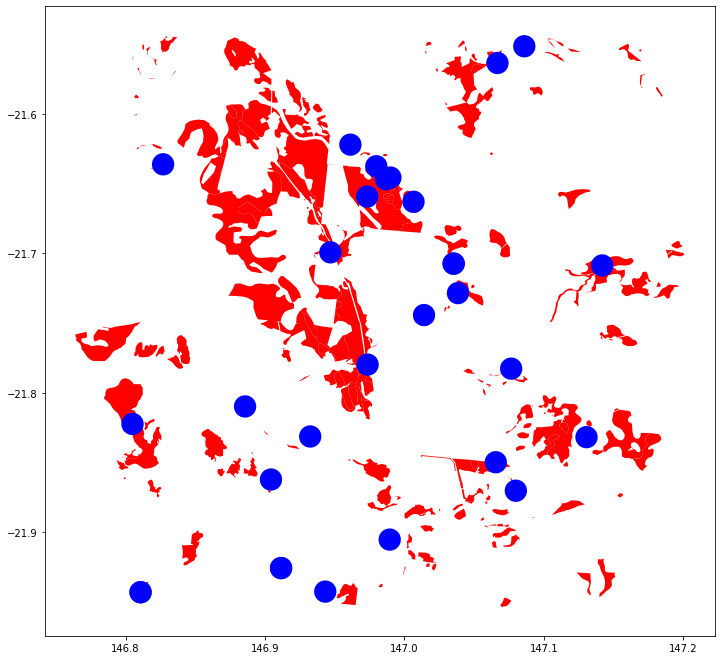

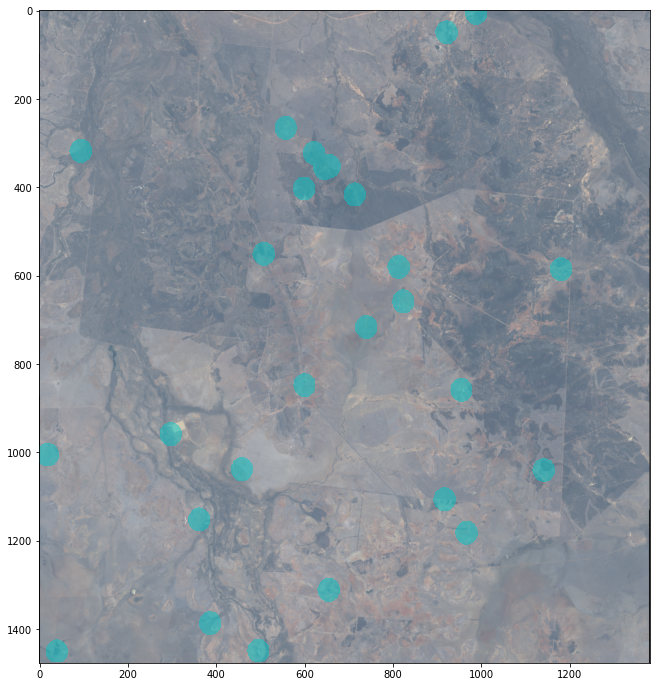

In [771]:

    locname = "belyando"
    spy_image = spy_image_belyando 
    lcs = 32655
    hnon_belyando = np.loadtxt("hnon_belyando.txt",delimiter=",")
    loc_poly = hnon_belyando
    
    subset2mi = fpdf[fpdf.intersects(belyando)]

    d = { 'geometry': []}
    gdf = GeoDataFrame(d,crs="EPSG:4326")
    #gdf = GeoDataFrame(crs="4326")

    glat = []
    glon = []
    geuc = []

    for x in subset2mi.euc:
        #print(x.representative_point())
        geuc.append(x)
        #geuc.append(x)

    for x in subset2mi.geometry:
        p = x.representative_point()
        glat.append(p.y)
        glon.append(p.x)
        #glat.append(p.y+0.001)
        #glon.append(p.x+0.001)



    gdf = geopandas.GeoDataFrame(gdf, geometry=geopandas.points_from_xy(glon, glat))

    gdf['euc'] = geuc

    patchsize = 0.008
    pgeom = []
    for i,x in gdf.iterrows():
        p = Point(x[0])
        pp = x.geometry.buffer(patchsize)
        pgeom.append(pp)
        x.geometry = pp


    gdf['geometry'] = pgeom 

    ax = subset2mi.plot(color='red',figsize=(fg,fg))
    #udfw = gdf..sample(n=3)
    udfw = gdf[gdf.intersects(belyando)]
    #udfws = udfw.sample(n=count)
    udfws_euc = udfw[udfw.euc == 1].sample(n=15,replace=True)
    udfws_noneuc = udfw[udfw.euc == 0].sample(n=15,replace=True)
    udfws = pd.concat([udfws_euc,udfws_noneuc])
    
    fdim = 1477
    sdim = 1382
    
    
    udfws.plot(ax=ax,color="blue",figsize=(fg,fg))
    hsf_loc = "/Users/brian/code/Eucalyptus_GLMClassifier/"+locname+"_reflectance_full.tif"
    #hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
    hnon_loc_sample = xkpls_m(hsf_loc,spy_image,8,udfws,4326,4283,lcs,0,fdim,0,sdim,zgz)
    print(np.unique(hnon_loc_sample,return_counts=True))
    view = imshow(spy_image, (3, 2, 1), classes=hnon_loc_sample,figsize=(fg,fg))
    view.set_display_mode('overlay')
    
    #view.class_alpha = 0.9
    #print(udfws)

    traint_training_loc_full = spy.create_training_classes(spy_image,hnon_loc_sample)
    #return(traint_training_loc_full)
    print(type(traint_training_loc_full))
    #unique, counts = np.unique(traint_training_loc_full, return_counts=True)
    #print(type(traint_training_loc_full))
    #print("unique counts:",unique,counts)
        
    gmlc1_training_loc_full = GaussianClassifier(traint_training_loc_full)
    
    clmap1_target_loc_training_loc_full = gmlc1_training_loc_full.classify_image(spy_image)

    gtresults_target_loc_training_loc_full = clmap1_target_loc_training_loc_full * (hnon_belyando != 0)
    
    testing_errors2_target_loc_training_loc_full = gtresults_target_loc_training_loc_full * (gtresults_target_loc_training_loc_full != hnon_target_loc)
    unique, counts = np.unique(testing_errors2_target_loc_training_loc_full, return_counts=True)
    

    classification_metrics(hnon_target_loc,gtresults_target_loc_training_loc_full)
    

In [786]:
gmlc1_training_loc_full.classes[1].stats.mean

array([11166.08781374, 10651.42717966, 10638.85056143, 11811.37414135,
       15294.6324967 , 18634.52698151, 15286.52678336, 11004.57249009,
        5055.56661162, 34504.31588507, 30334.21902246,  2720.        ])

In [824]:
x = spy_image_belyando[102,112,]

scores = np.empty(len(gmlc1_training_loc_full.classes))
for (i, cl) in enumerate(gmlc1_training_loc_full.classes):
    print(cl.stats.__dir__())
    print(cl.stats.nsamples)
    #print(cl.stats[1][1])
    
    print(cl.stats.log_det_cov)
    print(i)
    print(cl)
    print(cl.stats.mean)
    print("cl.stats")
    print(cl.stats)
    print("cl.stats.inv_cov")
    print(cl.stats.cov)
    cl.stats.inv_cov
    delta = (x - cl.stats.mean)
    print("delta")
    print(delta)
    delta.dot(cl.stats.inv_cov).dot(delta)
    scores[i] = math.log(cl.class_prob) - 0.5 * cl.stats.log_det_cov \
               - 0.5 * delta.dot(cl.stats.inv_cov).dot(delta)

['_cov', '_inv_cov', '_sqrt_cov', '_sqrt_inv_cov', '_pcs', '_log_det_cov', 'mean', 'nsamples', '__module__', '__doc__', '__init__', 'cov', 'inv_cov', 'reset_derived_stats', 'sqrt_cov', 'sqrt_inv_cov', 'principal_components', 'log_det_cov', 'transform', 'get_whitening_transform', '__dict__', '__weakref__', '__repr__', '__hash__', '__str__', '__getattribute__', '__setattr__', '__delattr__', '__lt__', '__le__', '__eq__', '__ne__', '__gt__', '__ge__', '__new__', '__reduce_ex__', '__reduce__', '__subclasshook__', '__init_subclass__', '__format__', '__sizeof__', '__dir__', '__class__']
33536
126.68871360290265
0
[11177.37335997 10652.79383349 10726.46457538 12138.29574189
 15965.50351861 20497.65288049 16657.84705988 11169.43699308
  5046.39223521 34329.39960043 30191.31819537  2713.02480916]
cl.stats
cl.stats.inv_cov
[[ 506890.82308513  543836.13020458  656993.40578654  853100.30144675
   906934.70664808 1392155.33124447 1296478.72804425  715102.67002862
   146394.5504942  1117697.00845694 

LinAlgError: Singular matrix

In [788]:
delta

array([ -694.08781374,  -980.42717966, -1648.85056143, -2823.37414135,
        -835.6324967 , -4788.52698151, -5089.52678336, -1925.57249009,
          12.43338838, -2031.31588507, -1269.21902246,     0.        ])

In [758]:
print(type(gmlc1_training_loc_full))
gmlc1_training_loc_full.__dir__()

<class 'spectral.algorithms.classifiers.GaussianClassifier'>


['min_samples',
 '__module__',
 '__doc__',
 '__init__',
 'train',
 'classify_spectrum',
 'classify_image',
 'cache_class_scores',
 'classify',
 '__dict__',
 '__weakref__',
 '__repr__',
 '__hash__',
 '__str__',
 '__getattribute__',
 '__setattr__',
 '__delattr__',
 '__lt__',
 '__le__',
 '__eq__',
 '__ne__',
 '__gt__',
 '__ge__',
 '__new__',
 '__reduce_ex__',
 '__reduce__',
 '__subclasshook__',
 '__init_subclass__',
 '__format__',
 '__sizeof__',
 '__dir__',
 '__class__']

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 40
0
hits number: 40
done.


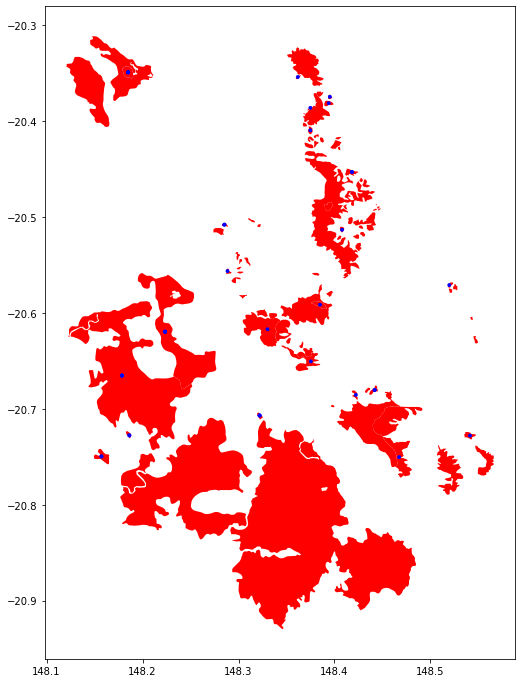

In [738]:
tt = patch_sample_quiet(andromache,"andromache",spy_image_andromache,hnon_andromache,0.002,c,fpdf,zgz,1488,1404,32655)

In [739]:
type(tt)

spectral.algorithms.algorithms.TrainingClassSet

In [740]:
tt.__dir__()

['classes',
 'nbands',
 '__module__',
 '__doc__',
 '__init__',
 '__getitem__',
 '__len__',
 'add_class',
 'transform',
 '__iter__',
 'all_samples',
 'calc_stats',
 'save',
 'load',
 '__dict__',
 '__weakref__',
 '__repr__',
 '__hash__',
 '__str__',
 '__getattribute__',
 '__setattr__',
 '__delattr__',
 '__lt__',
 '__le__',
 '__eq__',
 '__ne__',
 '__gt__',
 '__ge__',
 '__new__',
 '__reduce_ex__',
 '__reduce__',
 '__subclasshook__',
 '__init_subclass__',
 '__format__',
 '__sizeof__',
 '__dir__',
 '__class__']

In [744]:
tt.all_samples()

                                            geometry  euc
8  POLYGON ((148.18058 -20.66537, 148.18057 -20.6...    1
2  POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
9  POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
2  POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
9  POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
2  POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
9  POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
3  POLYGON ((148.18827 -20.72768, 148.18826 -20.7...    1
9  POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
7  POLYGON ((148.32397 -20.70695, 148.32396 -20.7...    1
9  POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
9  POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
2  POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
2  POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
7  POLYGON ((148.32397 -20.70695, 148.32396 -20.7...    1
3  POLYGON ((148.18827 -20.72768, 148.18826 -20.7...    1
2  POLYGON ((1

/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 40
0
hits number: 40
done.


spectral:INFO: Setting min samples to 12


                                             geometry  euc
8   POLYGON ((148.18058 -20.66537, 148.18057 -20.6...    1
2   POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
9   POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
2   POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
9   POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
2   POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
9   POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
3   POLYGON ((148.18827 -20.72768, 148.18826 -20.7...    1
9   POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
7   POLYGON ((148.32397 -20.70695, 148.32396 -20.7...    1
9   POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
9   POLYGON ((148.18700 -20.34936, 148.18699 -20.3...    1
2   POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
2   POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
7   POLYGON ((148.32397 -20.70695, 148.32396 -20.7...    1
3   POLYGON ((148.18827 -20.72768, 148.18826 -20.7...   

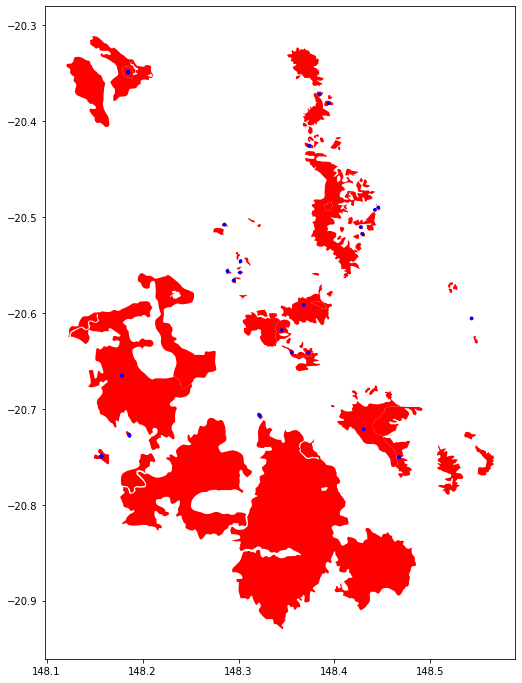

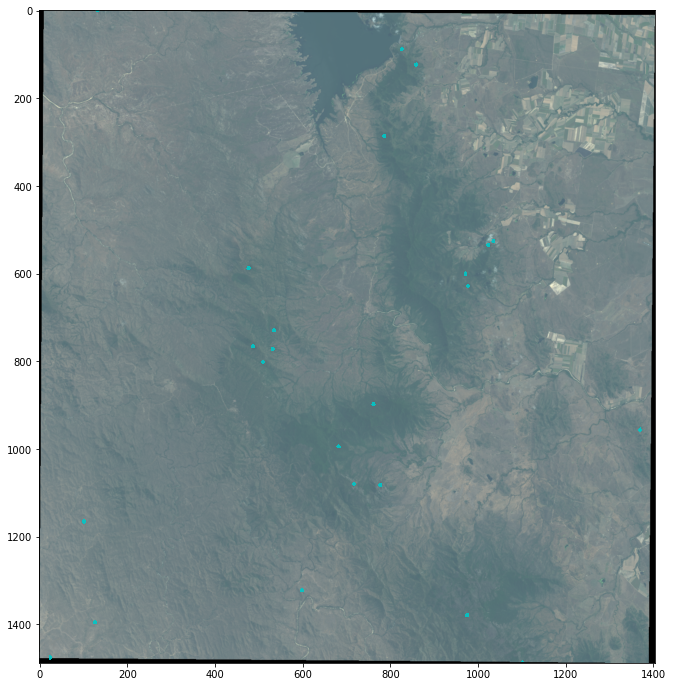

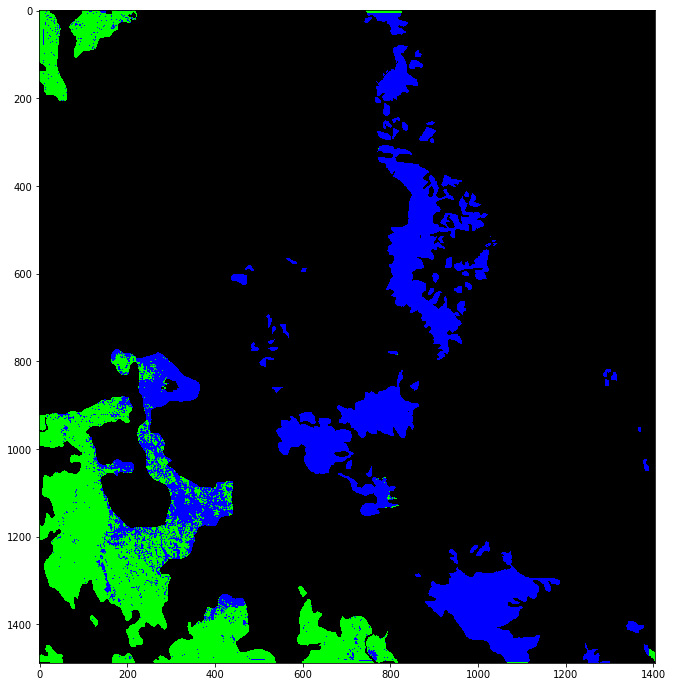

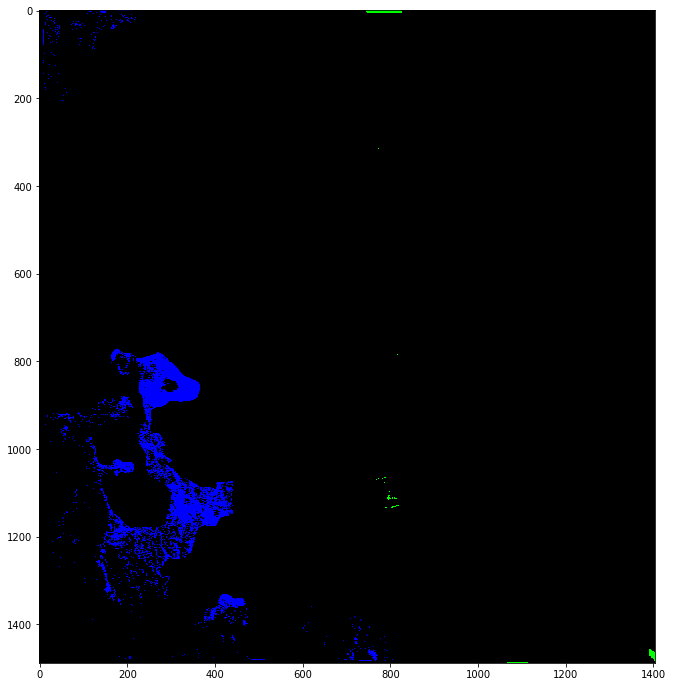

In [705]:
# 7.16 3
patch_sample(andromache,"andromache",spy_image_andromache,hnon_andromache,0.002,40,fpdf,zgz,1488,1404,32655)

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 40
0
hits number: 40
done.


spectral:INFO: Setting min samples to 12


                                             geometry  euc
87  POLYGON ((148.39578 -20.48942, 148.39577 -20.4...    0
23  POLYGON ((148.38304 -20.55990, 148.38303 -20.5...    0
33  POLYGON ((148.44759 -20.49026, 148.44758 -20.4...    0
15  POLYGON ((148.44382 -20.68045, 148.44381 -20.6...    0
7   POLYGON ((148.32397 -20.70695, 148.32396 -20.7...    1
29  POLYGON ((148.41880 -20.50404, 148.41879 -20.5...    0
24  POLYGON ((148.40688 -20.52203, 148.40687 -20.5...    0
84  POLYGON ((148.39285 -20.49743, 148.39284 -20.4...    0
2   POLYGON ((148.15917 -20.74961, 148.15916 -20.7...    1
38  POLYGON ((148.42021 -20.45319, 148.42020 -20.4...    0
77  POLYGON ((148.45540 -20.71304, 148.45539 -20.7...    0
20  POLYGON ((148.52314 -20.57697, 148.52313 -20.5...    0
57  POLYGON ((148.34720 -20.61800, 148.34719 -20.6...    0
66  POLYGON ((148.30411 -20.54644, 148.30410 -20.5...    0
47  POLYGON ((148.37684 -20.40980, 148.37683 -20.4...    0
45  POLYGON ((148.37826 -20.41893, 148.37825 -20.4...   

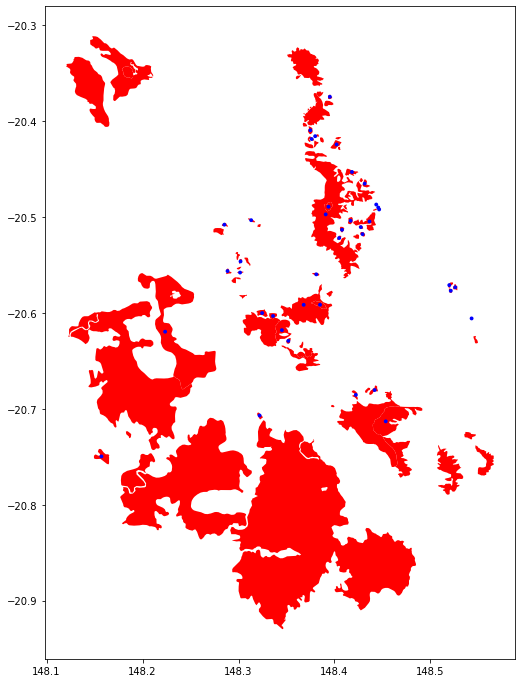

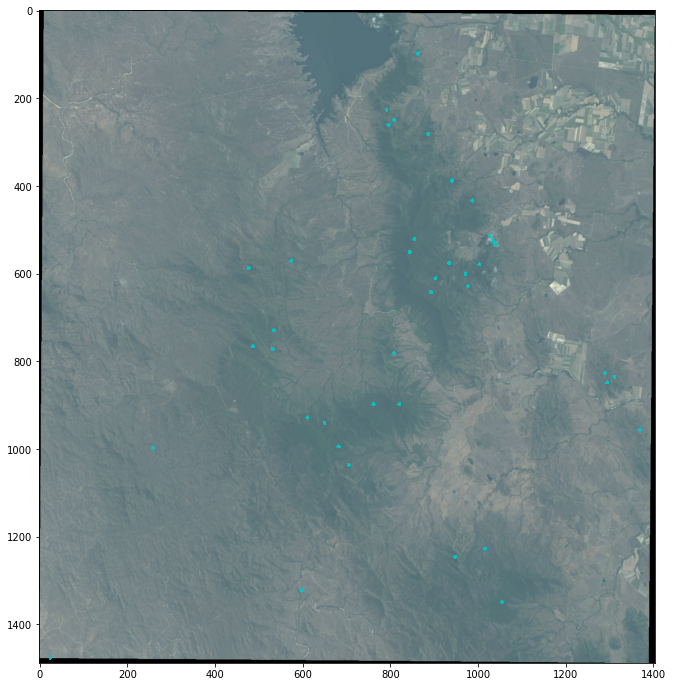

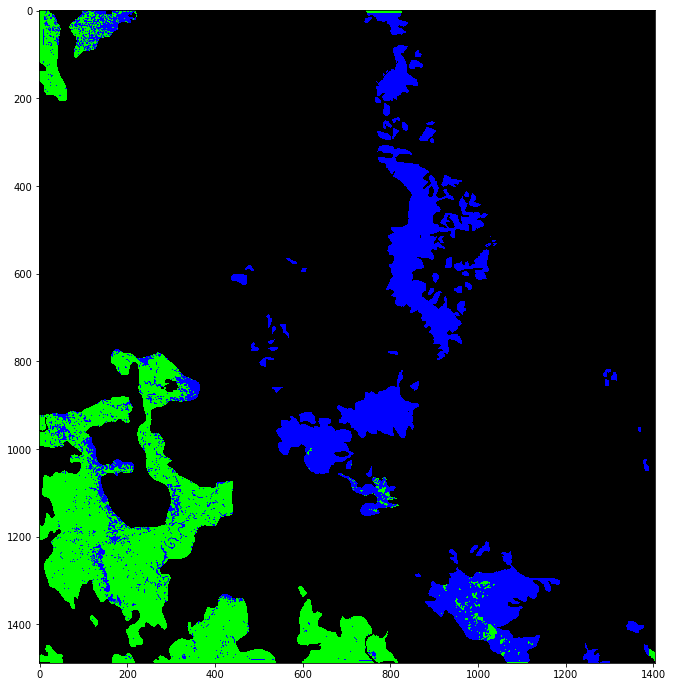

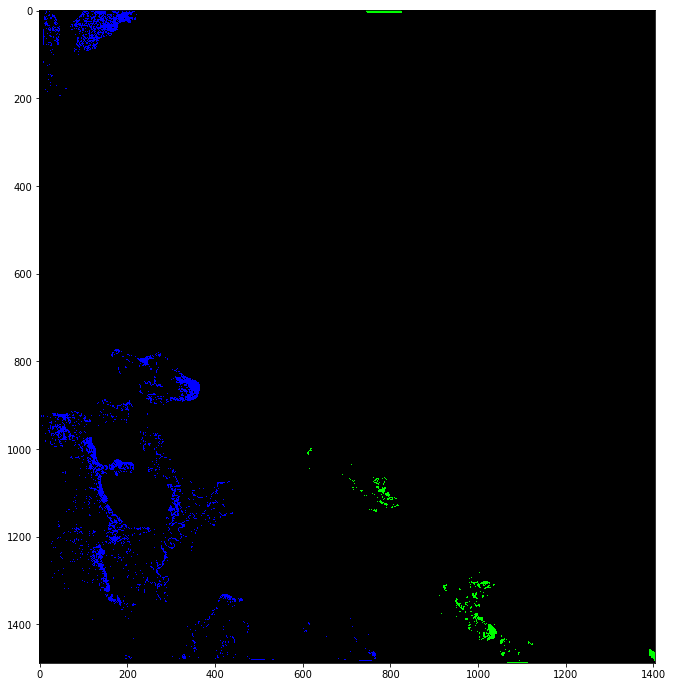

In [661]:
patch_sample(andromache,"andromache",spy_image_andromache,hnon_andromache,0.002,40,fpdf,zgz,1488,1404,32655)

In [689]:
hnon_andro = np.loadtxt("hnon_andromache.txt",delimiter=',')

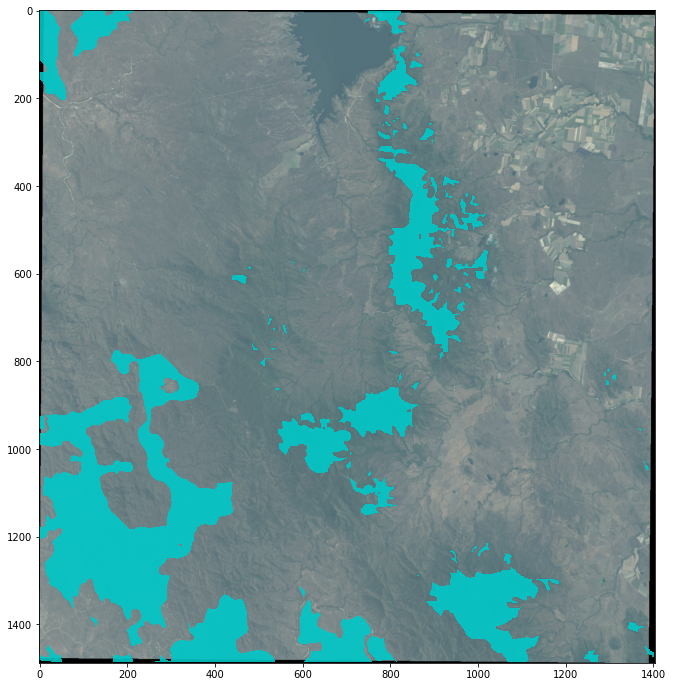

In [691]:
view = imshow(spy_image_andromache, (3, 2, 1), classes=hnon_andro,figsize=(fg,fg))
view.set_display_mode('overlay')
view.class_alpha = 0.9

In [712]:
#mim = imshow(spy_image_andromache, (3, 2, 1), classes=hnon_andro,figsize=(fg,fg))
spy.save_rgb("spyando.jpg",spy_image_andromache, (3, 2, 1))

In [717]:
view = save_rgb("spa.jpg",spy_image_andromache, (3, 2, 1), colors=hnon_andro)

In [708]:
type(mim)

spectral.graphics.spypylab.ImageView

In [711]:
mim.__dir__()

['is_shown',
 'imshow_data_kwargs',
 'rgb_kwargs',
 'imshow_class_kwargs',
 'data',
 'data_rgb',
 'data_rgb_meta',
 'classes',
 'class_rgb',
 'source',
 'bands',
 'data_axes',
 'class_axes',
 'axes',
 '_image_shape',
 'display_mode',
 '_interpolation',
 'selection',
 'class_colors',
 'spectrum_plot_fig_id',
 'parent',
 'selector',
 '_on_parent_click_cid',
 '_class_alpha',
 'callbacks',
 'callbacks_common',
 'cb_mouse',
 'cb_keyboard',
 'cb_classes_modified',
 '__module__',
 '__doc__',
 'selector_rectprops',
 'selector_lineprops',
 '__init__',
 'set_data',
 'set_rgb_options',
 '_update_data_rgb',
 'set_classes',
 'set_source',
 'show',
 'init_callbacks',
 'label_region',
 '_select_rectangle',
 '_guess_mode',
 'show_data',
 'show_classes',
 'refresh',
 '_update_class_rgb',
 'set_display_mode',
 'class_alpha',
 'interpolation',
 'set_title',
 'open_zoom',
 'pan_to',
 'zoom',
 'format_coord',
 '__str__',
 '__repr__',
 '__dict__',
 '__weakref__',
 '__hash__',
 '__getattribute__',
 '__setatt

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 40
0
hits number: 40
done.


spectral:INFO: Setting min samples to 12


                                             geometry  euc
56  POLYGON ((148.42428 -20.68546, 148.42427 -20.6...    0
36  POLYGON ((148.43347 -20.46535, 148.43346 -20.4...    0
52  POLYGON ((148.38400 -20.38768, 148.38399 -20.3...    0
78  POLYGON ((148.37739 -20.65062, 148.37738 -20.6...    0
84  POLYGON ((148.39285 -20.49743, 148.39284 -20.4...    0
64  POLYGON ((148.29057 -20.55648, 148.29056 -20.5...    0
45  POLYGON ((148.37826 -20.41893, 148.37825 -20.4...    0
59  POLYGON ((148.32661 -20.60019, 148.32660 -20.6...    0
39  POLYGON ((148.40674 -20.42817, 148.40673 -20.4...    0
31  POLYGON ((148.44415 -20.49270, 148.44414 -20.4...    0
3   POLYGON ((148.18827 -20.72768, 148.18826 -20.7...    1
16  POLYGON ((148.36835 -20.63301, 148.36834 -20.6...    0
35  POLYGON ((148.44551 -20.48716, 148.44550 -20.4...    0
40  POLYGON ((148.37554 -20.42585, 148.37553 -20.4...    0
41  POLYGON ((148.40418 -20.42454, 148.40417 -20.4...    0
48  POLYGON ((148.37111 -20.40423, 148.37110 -20.4...   

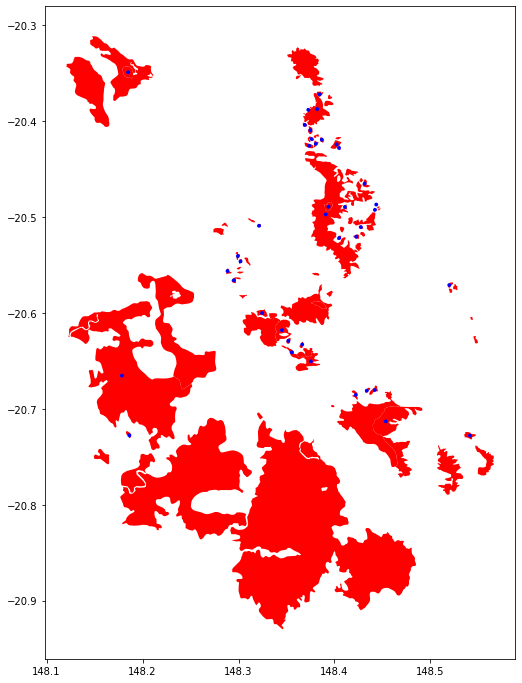

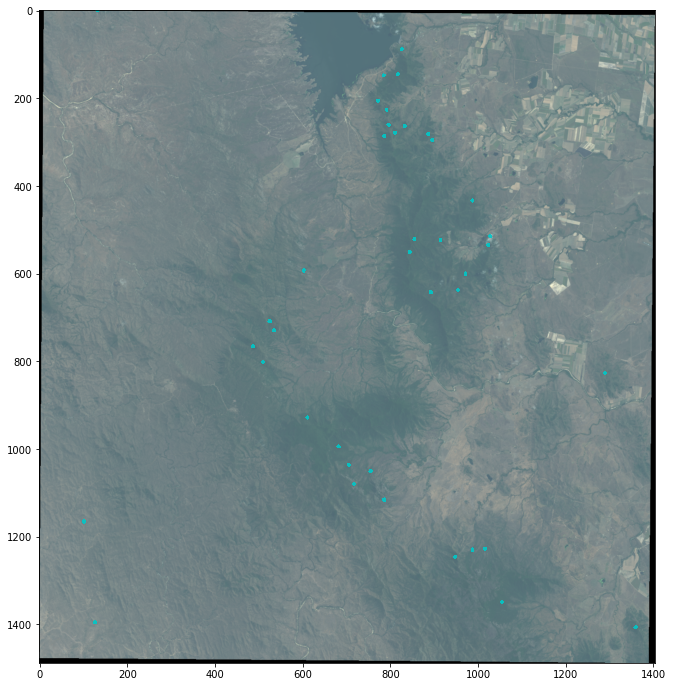

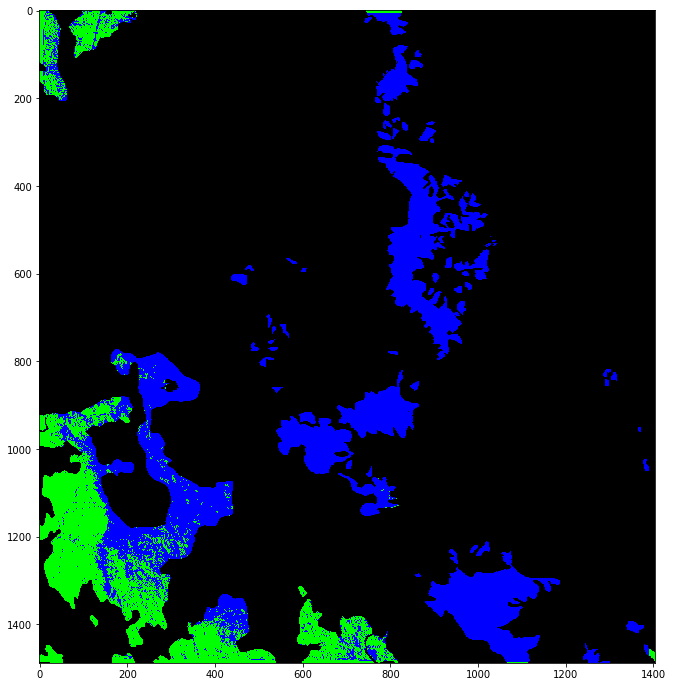

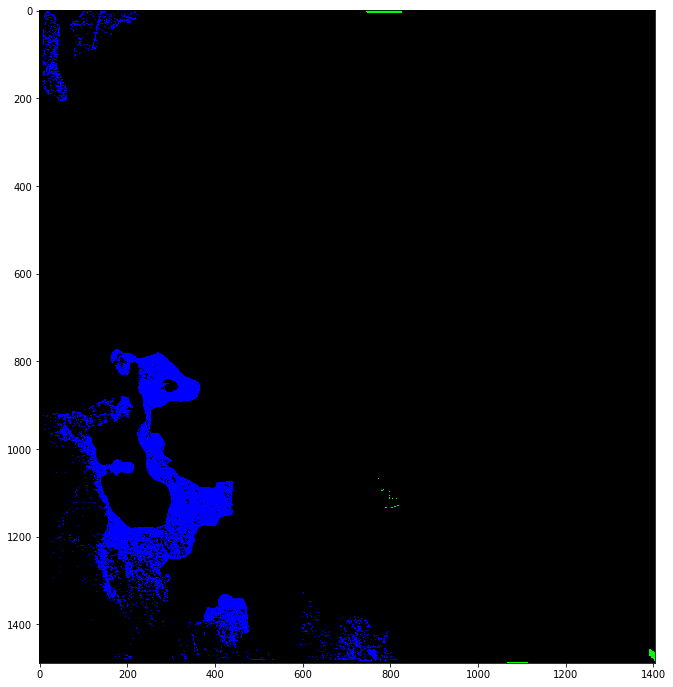

In [690]:
# 7.16
patch_sample(andromache,"andromache",spy_image_andromache,hnon_andromache,0.002,40,fpdf,zgz,1488,1404,32655)

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 40
0
hits number: 40
done.


spectral:INFO: Setting min samples to 12


                                             geometry  euc
40  POLYGON ((148.37554 -20.42585, 148.37553 -20.4...    0
54  POLYGON ((148.35393 -20.62918, 148.35392 -20.6...    0
28  POLYGON ((148.42945 -20.51071, 148.42944 -20.5...    0
29  POLYGON ((148.41880 -20.50404, 148.41879 -20.5...    0
52  POLYGON ((148.38400 -20.38768, 148.38399 -20.3...    0
74  POLYGON ((148.37476 -20.64141, 148.37475 -20.6...    0
47  POLYGON ((148.37684 -20.40980, 148.37683 -20.4...    0
63  POLYGON ((148.30361 -20.55803, 148.30360 -20.5...    0
65  POLYGON ((148.30202 -20.55371, 148.30201 -20.5...    0
69  POLYGON ((148.28100 -20.51527, 148.28100 -20.5...    0
38  POLYGON ((148.42021 -20.45319, 148.42020 -20.4...    0
30  POLYGON ((148.43846 -20.50481, 148.43845 -20.5...    0
22  POLYGON ((148.52161 -20.57111, 148.52160 -20.5...    0
21  POLYGON ((148.52778 -20.57338, 148.52777 -20.5...    0
72  POLYGON ((148.31518 -20.50346, 148.31517 -20.5...    0
19  POLYGON ((148.39646 -20.58030, 148.39645 -20.5...   

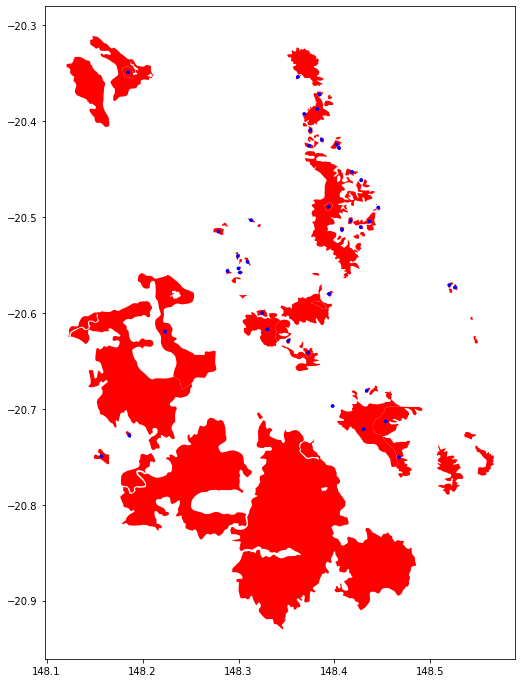

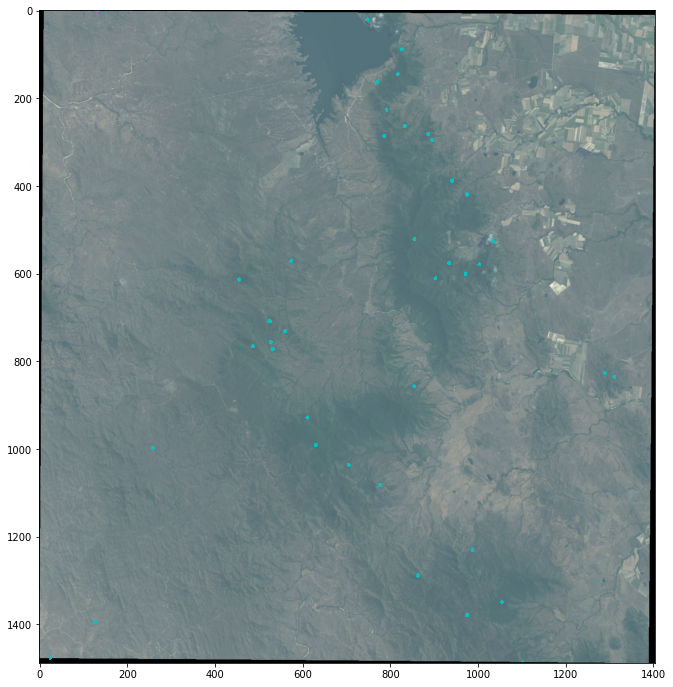

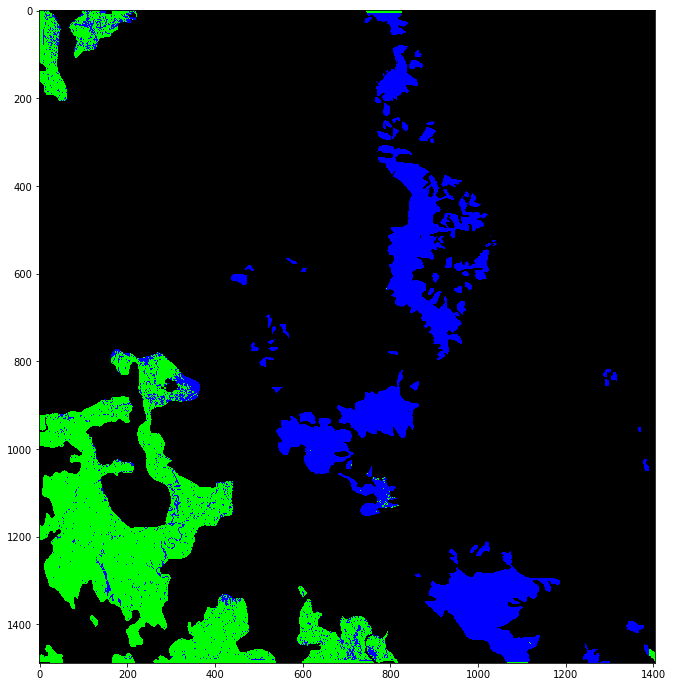

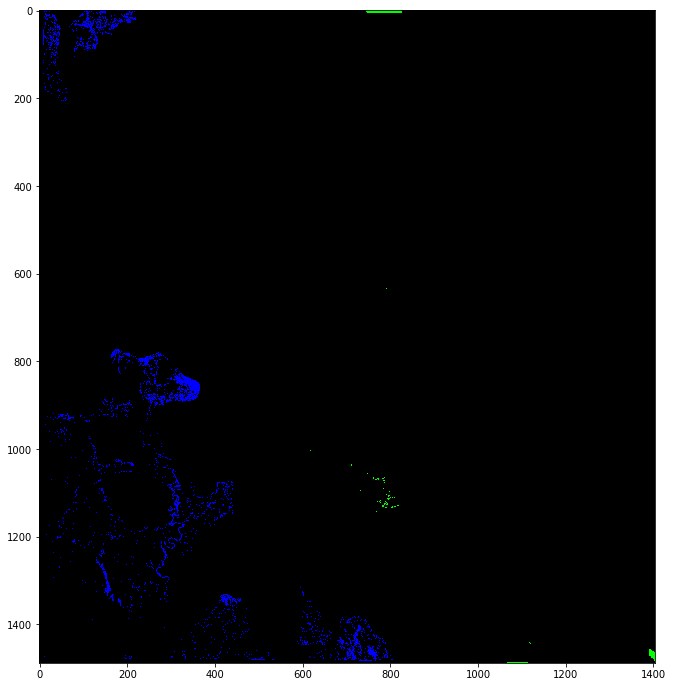

In [694]:
# 7.16 2
patch_sample(andromache,"andromache",spy_image_andromache,hnon_andromache,0.002,40,fpdf,zgz,1488,1404,32655)

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 39
0
hits number: 39
done.


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.7078437829838832

Balanced Accuracy:
0.8725754582120919


               precision    recall  f1-score   support

   Eucalyptus      0.994     0.752     0.856    182803
NonEucalyptus      0.736     0.994     0.846    127660

     accuracy                          0.851    310463
    macro avg      0.865     0.873     0.851    310463
 weighted avg      0.888     0.851     0.852    310463

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 38
0
hits number: 38
done.


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.7556795169493113

Balanced Accuracy:
0.8938590328817035


               precision    recall  f1-score   support

   Eucalyptus      0.992     0.797     0.884    182803
NonEucalyptus      0.773     0.991     0.869    127660

     accuracy                          0.877    310463
    macro avg      0.883     0.894     0.876    310463
 weighted avg      0.902     0.877     0.878    310463

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 37
0
hits number: 37
done.


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....  4.0Covariance.....  8.0Covariance..... 12.0Covariance..... 16.0Covariance..... 20.0Covariance..... 24.0Covariance..... 28.0Covariance..... 32.0Covariance..... 36.0Covariance..... 40.0Covariance..... 44.0Covariance..... 48.0Covariance..... 52.0Covariance..... 56.0Covariance..... 60.0Covariance..... 64.0Covariance..... 68.0Covariance..... 72.0Covariance..... 76.0Covariance..... 80.0Covariance..... 84.0Covariance..... 88.0Covariance..... 92.0Covariance..... 96.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.5164824655997775

Balanced Accuracy:
0.781904484483561


               precision    recall  f1-score   support

   Eucalyptus      0.991     0.571     0.725    182803
NonEucalyptus      0.618     0.993     0.762    127660

     accuracy                          0.744    310463
    macro avg      0.805     0.782     0.743   

/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 36
0
hits number: 36
done.


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.8483065916684401

Balanced Accuracy:
0.9346668744170201


               precision    recall  f1-score   support

   Eucalyptus      0.993     0.879     0.932    182803
NonEucalyptus      0.851     0.991     0.915    127660

     accuracy                          0.925    310463
    macro avg      0.922     0.935     0.924    310463
 weighted avg      0.934     0.925     0.925    310463

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 35
0
hits number: 35
done.


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....  2.0Covariance.....  4.0Covariance.....  6.0Covariance.....  8.0Covariance..... 10.0Covariance..... 12.0Covariance..... 14.0Covariance..... 16.0Covariance..... 18.0Covariance..... 20.0Covariance..... 22.0Covariance..... 24.0Covariance..... 26.0Covariance..... 28.0Covariance..... 30.0Covariance..... 32.0Covariance..... 34.0Covariance..... 36.0Covariance..... 38.0Covariance..... 40.0Covariance..... 42.0Covariance..... 44.0Covariance..... 46.0Covariance..... 48.0Covariance..... 50.0Covariance..... 52.0Covariance..... 54.0Covariance..... 56.0Covariance..... 58.0Covariance..... 60.0Covariance..... 62.0Covariance..... 64.0Covariance..... 66.0Covariance..... 68.0Covariance..... 70.0Covariance..... 72.0Covariance..... 74.0Covariance..... 76.0Covariance..... 78.0Covariance..... 80.0Covariance..... 82.0Covariance..... 84.0Covariance..... 86.0Covariance..... 88.0Covariance..... 90.0Covariance..... 92.0Covariance..... 94.0Covariance..... 96.0

/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 34
0
hits number: 34
done.


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.9098391377836922

Balanced Accuracy:
0.9608844470188387


               precision    recall  f1-score   support

   Eucalyptus      0.992     0.932     0.961    182803
NonEucalyptus      0.911     0.990     0.948    127660

     accuracy                          0.956    310463
    macro avg      0.951     0.961     0.955    310463
 weighted avg      0.959     0.956     0.956    310463

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)
xpoly.bounds:

/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

 (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 33
0
hits number: 33
done.


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.0%

LinAlgError: Singular matrix

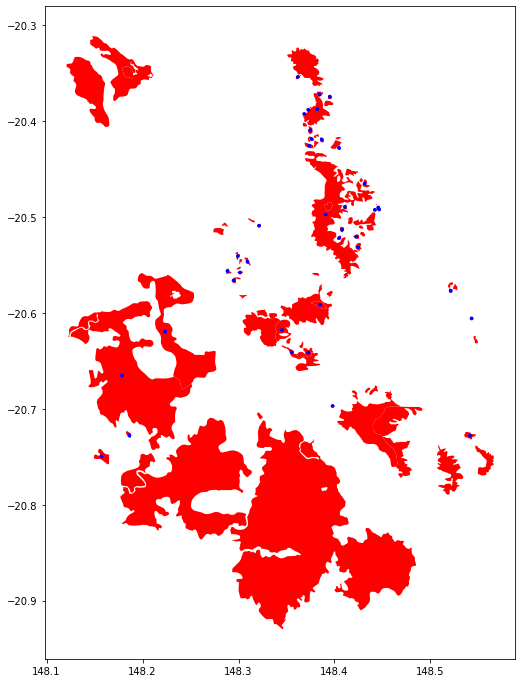

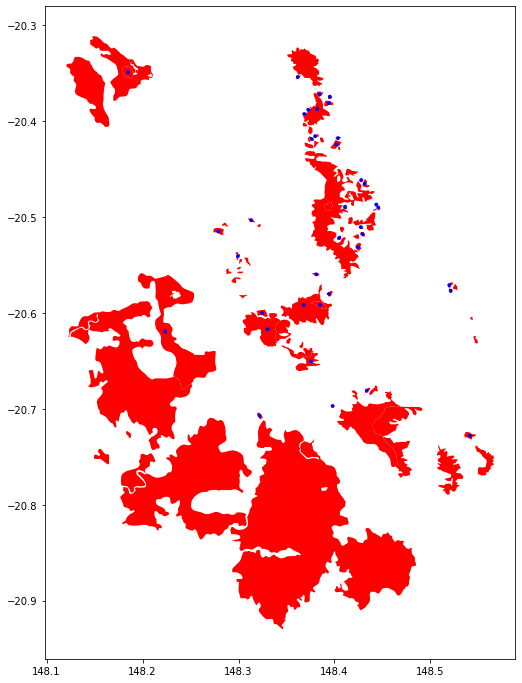

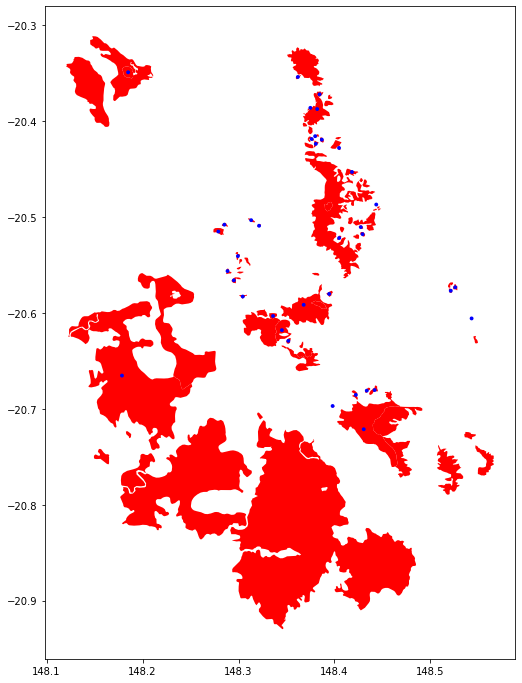

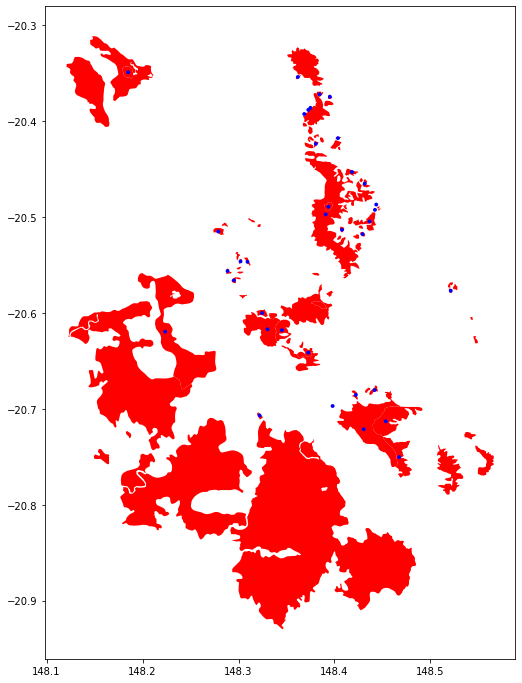

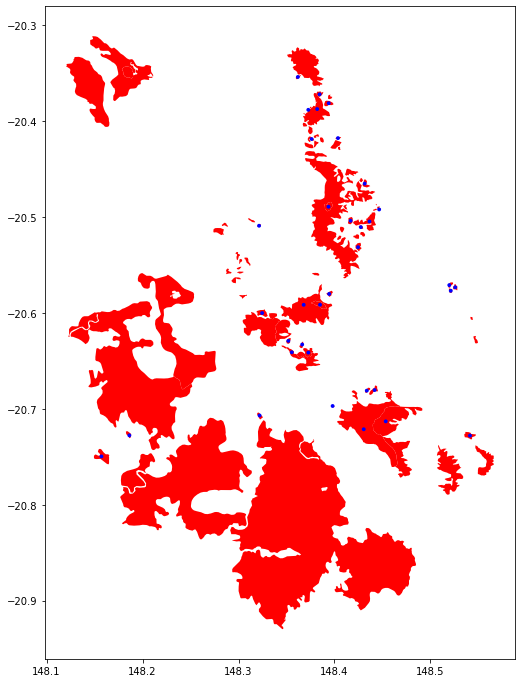

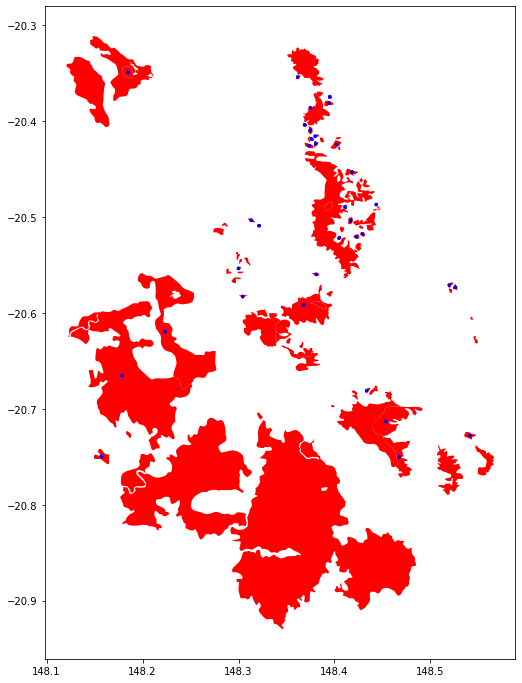

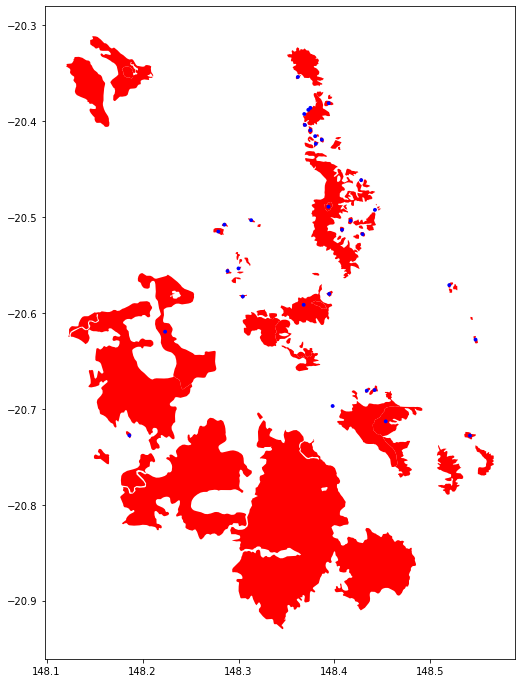

In [687]:
for i in range(1,10):
    c = 40 - i
    patch_sample_quiet(andromache,"andromache",spy_image_andromache,hnon_andromache,0.002,c,fpdf,zgz,1488,1404,32655)

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
479265.0 -2427315.0 520725.0 -2383005.0
---------spoly-------------
POLYGON ((479265 -2383005, 479265 -2427315, 520725 -2427315, 520725 -2383005, 479265 -2383005))
image pixel dimensions:
(1477, 1382, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (479265.0, -2427315.0, 520725.0, -2383005.0)
chd:44310.0 cwd:41460.0
poly number: 1
0
dfn: 50
0
hits number: 50
done.


spectral:INFO: Setting min samples to 12


                                              geometry  euc
134  POLYGON ((147.04505 -21.55287, 147.04504 -21.5...    1
58   POLYGON ((147.07869 -21.82596, 147.07869 -21.8...    1
202  POLYGON ((146.81090 -21.56930, 146.81089 -21.5...    0
49   POLYGON ((147.15585 -21.87347, 147.15585 -21.8...    1
115  POLYGON ((147.13418 -21.93699, 147.13418 -21.9...    1
201  POLYGON ((146.83527 -21.57124, 146.83527 -21.5...    0
205  POLYGON ((146.80701 -21.55728, 146.80701 -21.5...    0
81   POLYGON ((147.18459 -21.58513, 147.18459 -21.5...    1
3    POLYGON ((146.92353 -21.65255, 146.92352 -21.6...    1
160  POLYGON ((147.04779 -21.85532, 147.04778 -21.8...    0
118  POLYGON ((147.14295 -21.70860, 147.14294 -21.7...    1
98   POLYGON ((146.82039 -21.86859, 146.82038 -21.8...    1
0    POLYGON ((147.00759 -21.66294, 147.00759 -21.6...    1
239  POLYGON ((146.82447 -21.63763, 146.82447 -21.6...    0
59   POLYGON ((147.08936 -21.82345, 147.08935 -21.8...    1
125  POLYGON ((147.11575 -21.82508, 147.

LinAlgError: Singular matrix

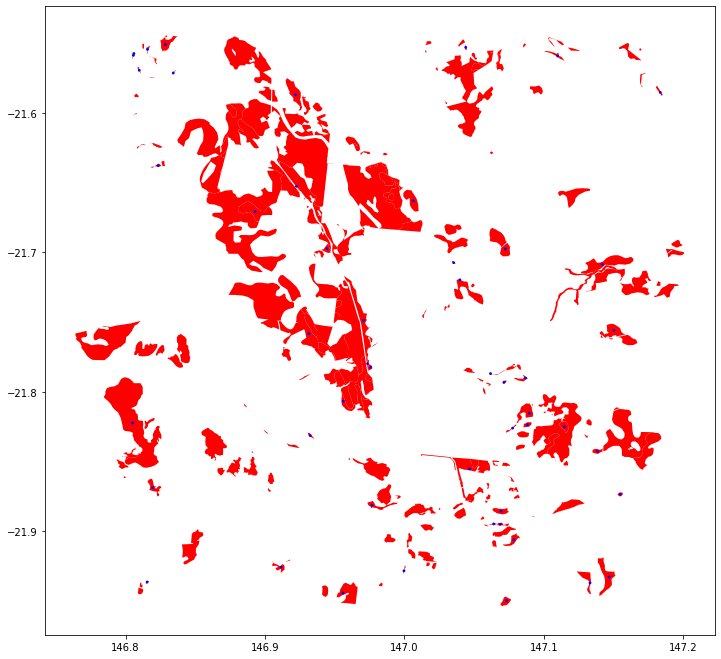

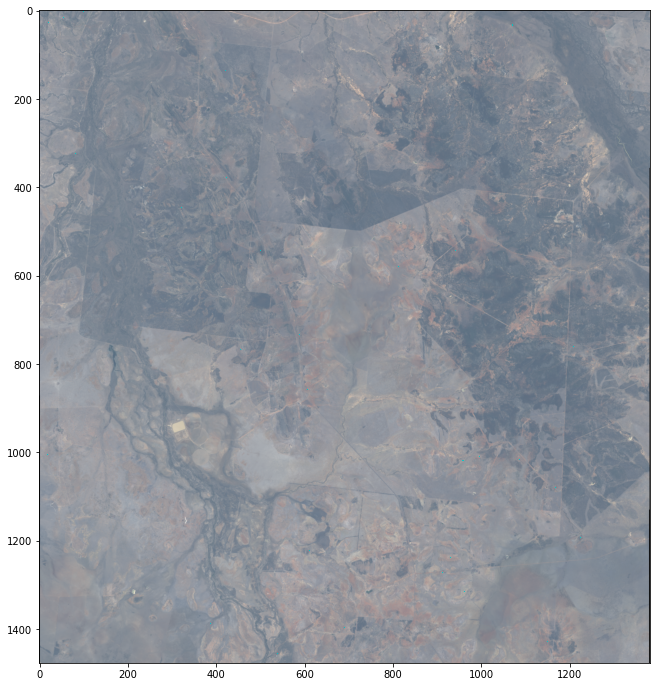

In [682]:
patch_sample(belyando,"belyando",spy_image_belyando,hnon_belyando,0.001,50,fpdf,zgz,1477,1382,32655)

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
347115.0 -1909545.0 364245.0 -1892145.0
---------spoly-------------
POLYGON ((347115 -1892145, 347115 -1909545, 364245 -1909545, 364245 -1892145, 347115 -1892145))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (347115.0, -1909545.0, 364245.0, -1892145.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 80
0
hits number: 36
done.


/usr/local/lib/python3.7/site-packages/matplotlib/image.py:452: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)


                                              geometry  euc
615  POLYGON ((145.68086 -17.20581, 145.68085 -17.2...    0
759  POLYGON ((145.57661 -17.00771, 145.57660 -17.0...    0
288  POLYGON ((145.56463 -17.26755, 145.56462 -17.2...    0
78   POLYGON ((145.69047 -17.16977, 145.69046 -17.1...    1
200  POLYGON ((145.69306 -17.11339, 145.69305 -17.1...    1
..                                                 ...  ...
780  POLYGON ((145.63531 -17.06345, 145.63530 -17.0...    0
499  POLYGON ((145.68376 -17.13552, 145.68375 -17.1...    0
57   POLYGON ((145.69174 -17.03256, 145.69173 -17.0...    1
565  POLYGON ((145.69440 -17.19509, 145.69439 -17.1...    0
700  POLYGON ((145.61275 -17.06205, 145.61274 -17.0...    0

[80 rows x 2 columns]
['classes', 'nbands', '__module__', '__doc__', '__init__', '__getitem__', '__len__', 'add_class', 'transform', '__iter__', 'all_samples', 'calc_stats', 'save', 'load', '__dict__', '__weakref__', '__repr__', '__hash__', '__str__', '__getattribute__', '__seta

AttributeError: 'GaussianClassifier' object has no attribute 'classes'

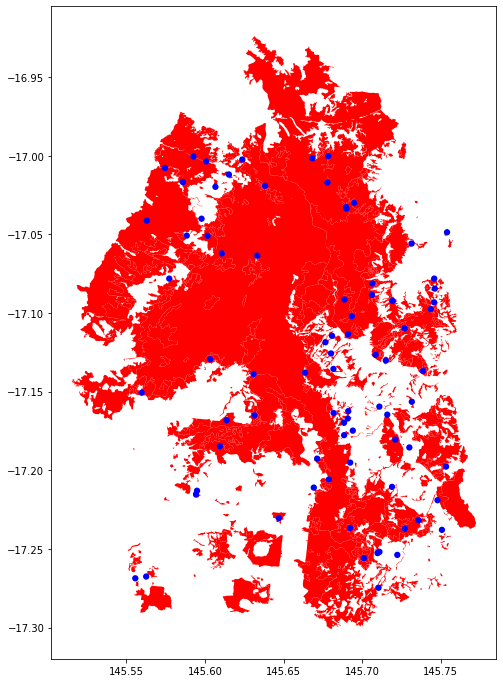

/usr/local/lib/python3.7/site-packages/matplotlib/image.py:452: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)


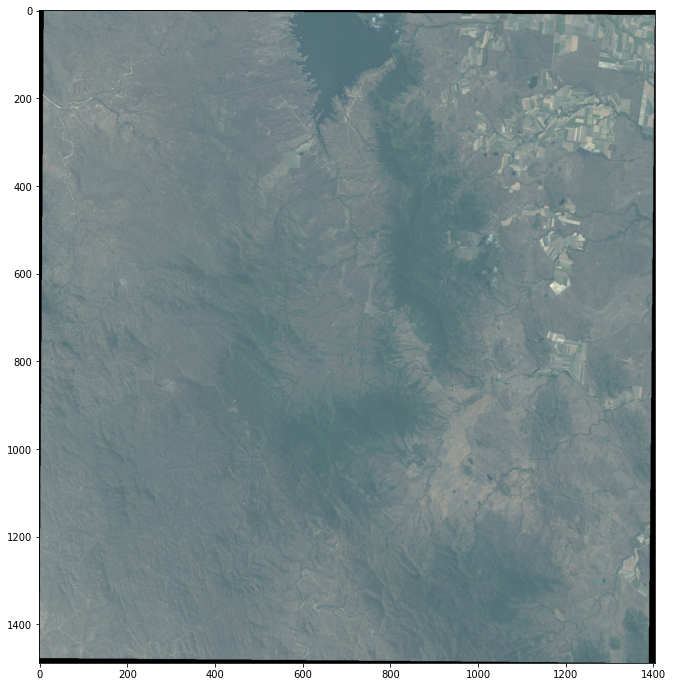

In [680]:
patch_sample(danbulla,"danbulla",spy_image_danbulla,hnon_danbulla,0.002,80,fpdf,zgz,1488,1404,32655)

------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
349185.0 -2020665.0 371535.0 -2007435.0
---------spoly-------------
POLYGON ((349185 -2007435, 349185 -2020665, 371535 -2020665, 371535 -2007435, 349185 -2007435))
image pixel dimensions:
(441, 745, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (349185.0, -2020665.0, 371535.0, -2007435.0)
chd:13230.0 cwd:22350.0
poly number: 1
0
dfn: 40
0
hits number: 40
done.


spectral:INFO: Setting min samples to 12


                                              geometry  euc
169  POLYGON ((145.62021 -18.26589, 145.62020 -18.2...    0
88   POLYGON ((145.68155 -18.15675, 145.68155 -18.1...    1
74   POLYGON ((145.74235 -18.19444, 145.74234 -18.1...    1
290  POLYGON ((145.78001 -18.16912, 145.78000 -18.1...    0
150  POLYGON ((145.65865 -18.24531, 145.65865 -18.2...    1
83   POLYGON ((145.72567 -18.17596, 145.72567 -18.1...    1
231  POLYGON ((145.77086 -18.25914, 145.77085 -18.2...    0
226  POLYGON ((145.76051 -18.19454, 145.76050 -18.1...    0
79   POLYGON ((145.74066 -18.18192, 145.74065 -18.1...    1
202  POLYGON ((145.60591 -18.23056, 145.60591 -18.2...    0
196  POLYGON ((145.59367 -18.24037, 145.59367 -18.2...    0
225  POLYGON ((145.76394 -18.20689, 145.76393 -18.2...    0
263  POLYGON ((145.73342 -18.19732, 145.73342 -18.1...    0
117  POLYGON ((145.71227 -18.21491, 145.71226 -18.2...    1
190  POLYGON ((145.66405 -18.25828, 145.66404 -18.2...    0
299  POLYGON ((145.77132 -18.15797, 145.

LinAlgError: Singular matrix

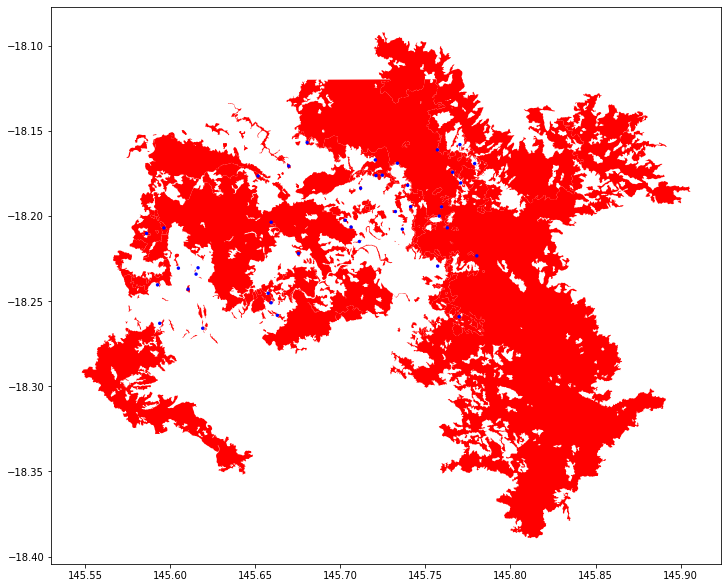

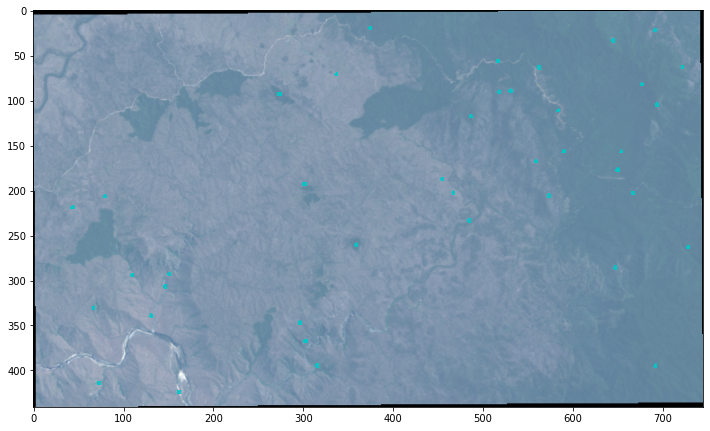

In [651]:
patch_sample(kirrama,"kirrama",spy_image_kirrama,hnon_kirrama,0.001,40,fpdf,zgz,441,745,32655)

------ xkpls_m
------src.ref_____
EPSG:32656
---------lbrt-------------
440985.0 -3163845.0 500025.0 -3097185.0
---------spoly-------------
POLYGON ((440985 -3097185, 440985 -3163845, 500025 -3163845, 500025 -3097185, 440985 -3097185))
image pixel dimensions:
(2222, 1968, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (440985.0, -3163845.0, 500025.0, -3097185.0)
chd:66660.0 cwd:59040.0
poly number: 1
0
dfn: 40
0
hits number: 40
done.


spectral:INFO: Setting min samples to 12


                                              geometry  euc
340  POLYGON ((152.83895 -28.32260, 152.83890 -28.3...    0
59   POLYGON ((152.48452 -28.13349, 152.48447 -28.1...    1
230  POLYGON ((152.54610 -28.19153, 152.54605 -28.1...    1
6    POLYGON ((152.41646 -28.14749, 152.41641 -28.1...    1
131  POLYGON ((152.92526 -28.23368, 152.92521 -28.2...    1
50   POLYGON ((153.00234 -28.33785, 153.00229 -28.3...    1
385  POLYGON ((152.40382 -28.06316, 152.40377 -28.0...    0
439  POLYGON ((152.88457 -28.31197, 152.88453 -28.3...    0
179  POLYGON ((152.99778 -28.16181, 152.99773 -28.1...    1
328  POLYGON ((152.77505 -28.21555, 152.77500 -28.2...    1
184  POLYGON ((152.95830 -28.15531, 152.95825 -28.1...    1
637  POLYGON ((152.75869 -28.21273, 152.75864 -28.2...    0
3    POLYGON ((152.81186 -28.35346, 152.81182 -28.3...    1
505  POLYGON ((152.70811 -28.29106, 152.70806 -28.2...    0
647  POLYGON ((152.93616 -28.30562, 152.93611 -28.3...    0
501  POLYGON ((152.72051 -28.34145, 152.

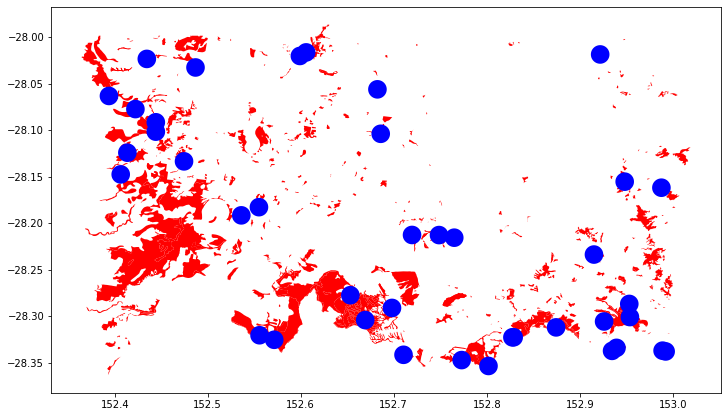

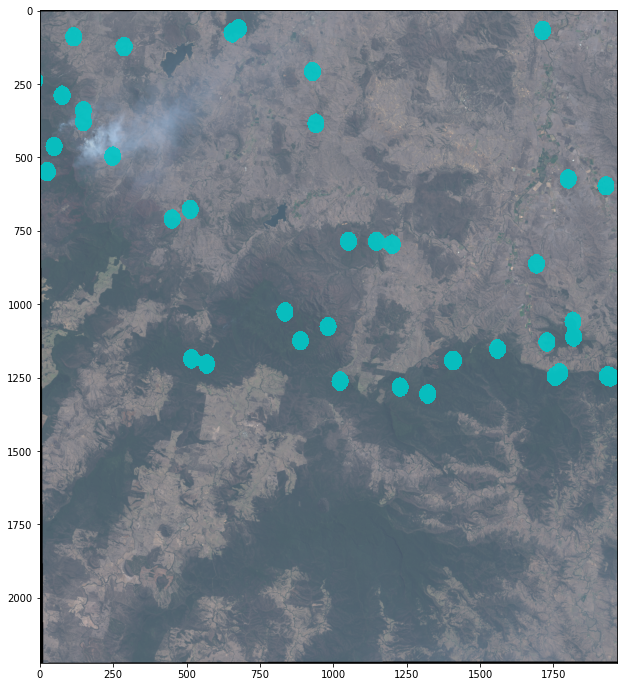

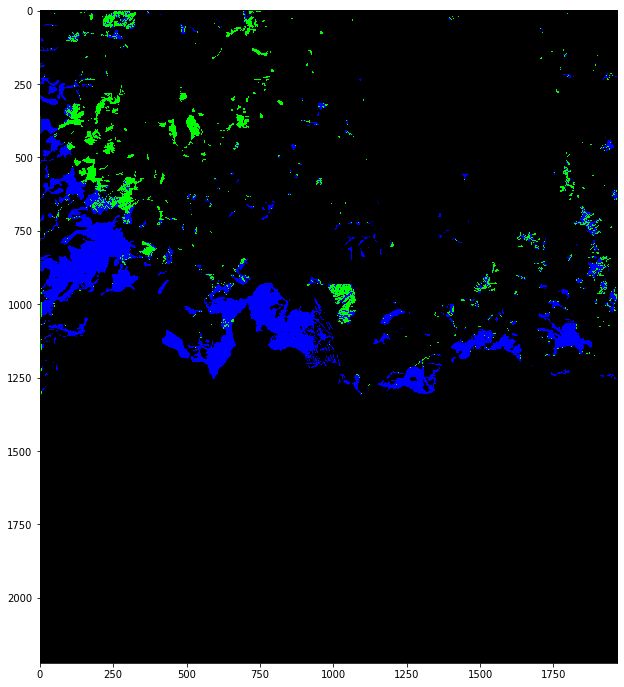

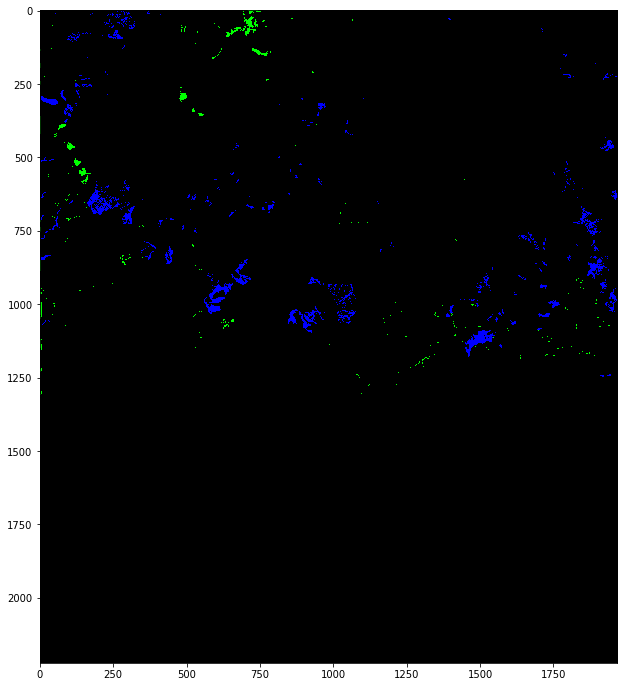

In [681]:
patch_sample(mountbarney,"mountbarney",spy_image_mountbarney,hnon_mountbarney,0.01,40,fpdf,zgz,2222,1968,32656)

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.4524073559293692

Balanced Accuracy:
0.717135892307624


               precision    recall  f1-score   support

   Eucalyptus      0.738     0.878     0.802    104779
NonEucalyptus      0.762     0.557     0.643     73610

     accuracy                          0.745    178389
    macro avg      0.750     0.717     0.723    178389
 weighted avg      0.748     0.745     0.736    178389



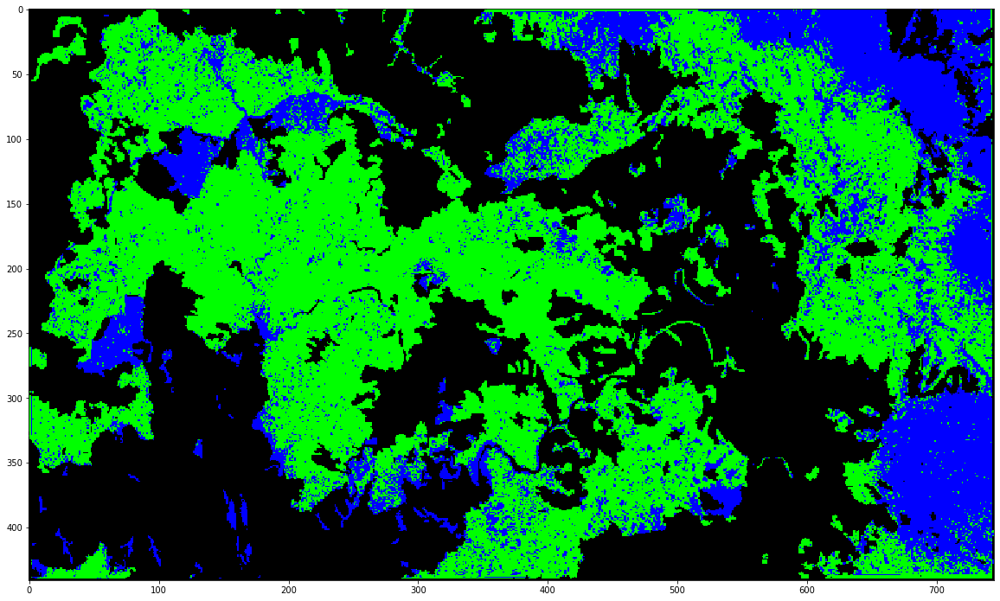

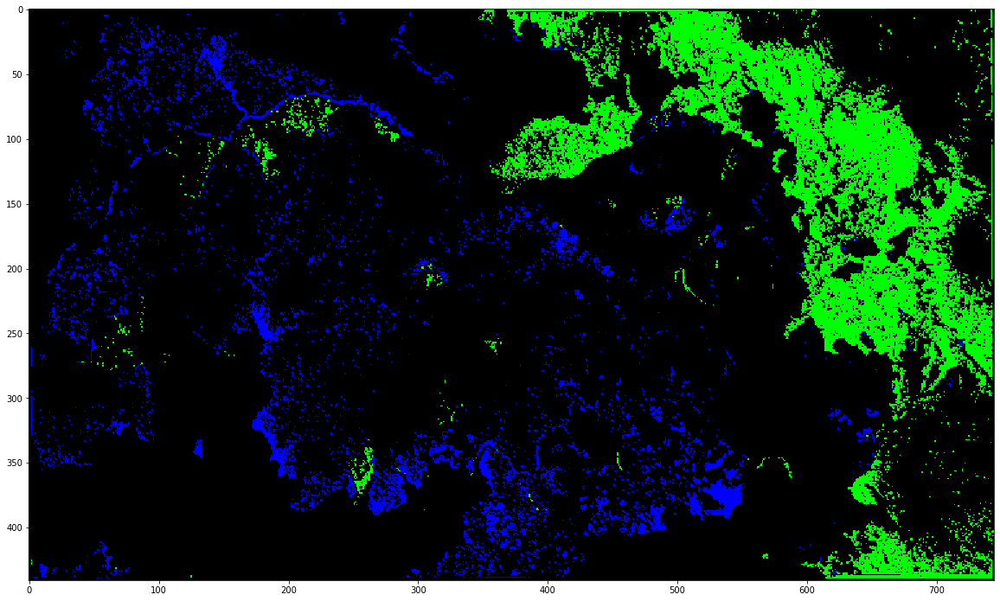

In [590]:
train_and_apply_single(hnon_kirrama_sample,hnon_kirrama,spy_image_kirrama,20)

In [586]:
%run create_training_polygons
hsf_kirrama = "/Users/brian/code/Eucalyptus_GLMClassifier/kirrama_reflectance_full.tif"
#hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
hnon_kirrama_sample = xkpls_m(hsf_kirrama,spy_image_kirrama,8,udfws,4326,4283,32655,0,441,0,745,zgz)

ready...
------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
349185.0 -2020665.0 371535.0 -2007435.0
---------spoly-------------
POLYGON ((349185 -2007435, 349185 -2020665, 371535 -2020665, 371535 -2007435, 349185 -2007435))
image pixel dimensions:
(441, 745, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (349185.0, -2020665.0, 371535.0, -2007435.0)
chd:13230.0 cwd:22350.0
poly number: 1
0
dfn: 300
0
hits number: 300
0 of 300
1 of 300
2 of 300
3 of 300
4 of 300
5 of 300
6 of 300
7 of 300
8 of 300
9 of 300
10 of 300
11 of 300
12 of 300
13 of 300
14 of 300
15 of 300
16 of 300
17 of 300
18 of 300
19 of 300
20 of 300
21 of 300
22 of 300
23 of 300
24 of 300
25 of 300
26 of 300
27 of 300
28 of 300
29 of 300
30 of 300
31 of 300
32 of 300
33 of 300
34 of 300
35 of 300
36 of 300
37 of 300
38 of 300
39 of 300
40 of 300
41 of 300
42 of 300
43 of 300
44 of 300
45 of 300
46 of 300
47 of 300
48 of 300
49 of 300
50 of 300
51 of 300
52 of 300
53 of 300
54 of 300
55 of 300
56 of 300
57 of 300
58 of 300
59 of 300
60 of 300
61 of 300
62 of 300
63 of 300
64 of 300
65 of 300
66 of 300
67 of 300
68 of 300
69 of 300
70 of 300
71 of 300
72 of 300
73 of 300
74 of 300
75 of 300
76 of 300
77 of 300
78 of 300
79 of 300
80 of 300
81 of 300
82 of 300
83 of 300
84 of 300
85 of 300
86 of 300
87 of 300
88

spectral:INFO: Setting min samples to 12


Classifying image...  0.Classifying image...done  
Classifier Results
[0 2 3]
[306255  21996    294]
Testing Errors
[0 2 3]
[317176  11139    230]


ImageView object:
  Interpolation       :  none

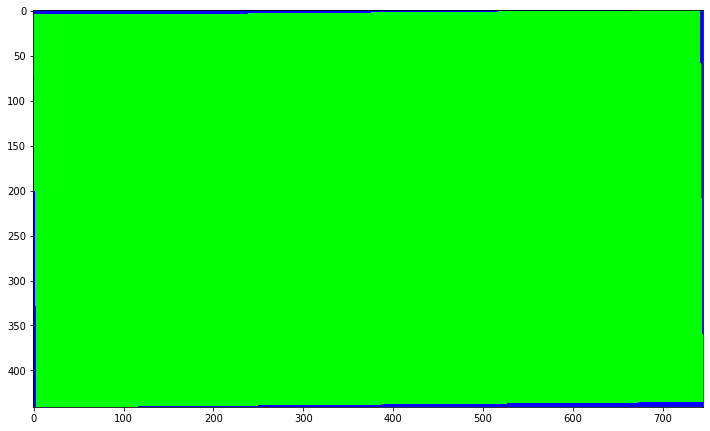

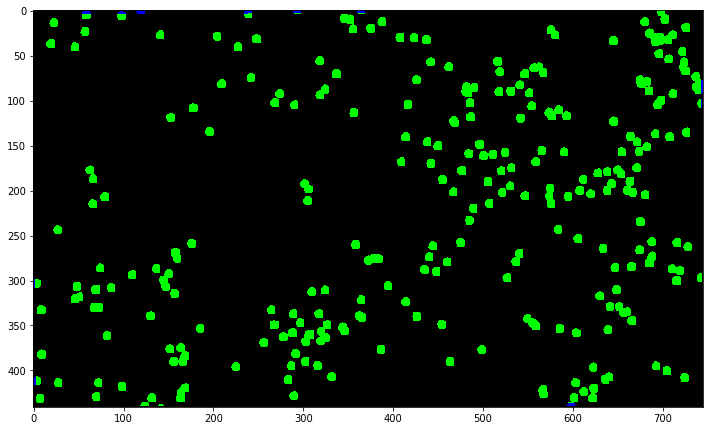

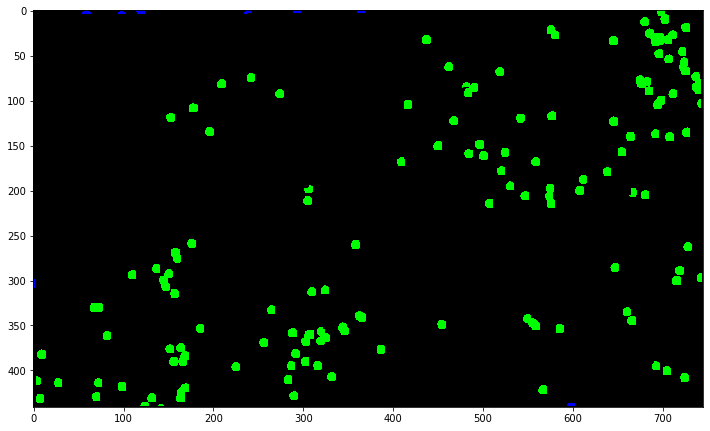

In [588]:
import spectral as spy
traint_ks = spy.create_training_classes(spy_image_kirrama,hnon_kirrama_sample)
gmlc1 = GaussianClassifier(traint)

clmap1 = gmlc1.classify_image(spy_image_kirrama)
imshow(classes=clmap1,figsize=(fg,fg),interpolation='none')

#gtresultst1 = clmap1 * (hnon != 0)
gtresults_testing = clmap1 * (hnon_kirrama_sample != 0)
print("Classifier Results")
unique, counts = np.unique(gtresults_testing, return_counts=True)
print(unique)
print(counts)

v = imshow(classes=gtresults_testing,figsize=(fg,fg),interpolation='none')
testing_errors2 = gtresults_testing * (gtresults_testing != hnon_kirrama_sample)
print("Testing Errors")
unique, counts = np.unique(testing_errors2, return_counts=True)
print(unique)
print(counts)
imshow(classes=testing_errors2,figsize=(fg,fg),interpolation='none')

In [54]:
%run create_training_polygons
hsf = "/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.tif"
#hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,701,0,745,zgz)

ready...
------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
331395.0 -1941705.0 345345.0 -1920705.0
---------spoly-------------
POLYGON ((331395 -1920705, 331395 -1941705, 345345 -1941705, 345345 -1920705, 331395 -1920705))
image pixel dimensions:
(700, 465, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (331395.0, -1941705.0, 345345.0, -1920705.0)
chd:21000.0 cwd:13950.0
poly number: 1
0
dfn: 276
0
hits number: 276
done.


<Figure size 432x288 with 0 Axes>

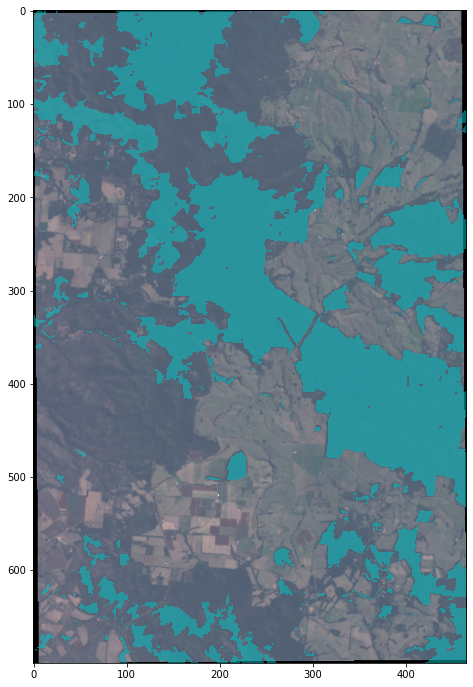

In [62]:
view = imshow(spy_image, (3, 2, 1), classes=hnon,figsize=(fg,fg))
view.set_display_mode('overlay')
view.class_alpha = 0.5

In [261]:
tandt = split_pixels_training_testing(hnon,0.1)
training_pixels = tandt[0]
testing_pixels = tandt[1]

In [104]:
type(hnon)
np.savetxt("hnon_herberton.txt",hnon,delimiter=',')

In [200]:
hnon_herberton = hnon

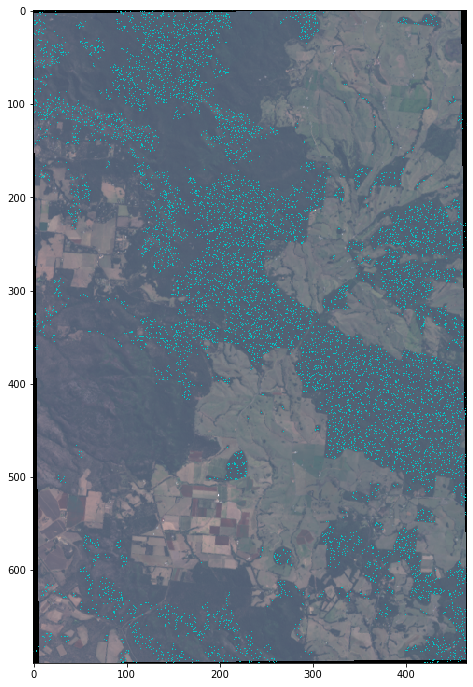

In [262]:
view = imshow(spy_image, (3, 2, 1), classes=training_pixels,figsize=(fg,fg),interpolation='none')
view.set_display_mode('overlay')
view.class_alpha = 1.0

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...  1.Classifying image...  2.Classifying image...  3.Classifying image...  4.Classifying image...  5.Classifying image...  6.Classifying image...  7.Classifying image...  8.Classifying image...  9.Classifying image... 10.Classifying image... 11.Classifying image... 12.Classifying image... 13.Classifying image... 14.Classifying image... 15.Classifying image... 16.Classifying image... 17.Classifying image... 18.Classifying image... 19.Classifying image... 20.Classifying image... 21.Classifying image... 22.Classifying image... 23.Classifying image... 24.Classifying image... 25.Classifying image... 26.Classifying image... 27.Classifying image... 28.Classifying image... 29.Classifying image... 30.Classifying image... 31.Classifying image... 32.Classifying image... 33.Classifying image... 34.Classifying image... 35.Classifying 

ImageView object:
  Interpolation       :  none

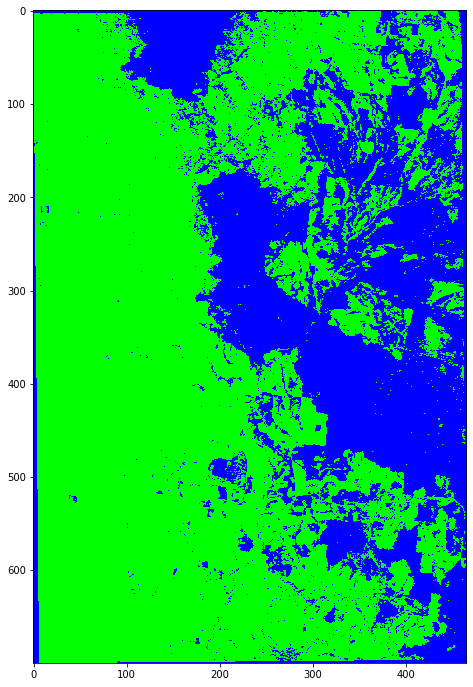

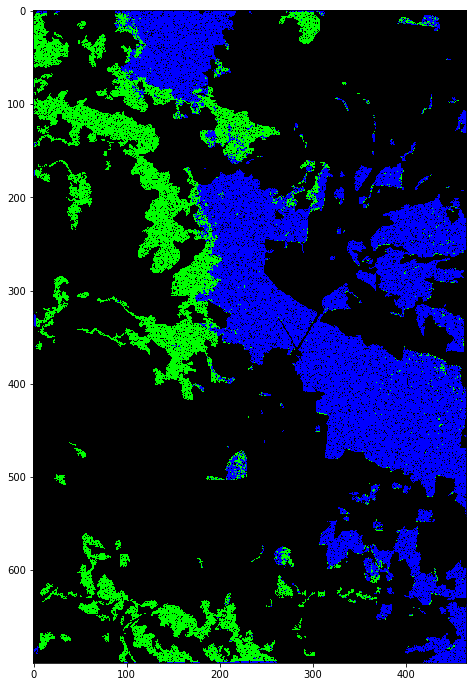

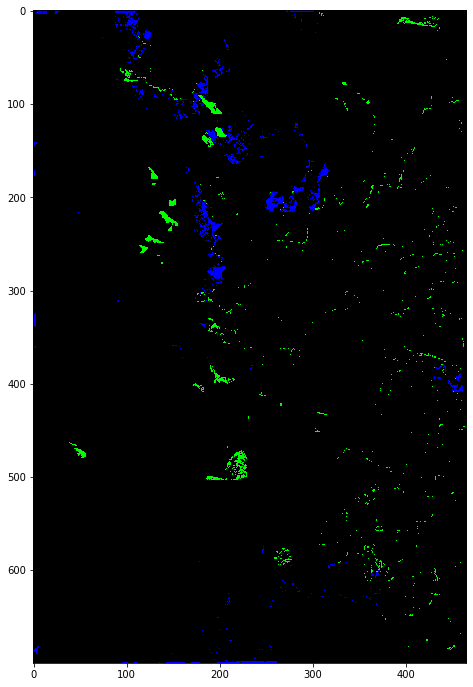

In [263]:
import spectral as spy
traint = spy.create_training_classes(spy_image,training_pixels)
gmlc1 = GaussianClassifier(traint)

clmap1 = gmlc1.classify_image(spy_image)
imshow(classes=clmap1,figsize=(fg,fg),interpolation='none')

#gtresultst1 = clmap1 * (hnon != 0)
gtresults_testing = clmap1 * (testing_pixels != 0)
print("Classifier Results")
unique, counts = np.unique(gtresults_testing, return_counts=True)
print(unique)
print(counts)


v = imshow(classes=gtresults_testing,figsize=(fg,fg),interpolation='none')
testing_errors2 = gtresults_testing * (gtresults_testing != testing_pixels)
print("Testing Errors")
unique, counts = np.unique(testing_errors2, return_counts=True)
print(unique)
print(counts)
imshow(classes=training_errors2,figsize=(fg,fg),interpolation='none')

In [81]:
def confusion_matrix(testing_pixels,gtresults_testing):
    hnf = testing_pixels.flatten()
    hnfnz = hnf[hnf != 0]
    gnf = gtresults_testing.flatten()
    gnfnz = gnf[gnf != 0]

    y_actu = pd.Series(hnfnz, name='Actual')
    y_pred = pd.Series(gnfnz.flatten(), name='Predicted')
    df_confusion_nz = pd.crosstab(y_actu, y_pred)

    df_conf_norm = df_confusion_nz / df_confusion_nz.sum(axis=1)
    return(df_conf_norm)

In [212]:
import sklearn
from sklearn import metrics

def classification_metrics(testing_pixels,gtresults_testing):
    hnf = testing_pixels.flatten()
    hnfnz = hnf[hnf != 0]
    gnf = gtresults_testing.flatten()
    gnfnz = gnf[gnf != 0]

    y_actu = pd.Series(hnfnz, name='Actual')
    y_pred = pd.Series(gnfnz.flatten(), name='Predicted')
    
    y2 = y_actu.replace(2,"Eucalyptus")
    y3 = y2.replace(3,"NonEucalyptus")
    yp2 = y_pred.replace(2,"Eucalyptus")
    yp3 = yp2.replace(3,"NonEucalyptus")

    df_confusion_nz = pd.crosstab(y3, yp3)
    
    print("\n")
    print("Cohen's Kappa:")
    print(sklearn.metrics.cohen_kappa_score(y3, yp3))
    print("\nBalanced Accuracy:")
    print(sklearn.metrics.balanced_accuracy_score(y3, yp3))
    print("\n")
    print(sklearn.metrics.classification_report(y3, yp3, digits=3))

    df_conf_norm = df_confusion_nz / df_confusion_nz.sum(axis=1)
    return(df_conf_norm)

In [264]:
classification_metrics(testing_pixels,gtresults_testing)



Cohen's Kappa:
0.8722470693799399

Balanced Accuracy:
0.9335734580036479


               precision    recall  f1-score   support

   Eucalyptus      0.927     0.904     0.916     31109
NonEucalyptus      0.950     0.963     0.956     58902

     accuracy                          0.943     90011
    macro avg      0.939     0.934     0.936     90011
 weighted avg      0.942     0.943     0.942     90011



Predicted,Eucalyptus,NonEucalyptus
Actual,,
Eucalyptus,0.904497,0.05044
NonEucalyptus,0.070719,0.96265


___


# Second Location: Kirrama
___

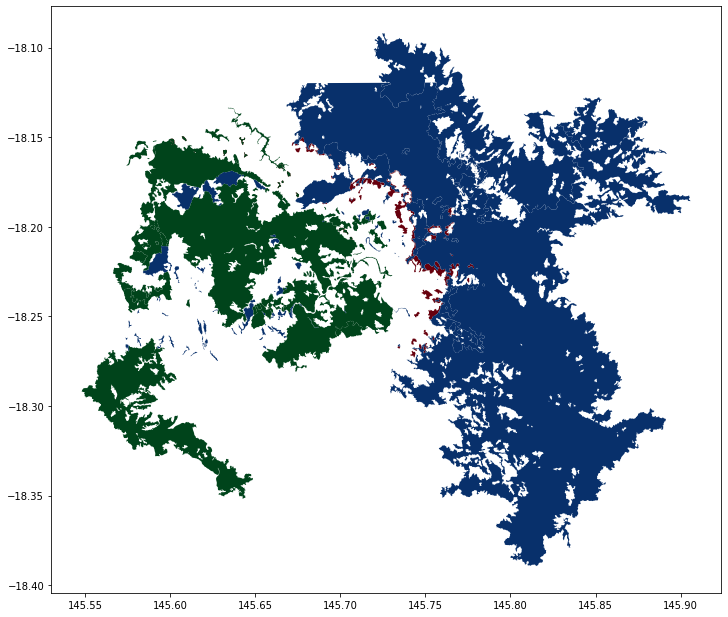

In [458]:

subset2m = eucmg[eucmg.intersects(kirrama)]
subset2 = euc[euc.intersects(kirrama)]
subset2ne = noneuc[noneuc.intersects(kirrama)]
ax = subset2.plot(color='white',figsize=(fg,fg))

cmap_reds=plt.cm.get_cmap('Reds', 2)
cmap_blues=plt.cm.get_cmap('Blues', 2)
cmap_greens=plt.cm.get_cmap('Greens', 2)

subset2x = subset2
subset2x.plot(ax=ax,color=cmap_reds(2),figsize=(fg,fg))
        
subset2x = subset2ne
subset2x.plot(ax=ax,color=cmap_blues(2),figsize=(fg,fg))

subset2x = subset2m
subset2x.plot(ax=ax,color=cmap_greens(2),figsize=(fg,fg))

needed_kirrama_polygons = pd.concat([subset2,subset2ne,subset2m])

In [93]:
subset2mi = fpdf[fpdf.intersects(kirrama)]
len(subset2mi)

333

In [94]:
rpath = "/Users/brian/code/Eucalyptus_GLMClassifier/kirrama/dcdd4c23-4251-4e5c-9adb-7c64276860bd/Landsat8L1G/"
stem = "LC08_L1TP_095073_20191016_20191029"
fntag = "kirrama"
ls2envi_full(rpath,stem,fntag)

sds = gdal.Open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.tif")
driver = gdal.GetDriverByName('ENVI')
dst = driver.CreateCopy("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil",sds)
dst = None
spy_image_kirrama = envi.open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.hdr",
                      image="/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil")

In [119]:
%run create_training_polygons
print('loaded')
hsf_kirrama = "/Users/brian/code/Eucalyptus_GLMClassifier/kirrama_reflectance_full.tif"
#hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
hnon_kirrama = xkpls_m(hsf_kirrama,spy_image_kirrama,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)

ready...
loaded
------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
349185.0 -2020665.0 371535.0 -2007435.0
---------spoly-------------
POLYGON ((349185 -2007435, 349185 -2020665, 371535 -2020665, 371535 -2007435, 349185 -2007435))
image pixel dimensions:
(441, 745, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (349185.0, -2020665.0, 371535.0, -2007435.0)
chd:13230.0 cwd:22350.0
poly number: 1
0
dfn: 333
0
hits number: 333
0 of 333
1 of 333
2 of 333
3 of 333
4 of 333
5 of 333
6 of 333
7 of 333
8 of 333
9 of 333
10 of 333
11 of 333
12 of 333
13 of 333
14 of 333
15 of 333
16 of 333
17 of 333
18 of 333
19 of 333
20 of 333
21 of 333
22 of 333
23 of 333
24 of 333
25 of 333
26 of 333
27 of 333
28 of 333
29 of 333
30 of 333
31 of 333
32 of 333
33 of 333
34 of 333
35 of 333
36 of 333
37 of 333
38 of 333
39 of 333
40 of 333
41 of 333
42 of 333
43 of 333
44 of 333
45 of 333
46 of 333
47 of 333
48 of 333
49 of 333
50 of 333
51 of 333
52 of 333
53 of 333
54 of 333
55 of 333
56 of 333
57 of 333
58 of 333
59 of 333
60 of 333
61 of 333
62 of 333
63 of 333
64 of 333
65 of 333
66 of 333
67 of 333
68 of 333
69 of 333
70 of 333
71 of 333
72 of 333
73 of 333
74 of 333
75 of 333
76 of 333
77 of 333
78 of 333
79 of 333
80 of 333
81 of 333
82 of 333
83 of 333
84 of 333
85 of 333
86 of 333
87 of 333
88

<Figure size 432x288 with 0 Axes>

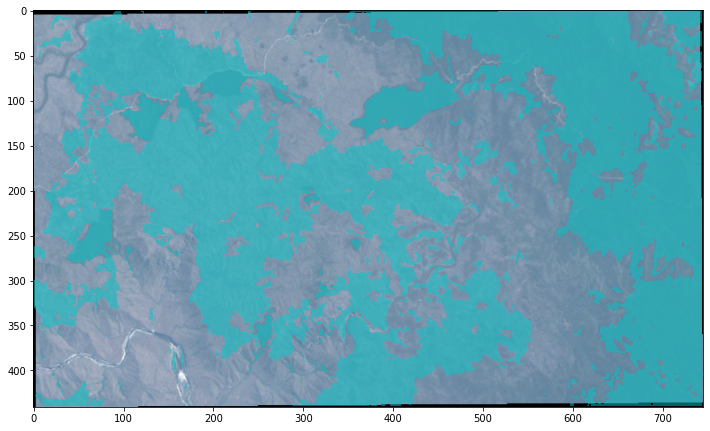

In [120]:
view = imshow(spy_image_kirrama, (3, 2, 1), classes=hnon_kirrama,figsize=(fg,fg))
view.set_display_mode('overlay')
view.class_alpha = 0.5

In [256]:
tandt_kirrama = split_pixels_training_testing(hnon_kirrama,0.1)
training_pixels_kirrama = tandt_kirrama[0]
testing_pixels_kirrama = tandt_kirrama[1]

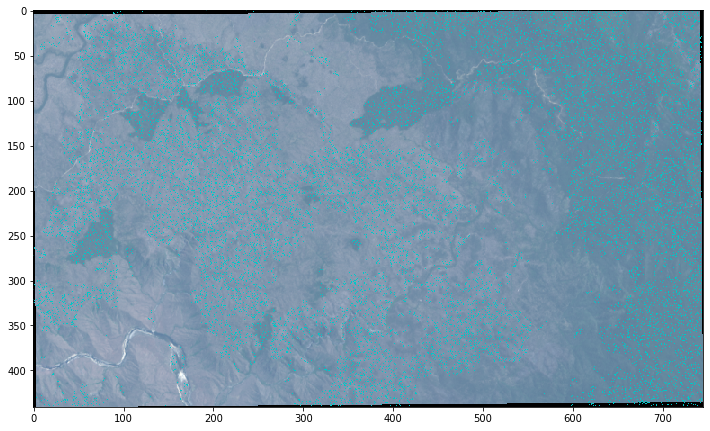

In [257]:
view = imshow(spy_image_kirrama, (3, 2, 1), classes=training_pixels_kirrama,figsize=(fg,fg),interpolation='none')
view.set_display_mode('overlay')
view.class_alpha = 1.0

In [258]:
import spectral as spy
traint_kirrama = spy.create_training_classes(spy_image_kirrama,training_pixels_kirrama)
gmlc1_kirrama = GaussianClassifier(traint_kirrama)
clmap1_kirrama = gmlc1_kirrama.classify_image(spy_image_kirrama)


spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Classifier Results
Testing Errors


ImageView object:
  Interpolation       :  none

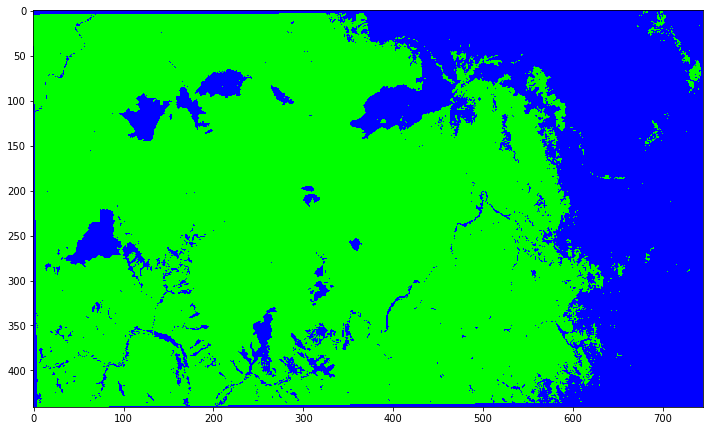

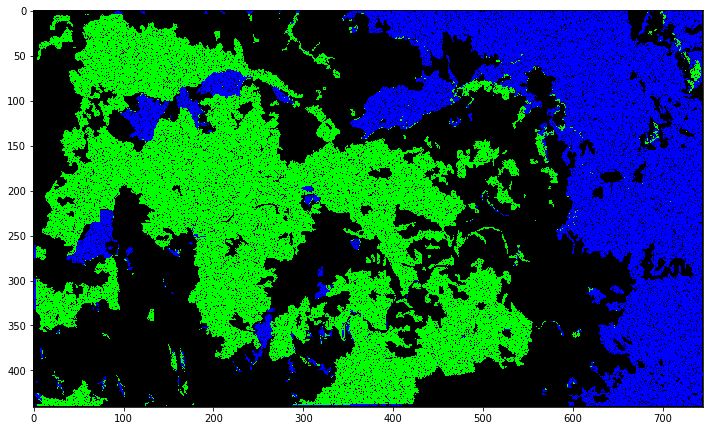

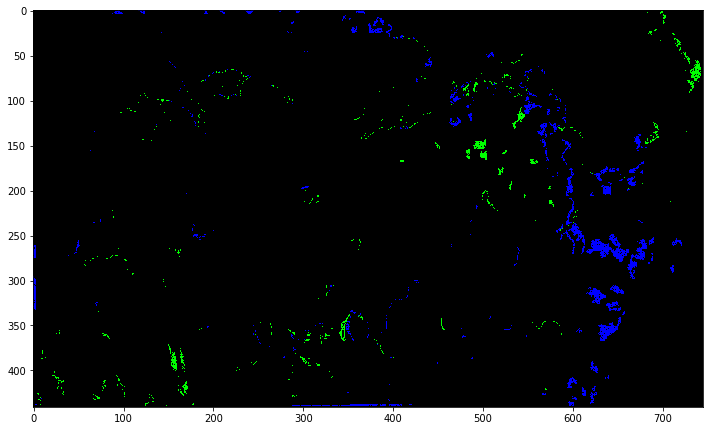

In [259]:
imshow(classes=clmap1_kirrama,figsize=(fg,fg),interpolation='none')

#gtresultst1 = clmap1 * (hnon != 0)
gtresults_testing_kirrama = clmap1_kirrama * (testing_pixels_kirrama != 0)
print("Classifier Results")
unique, counts = np.unique(gtresults_testing_kirrama, return_counts=True)

v = imshow(classes=gtresults_testing_kirrama,figsize=(fg,fg),interpolation='none')
testing_errors2_kirrama = gtresults_testing_kirrama * (gtresults_testing_kirrama != testing_pixels_kirrama)
print("Testing Errors")
unique, counts = np.unique(testing_errors2_kirrama, return_counts=True)

imshow(classes=testing_errors2_kirrama,figsize=(fg,fg),interpolation='none')

In [260]:
classification_metrics(testing_pixels_kirrama,gtresults_testing_kirrama)



Cohen's Kappa:
0.9173289318596574

Balanced Accuracy:
0.9612460045312752


               precision    recall  f1-score   support

   Eucalyptus      0.978     0.952     0.965     94308
NonEucalyptus      0.935     0.970     0.952     66245

     accuracy                          0.960    160553
    macro avg      0.957     0.961     0.959    160553
 weighted avg      0.960     0.960     0.960    160553



Predicted,Eucalyptus,NonEucalyptus
Actual,,
Eucalyptus,0.952411,0.067749
NonEucalyptus,0.021016,0.970081


In [229]:
classification_metrics(testing_pixels_kirrama,gtresults_testing_kirrama)



Cohen's Kappa:
0.9181872613921201

Balanced Accuracy:
0.9615832216291802


               precision    recall  f1-score   support

   Eucalyptus      0.978     0.953     0.966    102707
NonEucalyptus      0.936     0.970     0.953     72116

     accuracy                          0.960    174823
    macro avg      0.957     0.962     0.959    174823
 weighted avg      0.961     0.960     0.960    174823



Predicted,Eucalyptus,NonEucalyptus
Actual,,
Eucalyptus,0.953285,0.066532
NonEucalyptus,0.021148,0.969882


___


# Third Location: Danbulla
___

In [841]:
rpathd= "/Users/brian/code/firedamage/Danbulla1/a3697847-9819-47d7-b667-58e52236a785/1/files/"

stem = "LC08_L1TP_096072_20191108_20191115"
fntag = "danbulla"
ls2envi_full(rpathd,stem,fntag)

sdsd = gdal.Open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.tif")
driver = gdal.GetDriverByName('ENVI')
dst = driver.CreateCopy("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil",sdsd)
dst = None
spy_image_danbulla = envi.open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.hdr",
                      image="/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil")


In [105]:
subset2mi_danbulla = fpdf[fpdf.intersects(danbulla)]
len(subset2mi_danbulla)

834

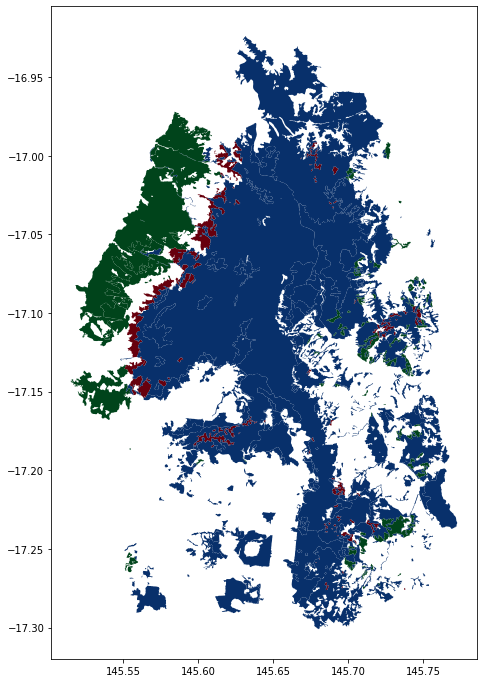

In [284]:
# Danbulla
subset2m = eucmg[eucmg.intersects(danbulla)]
subset2 = euc[euc.intersects(danbulla)]
subset2ne = noneuc[noneuc.intersects(danbulla)]
ax = subset2.plot(color='white',figsize=(fg,fg))

cmap_reds=plt.cm.get_cmap('Reds', 2)
cmap_blues=plt.cm.get_cmap('Blues', 2)
cmap_greens=plt.cm.get_cmap('Greens', 2)

subset2x = subset2
subset2x.plot(ax=ax,color=cmap_reds(2),figsize=(fg,fg))
        
subset2x = subset2ne
subset2x.plot(ax=ax,color=cmap_blues(2),figsize=(fg,fg))

subset2x = subset2m
subset2x.plot(ax=ax,color=cmap_greens(2),figsize=(fg,fg))

needed_danbulla_polygons = pd.concat([subset2,subset2ne,subset2m])

In [115]:
%run create_training_polygons
print('loaded')
hsf_danbulla = "/Users/brian/code/Eucalyptus_GLMClassifier/danbulla_reflectance_full.tif"
#hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
hnon_danbulla = xkpls_m(hsf_danbulla,spy_image_danbulla,8,subset2mi_danbulla,4326,4283,32655,0,580,0,571,zgz)

ready...
loaded
------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
347115.0 -1909545.0 364245.0 -1892145.0
---------spoly-------------
POLYGON ((347115 -1892145, 347115 -1909545, 364245 -1909545, 364245 -1892145, 347115 -1892145))
image pixel dimensions:
(580, 571, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (347115.0, -1909545.0, 364245.0, -1892145.0)
chd:17400.0 cwd:17130.0
poly number: 1
0
dfn: 834
0
hits number: 402
0 of 402
1 of 402
2 of 402
3 of 402
4 of 402
5 of 402
6 of 402
7 of 402
8 of 402
9 of 402
10 of 402
11 of 402
12 of 402
13 of 402
14 of 402
15 of 402
16 of 402
17 of 402
18 of 402
19 of 402
20 of 402
21 of 402
22 of 402
23 of 402
24 of 402
25 of 402
26 of 402
27 of 402
28 of 402
29 of 402
30 of 402
31 of 402
32 of 402
33 of 402
34 of 402
35 of 402
36 of 402
37 of 402
38 of 402
39 of 402
40 of 402
41 of 402
42 of 402
43 of 402
44 of 402
45 of 402
46 of 402
47 of 402
48 of 402
49 of 402
50 of 402
51 of 402
52 of 402
53 of 402
54 of 402
55 of 402
56 of 402
57 of 402
58 of 402
59 of 402
60 of 402
61 of 402
62 of 402
63 of 402
64 of 402
65 of 402
66 of 402
67 of 402
68 of 402
69 of 402
70 of 402
71 of 402
72 of 402
73 of 402
74 of 402
75 of 402
76 of 402
77 of 402
78 of 402
79 of 402
80 of 402
81 of 402
82 of 402
83 of 402
84 of 402
85 of 402
86 of 402
87 of 402
88

In [117]:
np.savetxt("hnon_danbulla.txt",hnon_danbulla,delimiter=',')


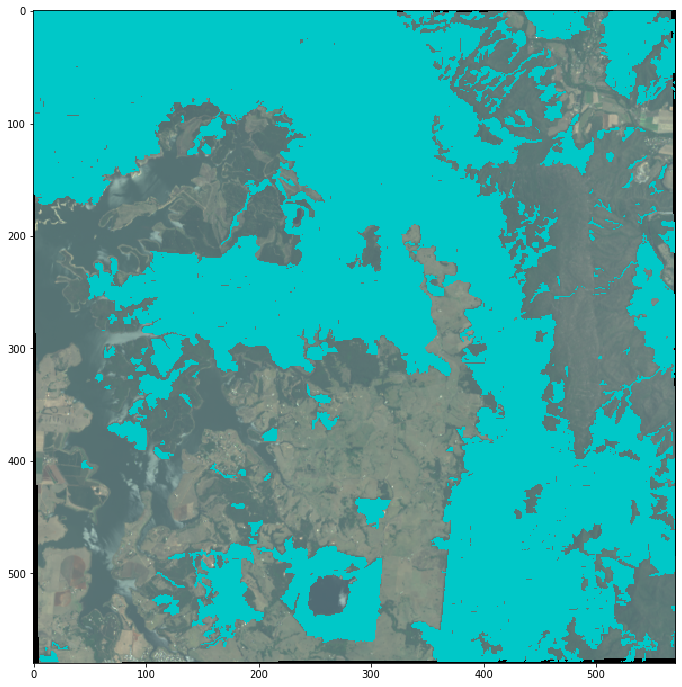

In [118]:
view = imshow(spy_image_danbulla, (3, 2, 1), classes=hnon_danbulla,figsize=(fg,fg),interpolation='none')
view.set_display_mode('overlay')
view.class_alpha = 1.0

In [295]:
hnon_danbulla_reload = np.loadtxt('hnon_danbulla.txt',dtype=float,delimiter=',')


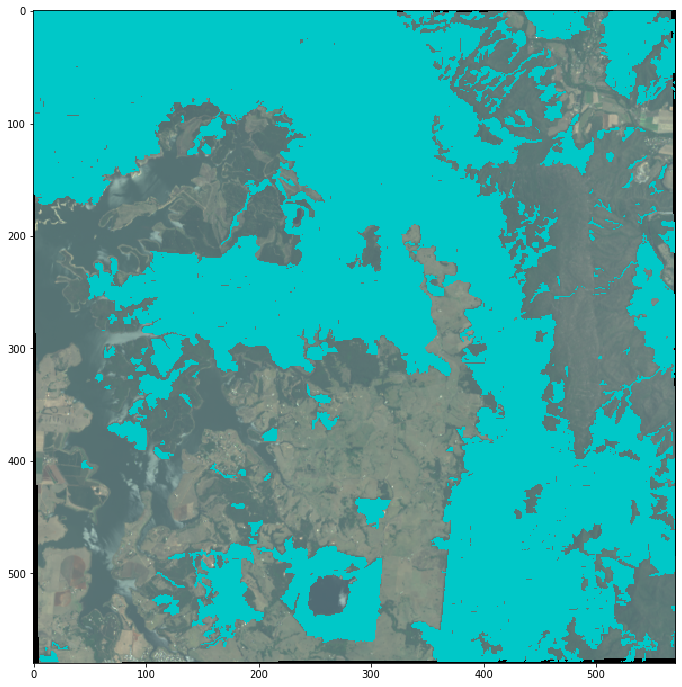

In [296]:
view = imshow(spy_image_danbulla, (3, 2, 1), classes=hnon_danbulla_reload,figsize=(fg,fg),interpolation='none')
view.set_display_mode('overlay')
view.class_alpha = 1.0

In [269]:
tandt_danbulla = split_pixels_training_testing(hnon_danbulla,0.25)
training_pixels_danbulla = tandt_danbulla[0]
testing_pixels_danbulla = tandt_danbulla[1]

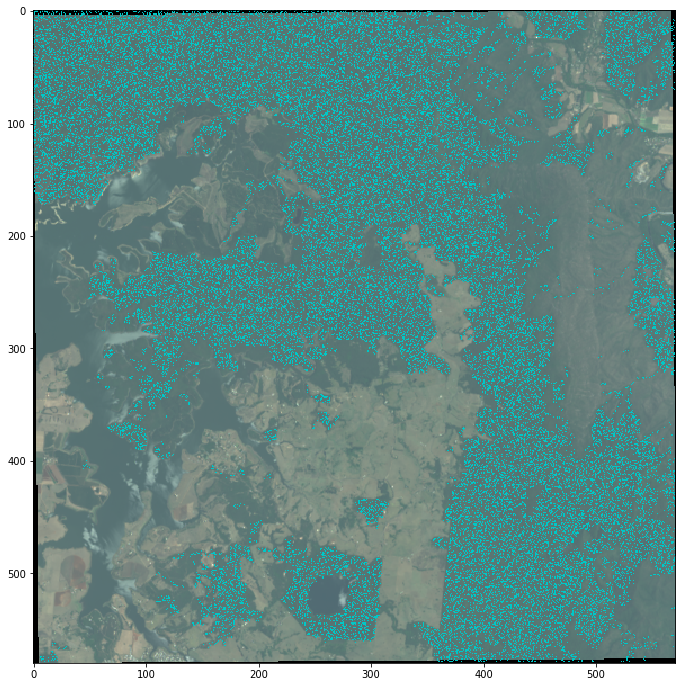

In [270]:
view = imshow(spy_image_danbulla, (3, 2, 1), classes=training_pixels_danbulla,figsize=(fg,fg),interpolation='none')
view.set_display_mode('overlay')
view.class_alpha = 1.0

In [271]:
import spectral as spy
traint_danbulla = spy.create_training_classes(spy_image_danbulla,training_pixels_danbulla)
gmlc1_danbulla = GaussianClassifier(traint_danbulla)
clmap1_danbulla = gmlc1_danbulla.classify_image(spy_image_danbulla)

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


ImageView object:
  Interpolation       :  none

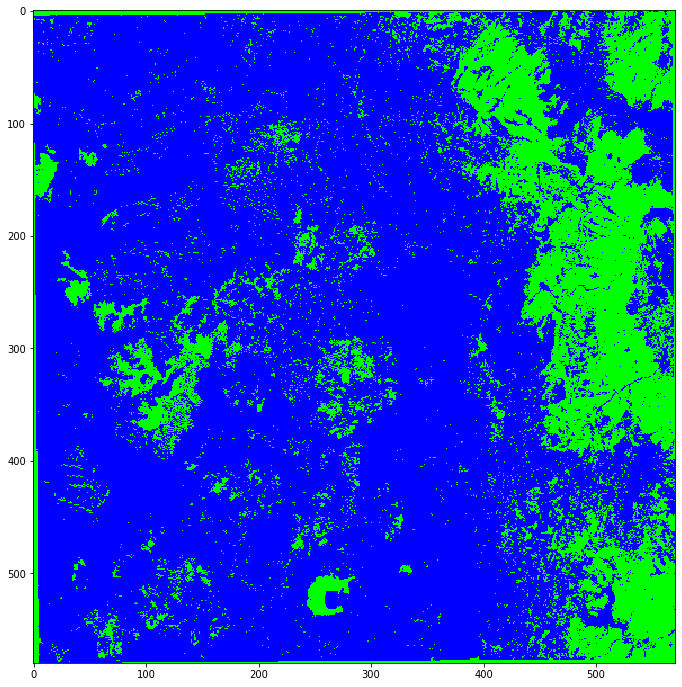

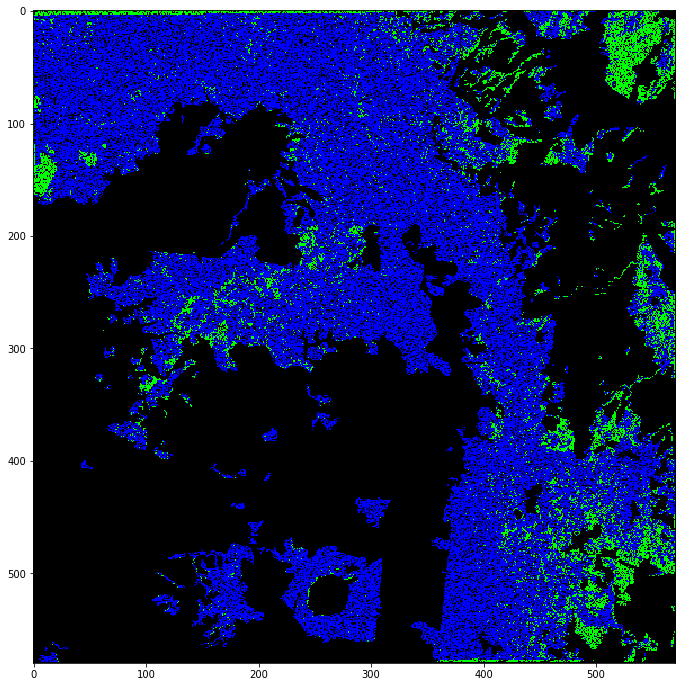

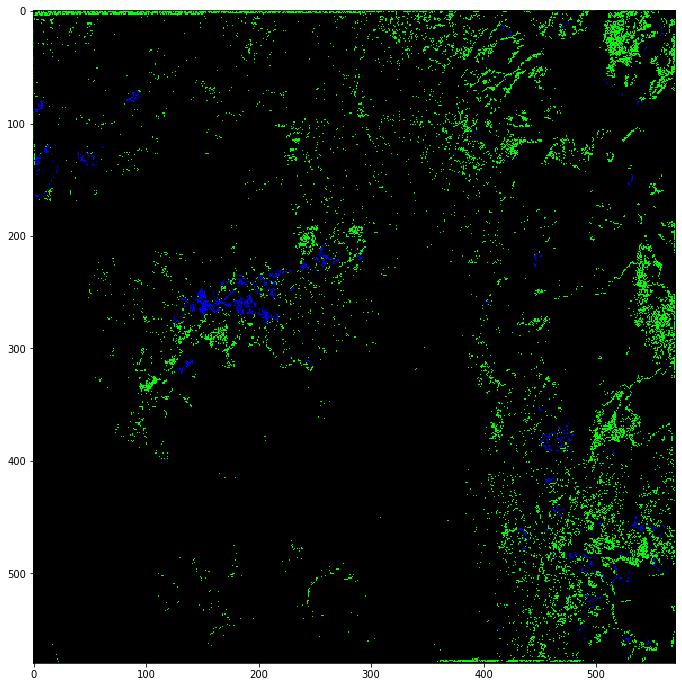

In [272]:
imshow(classes=clmap1_danbulla,figsize=(fg,fg),interpolation='none')

#gtresultst1 = clmap1 * (hnon != 0)
gtresults_testing_danbulla = clmap1_danbulla * (testing_pixels_danbulla != 0)
unique, counts = np.unique(gtresults_testing_danbulla, return_counts=True)

v = imshow(classes=gtresults_testing_danbulla,figsize=(fg,fg),interpolation='none')
testing_errors2_danbulla = gtresults_testing_danbulla * (gtresults_testing_danbulla != testing_pixels_danbulla)
unique, counts = np.unique(testing_errors2_danbulla, return_counts=True)

imshow(classes=testing_errors2_danbulla,figsize=(fg,fg),interpolation='none')

In [273]:
classification_metrics(testing_pixels_danbulla,gtresults_testing_danbulla)



Cohen's Kappa:
0.3078279166550608

Balanced Accuracy:
0.8089243814829579


               precision    recall  f1-score   support

   Eucalyptus      0.235     0.734     0.357      5396
NonEucalyptus      0.986     0.884     0.932    110667

     accuracy                          0.877    116063
    macro avg      0.611     0.809     0.644    116063
 weighted avg      0.951     0.877     0.905    116063



Predicted,Eucalyptus,NonEucalyptus
Actual,,
Eucalyptus,0.734062,0.012967
NonEucalyptus,2.383432,0.883786


In [832]:
def train_and_apply(hnon_training_loc,hnon_target_loc,spy_image_training_loc,spy_image_target_loc,fg):
    traint_training_loc_full = spy.create_training_classes(spy_image_training_loc,hnon_training_loc)
    gmlc1_training_loc_full = GaussianClassifier(traint_training_loc_full)
    clmap1_target_loc_training_loc_full = gmlc1_training_loc_full.classify_image(spy_image_target_loc)

    gtresults_target_loc_training_loc_full = clmap1_target_loc_training_loc_full * (hnon_target_loc != 0)

    v = imshow(classes=gtresults_target_loc_training_loc_full,figsize=(fg,fg),interpolation='none')
    testing_errors2_target_loc_training_loc_full = gtresults_target_loc_training_loc_full * (gtresults_target_loc_training_loc_full != hnon_target_loc)
    unique, counts = np.unique(testing_errors2_target_loc_training_loc_full, return_counts=True)

    imshow(classes=testing_errors2_target_loc_training_loc_full,figsize=(fg,fg),interpolation='none')

    classification_metrics(hnon_target_loc,gtresults_target_loc_training_loc_full) 
    
def train_and_apply2(hnon_training_loc,hnon_target_loc,spy_image_training_loc,spy_image_target_loc,fg):
    traint_training_loc_full = spy.create_training_classes(spy_image_training_loc,hnon_training_loc)
    gmlc1_training_loc_full = GaussianClassifier(traint_training_loc_full)
    clmap1_target_loc_training_loc_full = gmlc1_training_loc_full.classify_image(spy_image_target_loc)

    print(clmap1_target_loc_training_loc_full.__dir__())
    print(type(hnon_target_loc))
    gtresults_target_loc_training_loc_full = clmap1_target_loc_training_loc_full * (hnon_target_loc != 0)

    v = imshow(classes=gtresults_target_loc_training_loc_full,figsize=(fg,fg),interpolation='none')
    testing_errors2_target_loc_training_loc_full = gtresults_target_loc_training_loc_full * (gtresults_target_loc_training_loc_full != hnon_target_loc)
    unique, counts = np.unique(testing_errors2_target_loc_training_loc_full, return_counts=True)

    imshow(classes=testing_errors2_target_loc_training_loc_full,figsize=(fg,fg),interpolation='none')

    classification_metrics(hnon_target_loc,gtresults_target_loc_training_loc_full) 
    
    


ImageView object:
  Interpolation       :  none

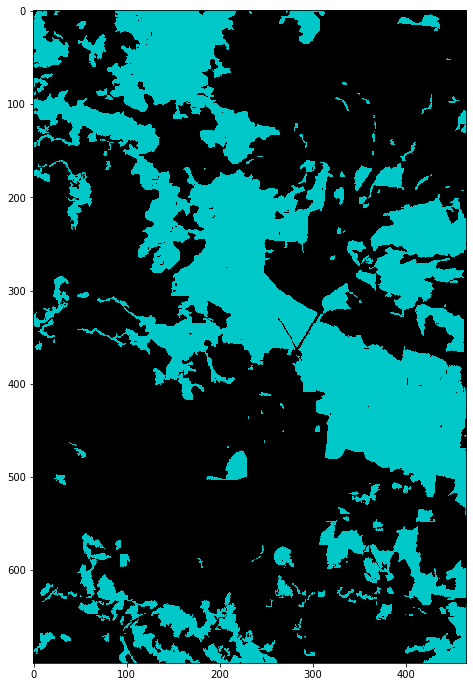

In [847]:
imshow(classes=hnon_herberton,figsize=(fg,fg),interpolation='none')

ImageView object:
  Display bands       :  [0, 6, 11]
  Interpolation       :  <default>
  RGB data limits     :
    R: [0.0, 17225.0]
    G: [0.0, 26500.0]
    B: [0.0, 2720.0]

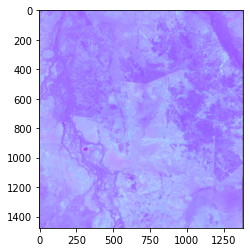

In [848]:
imshow(spy_image)

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  
['__repr__', '__hash__', '__str__', '__lt__', '__le__', '__eq__', '__ne__', '__gt__', '__ge__', '__iter__', '__add__', '__radd__', '__sub__', '__rsub__', '__mul__', '__rmul__', '__mod__', '__rmod__', '__divmod__', '__rdivmod__', '__pow__', '__rpow__', '__neg__', '__pos__', '__abs__', '__bool__', '__invert__', '__lshift__', '__rlshift__', '__rshift__', '__rrshift__', '__and__', '__rand__', '__xor__', '__rxor__', '__or__', '__ror__', '__int__', '__float__', '__iadd__', '__isub__', '__imul__', '__imod__', '__ipow__', '__ilshift__', '__irshift__', '__iand__', '__ixor__', '__ior__', '__floordiv__', '__rfloordiv__', '__truediv__', '__rtruediv__', '__ifloordiv__', '__itruediv__', '__index__', '__matmul__', '__rmatmul__', '__imatmul__', '__len__', '__getitem__', '__setitem__', '__delitem__', '__contains__', '__new__', '__

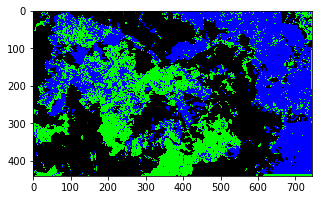

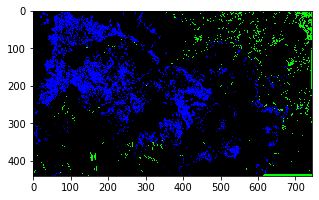

In [843]:
train_and_apply2(hnon_danbulla,hnon_kirrama,spy_image_danbulla,spy_image_kirrama,5) # fix?

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  
['__repr__', '__hash__', '__str__', '__lt__', '__le__', '__eq__', '__ne__', '__gt__', '__ge__', '__iter__', '__add__', '__radd__', '__sub__', '__rsub__', '__mul__', '__rmul__', '__mod__', '__rmod__', '__divmod__', '__rdivmod__', '__pow__', '__rpow__', '__neg__', '__pos__', '__abs__', '__bool__', '__invert__', '__lshift__', '__rlshift__', '__rshift__', '__rrshift__', '__and__', '__rand__', '__xor__', '__rxor__', '__or__', '__ror__', '__int__', '__float__', '__iadd__', '__isub__', '__imul__', '__imod__', '__ipow__', '__ilshift__', '__irshift__', '__iand__', '__ixor__', '__ior__', '__floordiv__', '__rfloordiv__', '__truediv__', '__rtruediv__', '__ifloordiv__', '__itruediv__', '__index__', '__matmul__', '__rmatmul__', '__imatmul__', '__len__', '__getitem__', '__setitem__', '__delitem__', '__contains__', '__new__', '__

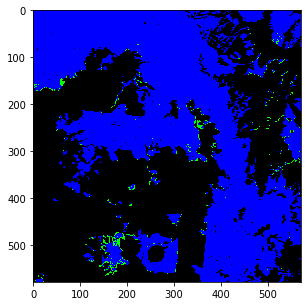

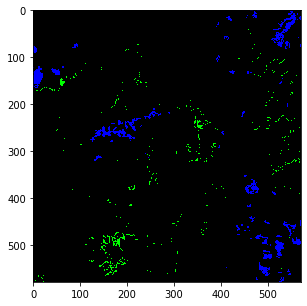

In [846]:
train_and_apply2(hnon_kirrama,hnon_danbulla,spy_image_kirrama,spy_image_danbulla,5) # fix?

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.9175880329599101

Balanced Accuracy:
0.9613507991465788


               precision    recall  f1-score   support

   Eucalyptus      0.978     0.953     0.965    104779
NonEucalyptus      0.935     0.970     0.952     73610

     accuracy                          0.960    178389
    macro avg      0.957     0.961     0.959    178389
 weighted avg      0.960     0.960     0.960    178389



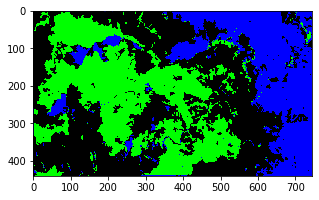

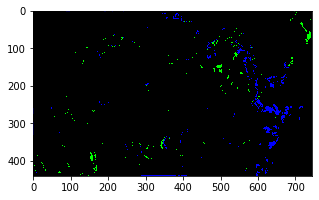

In [829]:
train_and_apply(hnon_kirrama,hnon_kirrama,spy_image_kirrama,spy_image_kirrama,5) 

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...  1.Classifying image...  2.Classifying image...  3.Classifying image...  4.Classifying image...  5.Classifying image...  6.Classifying image...  7.Classifying image...  8.Classifying image...  9.Classifying image... 10.Classifying image... 11.Classifying image... 12.Classifying image... 13.Classifying image... 14.Classifying image... 15.Classifying image... 16.Classifying image... 17.Classifying image... 18.Classifying image... 19.Classifying image... 20.Classifying image... 21.Classifying image... 22.Classifying image... 23.Classifying image... 24.Classifying image... 25.Classifying image... 26.Classifying image... 27.Classifying image... 28.Classifying image... 29.Classifying image... 30.Classifying image... 31.Classifying image... 32.Classifying image... 33.Classifying image... 34.Classifying image... 35.Classifying 

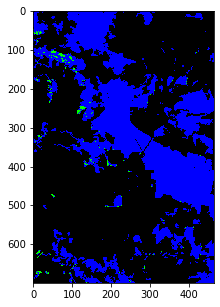

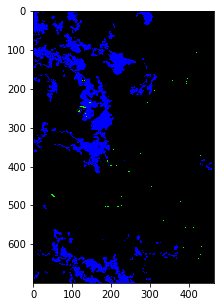

In [279]:
train_and_apply(hnon_kirrama,hnon_herberton,spy_image_kirrama,spy_image,5)

In [844]:
train_and_apply(hnon_kirrama,hnon_herberton,spy_image_kirrama,spy_image,5) # fixed?

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


ValueError: operands could not be broadcast together with shapes (1477,1382) (700,465) 

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.013583784913965835

Balanced Accuracy:
0.5058031790471189


               precision    recall  f1-score   support

   Eucalyptus      0.590     0.996     0.741    104779
NonEucalyptus      0.733     0.016     0.031     73610

     accuracy                          0.591    178389
    macro avg      0.662     0.506     0.386    178389
 weighted avg      0.649     0.591     0.448    178389



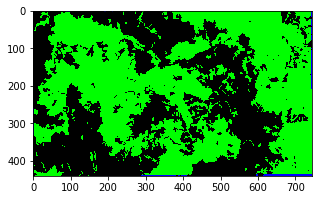

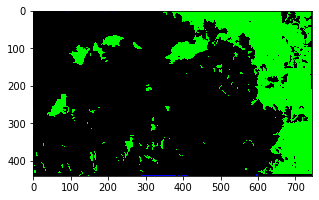

In [276]:
train_and_apply(hnon_herberton,hnon_kirrama,spy_image,spy_image_kirrama,5)

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.013583784913965835

Balanced Accuracy:
0.5058031790471189


               precision    recall  f1-score   support

   Eucalyptus      0.590     0.996     0.741    104779
NonEucalyptus      0.733     0.016     0.031     73610

     accuracy                          0.591    178389
    macro avg      0.662     0.506     0.386    178389
 weighted avg      0.649     0.591     0.448    178389



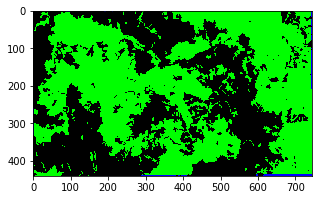

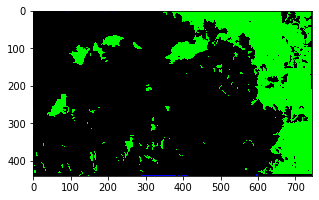

In [850]:
train_and_apply(hnon_herberton,hnon_kirrama,spy_image_herberton,spy_image_kirrama,5)

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
-0.0005348861251510684

Balanced Accuracy:
0.49711893756183906


               precision    recall  f1-score   support

   Eucalyptus      0.046     0.982     0.087      7098
NonEucalyptus      0.933     0.012     0.023    147614

     accuracy                          0.056    154712
    macro avg      0.489     0.497     0.055    154712
 weighted avg      0.893     0.056     0.026    154712



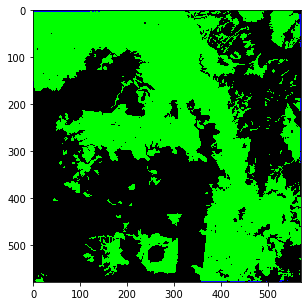

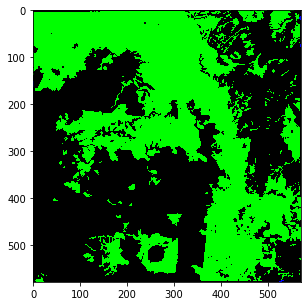

In [277]:
train_and_apply(hnon_herberton,hnon_danbulla,spy_image,spy_image_danbulla,5)

In [851]:
train_and_apply(hnon_herberton,hnon_danbulla,spy_image,spy_image_danbulla,5)

spectral:INFO: Setting min samples to 12


ValueError: Mask shape does not match image.

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.004082562815606483

Balanced Accuracy:
0.5015127936632672


               precision    recall  f1-score   support

   Eucalyptus      0.052     0.024     0.033      7098
NonEucalyptus      0.954     0.979     0.967    147614

     accuracy                          0.935    154712
    macro avg      0.503     0.502     0.500    154712
 weighted avg      0.913     0.935     0.924    154712



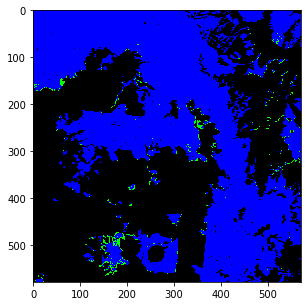

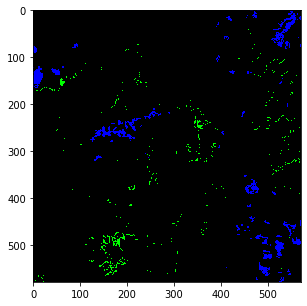

In [278]:
train_and_apply(hnon_kirrama,hnon_danbulla,spy_image_kirrama,spy_image_danbulla,5)

In [ ]:
traint_kirrama = spy.create_training_classes(spy_image_kirrama,training_pixels_kirrama)
gmlc1_kirrama = GaussianClassifier(traint_kirrama)
clmap1_kirrama = gmlc1_kirrama.classify_image(spy_image_kirrama)

In [297]:
type(traint_kirrama)

spectral.algorithms.algorithms.TrainingClassSet

In [299]:
txkirrama = traint_kirrama
txherberton = traint

/usr/local/lib/python3.7/site-packages/geopandas/plotting.py:607: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/c

ready...
loaded
------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
619695.0 -2295255.0 661815.0 -2250615.0
---------spoly-------------
POLYGON ((619695 -2250615, 619695 -2295255, 661815 -2295255, 661815 -2250615, 619695 -2250615))
image pixel dimensions:
(1488, 1404, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (619695.0, -2295255.0, 661815.0, -2250615.0)
chd:44640.0 cwd:42120.0
poly number: 1
0
dfn: 88
0
hits number: 88
done.


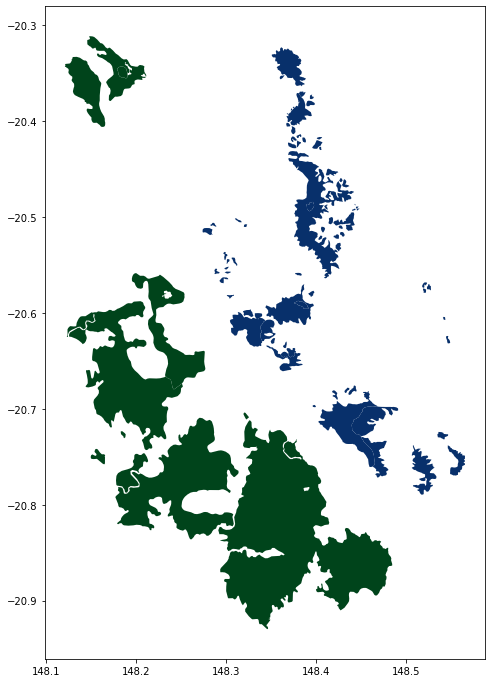

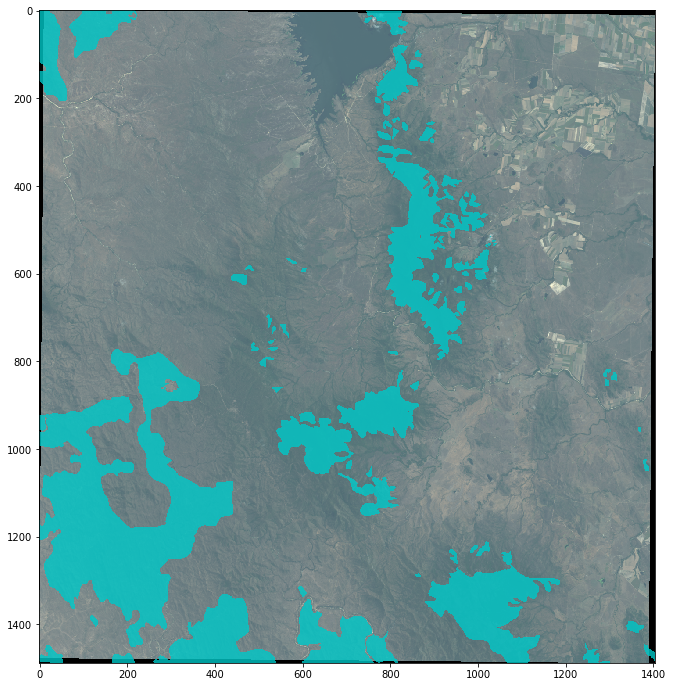

In [607]:
andromache =  Polygon([[
              148.15,
              -20.35
            ],
            [
              148.15,
              -20.75
            ],
            [
              148.54999999999998,
              -20.75
            ],
            [
              148.54999999999998,
              -20.35
            ],
            [
              148.15,
              -20.35
            ]])

rpathd= "/Users/brian/code/Eucalyptus_GLMClassifier/andromache/f53233e0-8239-4330-8d69-4c08ac5d033d/Landsat8L1G/"

stem = "LC08_L1TP_093074_20191018_20191029"
fntag = "andromache"
ls2envi_full(rpathd,stem,fntag)

sdsd = gdal.Open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.tif")
driver = gdal.GetDriverByName('ENVI')
dst = driver.CreateCopy("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil",sdsd)
dst = None
spy_image_andromache = envi.open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.hdr",
                      image="/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil")

subset2mi_andromache = fpdf[fpdf.intersects(andromache)]
len(subset2mi_andromache)

# andromache
subset2m = eucmg[eucmg.intersects(andromache)]
subset2 = euc[euc.intersects(andromache)]
subset2ne = noneuc[noneuc.intersects(andromache)]
ax = subset2.plot(color='white',figsize=(fg,fg))

cmap_reds=plt.cm.get_cmap('Reds', 2)
cmap_blues=plt.cm.get_cmap('Blues', 2)
cmap_greens=plt.cm.get_cmap('Greens', 2)

subset2x = subset2
subset2x.plot(ax=ax,color=cmap_reds(2),figsize=(fg,fg))
        
subset2x = subset2ne
subset2x.plot(ax=ax,color=cmap_blues(2),figsize=(fg,fg))

subset2x = subset2m
subset2x.plot(ax=ax,color=cmap_greens(2),figsize=(fg,fg))

needed_andromache_polygons = pd.concat([subset2,subset2ne,subset2m])

%run create_training_polygons
print('loaded')
hsf_andromache = "/Users/brian/code/Eucalyptus_GLMClassifier/andromache_reflectance_full.tif"
#hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
hnon_andromache = xkpls_m(hsf_andromache,spy_image_andromache,8,subset2mi_andromache,4326,4283,32655,0,1488,0,1404,zgz)

np.savetxt("hnon_andromache.txt",hnon_andromache,delimiter=',')

view = imshow(spy_image_andromache, (3, 2, 1), classes=hnon_andromache,figsize=(fg,fg),interpolation='none')
view.set_display_mode('overlay')
view.class_alpha = 0.8

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.9782495616654158

Balanced Accuracy:
0.9887822179777452


               precision    recall  f1-score   support

   Eucalyptus      0.989     0.993     0.991    164572
NonEucalyptus      0.989     0.985     0.987    114950

     accuracy                          0.989    279522
    macro avg      0.989     0.989     0.989    279522
 weighted avg      0.989     0.989     0.989    279522



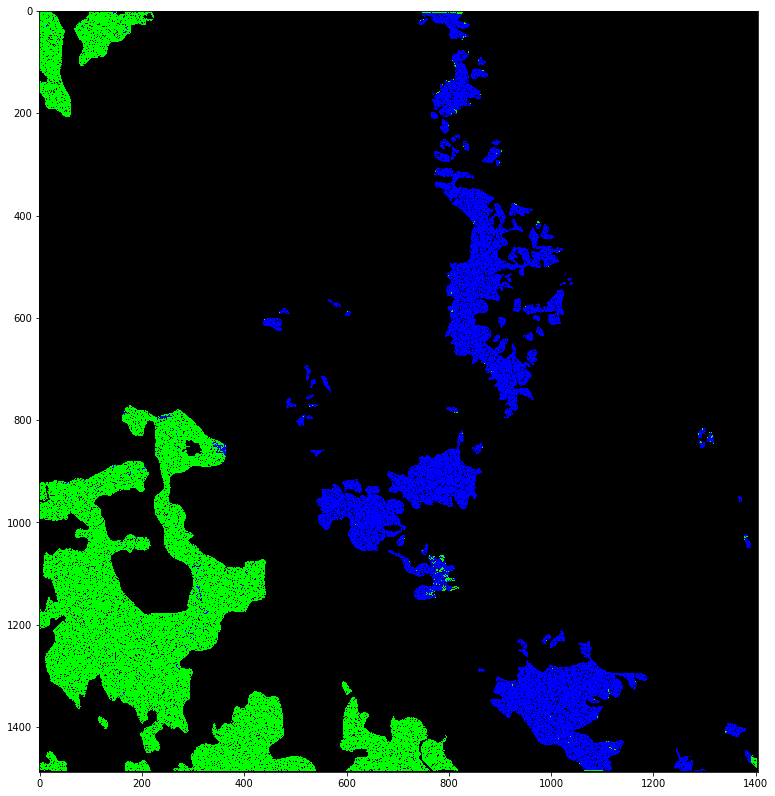

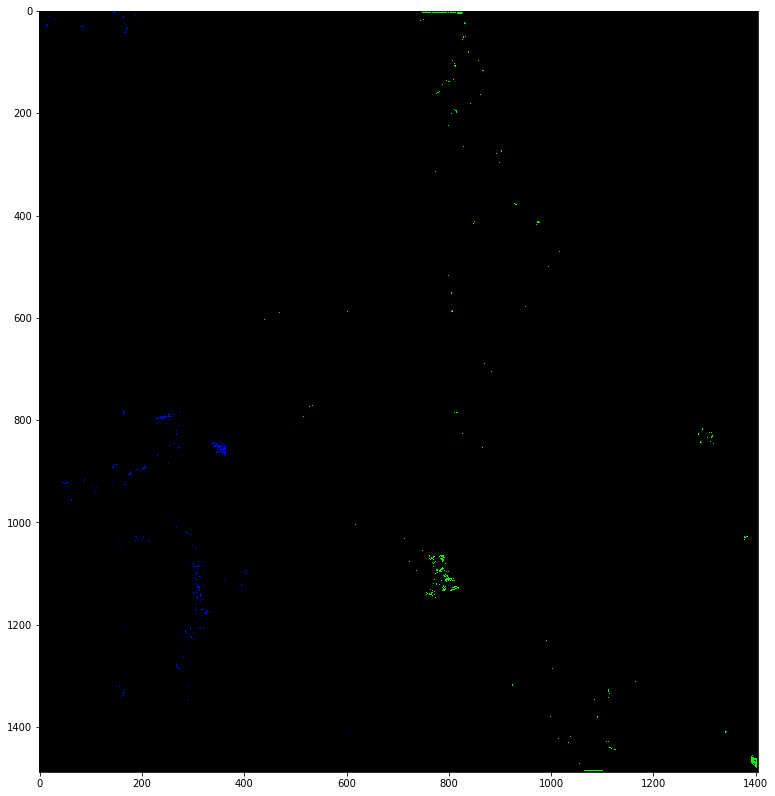

In [624]:
tandt = split_pixels_training_testing(hnon_andromache,0.1)
training_pixels = tandt[0]
testing_pixels = tandt[1]
train_and_apply_single(training_pixels,testing_pixels,spy_image_andromache,14)

ready...
loaded
------ xkpls_m
------src.ref_____
EPSG:32656
---------lbrt-------------
440985.0 -3163845.0 500025.0 -3097185.0
---------spoly-------------
POLYGON ((440985 -3097185, 440985 -3163845, 500025 -3163845, 500025 -3097185, 440985 -3097185))
image pixel dimensions:
(2222, 1968, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (440985.0, -3163845.0, 500025.0, -3097185.0)
chd:66660.0 cwd:59040.0
poly number: 1
0
dfn: 690
0
hits number: 690
done.


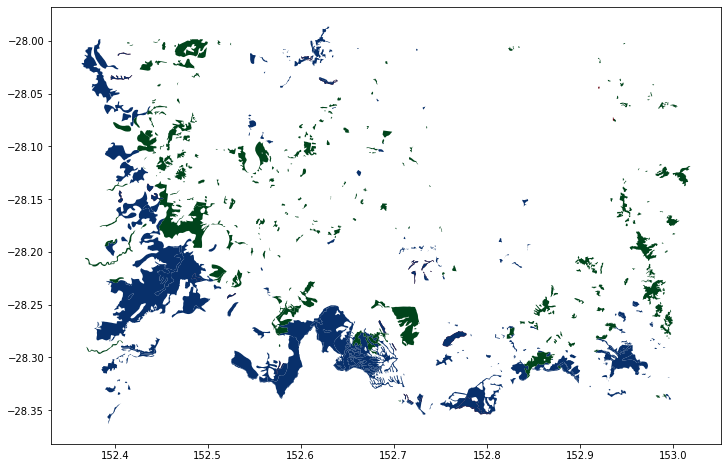

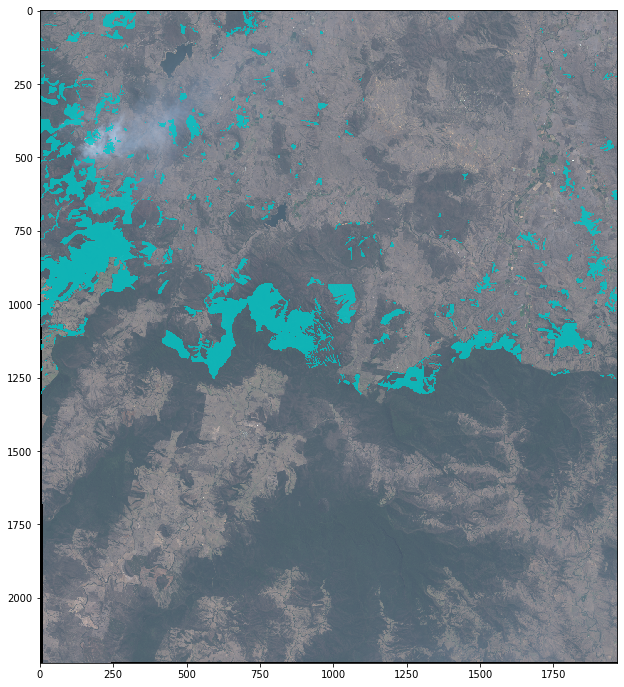

In [628]:
mountbarney =  Polygon([[
              152.39999999999998,
              -28
            ],
            [
              152.39999999999998,
              -28.6
            ],
            [
              153,
              -28.6
            ],
            [
              153,
              -28
            ],
            [
              152.39999999999998,
              -28
            ]])

rpathd= "/Users/brian/code/Eucalyptus_GLMClassifier/mountbarney/3555e1d9-0af9-4869-8708-9ffe50d82f90/Landsat8L1G/"

stem = "LC08_L1TP_089080_20191106_20191115"
fntag = "mountbarney"
ls2envi_full(rpathd,stem,fntag)

sdsd = gdal.Open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.tif")
driver = gdal.GetDriverByName('ENVI')
dst = driver.CreateCopy("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil",sdsd)
dst = None
spy_image_mountbarney = envi.open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.hdr",
                      image="/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil")

subset2mi_mountbarney = fpdf[fpdf.intersects(mountbarney)]
len(subset2mi_mountbarney)

# mountbarney
subset2m = eucmg[eucmg.intersects(mountbarney)]
subset2 = euc[euc.intersects(mountbarney)]
subset2ne = noneuc[noneuc.intersects(mountbarney)]
ax = subset2.plot(color='white',figsize=(fg,fg))

cmap_reds=plt.cm.get_cmap('Reds', 2)
cmap_blues=plt.cm.get_cmap('Blues', 2)
cmap_greens=plt.cm.get_cmap('Greens', 2)

subset2x = subset2
subset2x.plot(ax=ax,color=cmap_reds(2),figsize=(fg,fg))
        
subset2x = subset2ne
subset2x.plot(ax=ax,color=cmap_blues(2),figsize=(fg,fg))

subset2x = subset2m
subset2x.plot(ax=ax,color=cmap_greens(2),figsize=(fg,fg))

needed_mountbarney_polygons = pd.concat([subset2,subset2ne,subset2m])

%run create_training_polygons
print('loaded')
hsf_mountbarney = "/Users/brian/code/Eucalyptus_GLMClassifier/mountbarney_reflectance_full.tif"
#hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
hnon_mountbarney = xkpls_m(hsf_mountbarney,spy_image_mountbarney,8,subset2mi_mountbarney,4326,4283,32656,0,2222,0,1968,zgz)

np.savetxt("hnon_mountbarney.txt",hnon_mountbarney,delimiter=',')

view = imshow(spy_image_mountbarney, (3, 2, 1), classes=hnon_mountbarney,figsize=(fg,fg),interpolation='none')
view.set_display_mode('overlay')
view.class_alpha = 0.8

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....  2.0Covariance.....  4.0Covariance.....  6.0Covariance.....  8.0Covariance..... 10.0Covariance..... 12.0Covariance..... 14.0Covariance..... 16.0Covariance..... 18.0Covariance..... 20.0Covariance..... 22.0Covariance..... 24.0Covariance..... 26.0Covariance..... 28.0Covariance..... 30.0Covariance..... 32.0Covariance..... 34.0Covariance..... 36.0Covariance..... 38.0Covariance..... 40.0Covariance..... 42.0Covariance..... 44.0Covariance..... 46.0Covariance..... 48.0Covariance..... 50.0Covariance..... 52.0Covariance..... 54.0Covariance..... 56.0Covariance..... 58.0Covariance..... 60.0Covariance..... 62.0Covariance..... 64.0Covariance..... 66.0Covariance..... 68.0Covariance..... 70.0Covariance..... 72.0Covariance..... 74.0Covariance..... 76.0Covariance..... 78.0Covariance..... 80.0Covariance..... 82.0Covariance..... 84.0Covariance..... 86.0Covariance..... 88.0Covariance..... 90

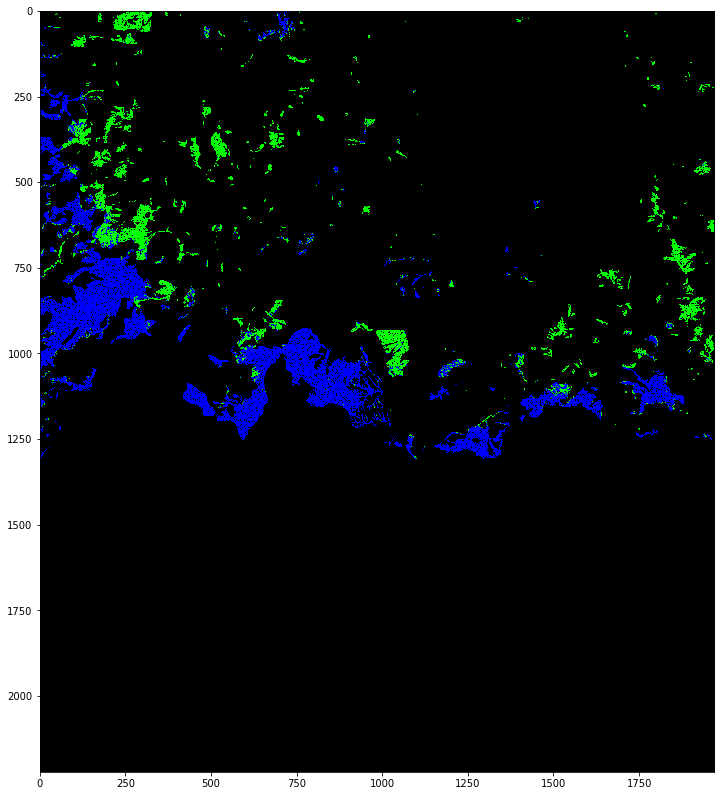

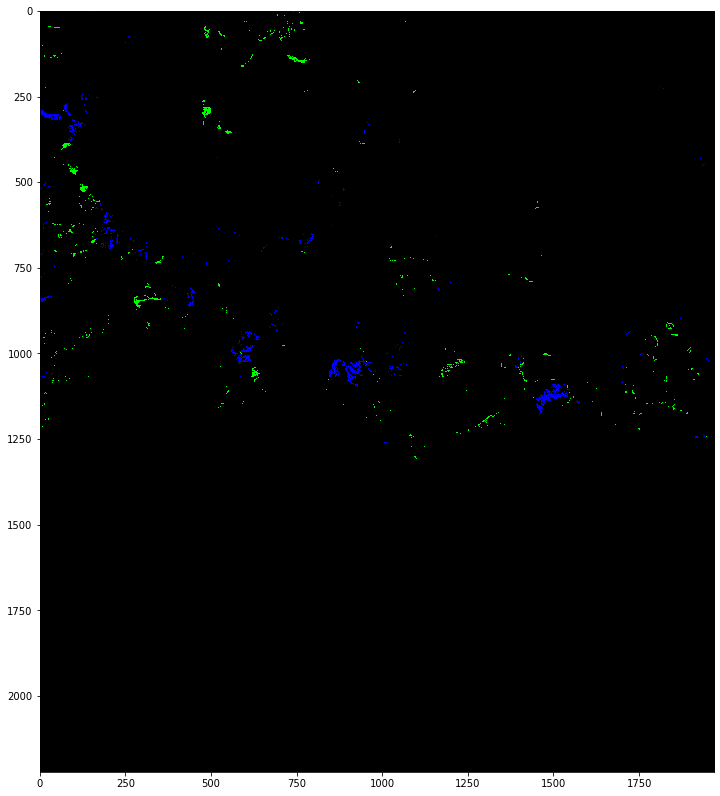

In [641]:
tandt = split_pixels_training_testing(hnon_mountbarney,0.1)
training_pixels = tandt[0]
testing_pixels = tandt[1]
train_and_apply_single(training_pixels,testing_pixels,spy_image_mountbarney,14)

/usr/local/lib/python3.7/site-packages/geopandas/plotting.py:607: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ready...
loaded
------ xkpls_m
------src.ref_____
EPSG:32655
---------lbrt-------------
479265.0 -2427315.0 520725.0 -2383005.0
---------spoly-------------
POLYGON ((479265 -2383005, 479265 -2427315, 520725 -2427315, 520725 -2383005, 479265 -2383005))
image pixel dimensions:
(1477, 1382, 12)


/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
/usr/local/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axi

xpoly.bounds: (479265.0, -2427315.0, 520725.0, -2383005.0)
chd:44310.0 cwd:41460.0
poly number: 1
0
dfn: 244
0
hits number: 244
done.


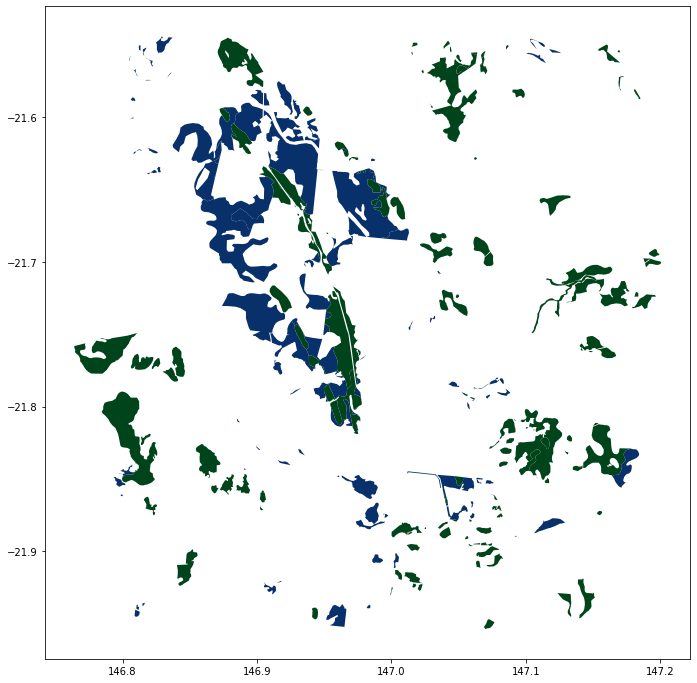

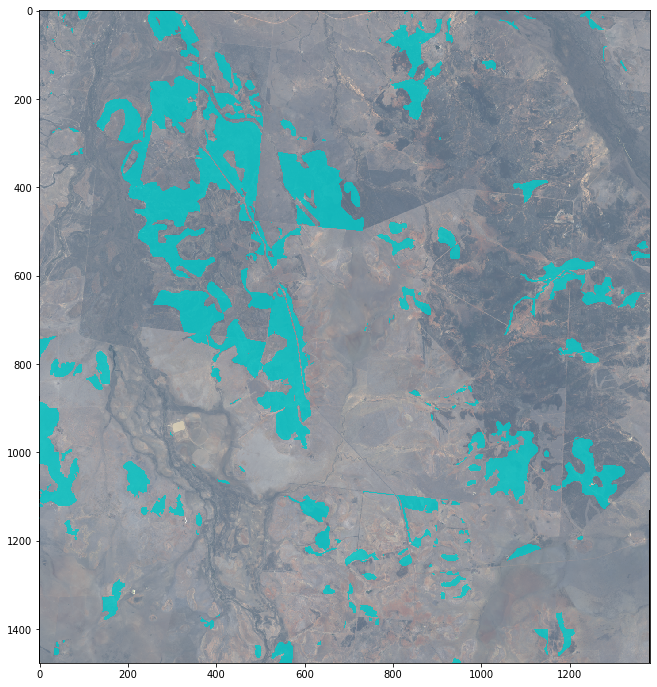

In [608]:
belyando =  Polygon([[
              146.8,
              -21.55
            ],
            [
              146.8,
              -21.95
            ],
            [
              147.2,
              -21.95
            ],
            [
              147.2,
              -21.55
            ],
            [
              146.8,
              -21.55
            ]])

rpathd= "/Users/brian/code/Eucalyptus_GLMClassifier/belyando/8b042a8d-04bf-4716-8f58-3e263c2f147f/Landsat8L1G/"

stem = "LC08_L1TP_094075_20191009_20191018"
fntag = "belyando"
ls2envi_full(rpathd,stem,fntag)

sdsd = gdal.Open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.tif")
driver = gdal.GetDriverByName('ENVI')
dst = driver.CreateCopy("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil",sdsd)
dst = None
spy_image_belyando = envi.open("/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.hdr",
                      image="/Users/brian/code/Eucalyptus_GLMClassifier/"+fntag+"_reflectance_full.bil")

subset2mi_belyando = fpdf[fpdf.intersects(belyando)]
len(subset2mi_belyando)

# belyando
subset2m = eucmg[eucmg.intersects(belyando)]
subset2 = euc[euc.intersects(belyando)]
subset2ne = noneuc[noneuc.intersects(belyando)]
ax = subset2.plot(color='white',figsize=(fg,fg))

cmap_reds=plt.cm.get_cmap('Reds', 2)
cmap_blues=plt.cm.get_cmap('Blues', 2)
cmap_greens=plt.cm.get_cmap('Greens', 2)

subset2x = subset2
subset2x.plot(ax=ax,color=cmap_reds(2),figsize=(fg,fg))
        
subset2x = subset2ne
subset2x.plot(ax=ax,color=cmap_blues(2),figsize=(fg,fg))

subset2x = subset2m
subset2x.plot(ax=ax,color=cmap_greens(2),figsize=(fg,fg))

needed_belyando_polygons = pd.concat([subset2,subset2ne,subset2m])

%run create_training_polygons
print('loaded')
hsf_belyando = "/Users/brian/code/Eucalyptus_GLMClassifier/belyando_reflectance_full.tif"
#hnon = xkpls_m(hsf,spy_image,8,subset2mi,4326,4283,32655,0,441,0,745,zgz)
hnon_belyando = xkpls_m(hsf_belyando,spy_image_belyando,8,subset2mi_belyando,4326,4283,32655,0,1488,0,1404,zgz)

np.savetxt("hnon_belyando.txt",hnon_belyando,delimiter=',')

view = imshow(spy_image_belyando, (3, 2, 1), classes=hnon_belyando,figsize=(fg,fg),interpolation='none')
view.set_display_mode('overlay')
view.class_alpha = 0.8

spectral:INFO: Setting min samples to 12


Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Covariance.....  0.0Covariance.....  0.0Covariance.....done  
Classifying image...  0.Classifying image...done  


Cohen's Kappa:
0.5276376291498746

Balanced Accuracy:
0.7651370360104761


               precision    recall  f1-score   support

   Eucalyptus      0.850     0.650     0.737    108850
NonEucalyptus      0.707     0.880     0.784    104403

     accuracy                          0.763    213253
    macro avg      0.778     0.765     0.760    213253
 weighted avg      0.780     0.763     0.760    213253



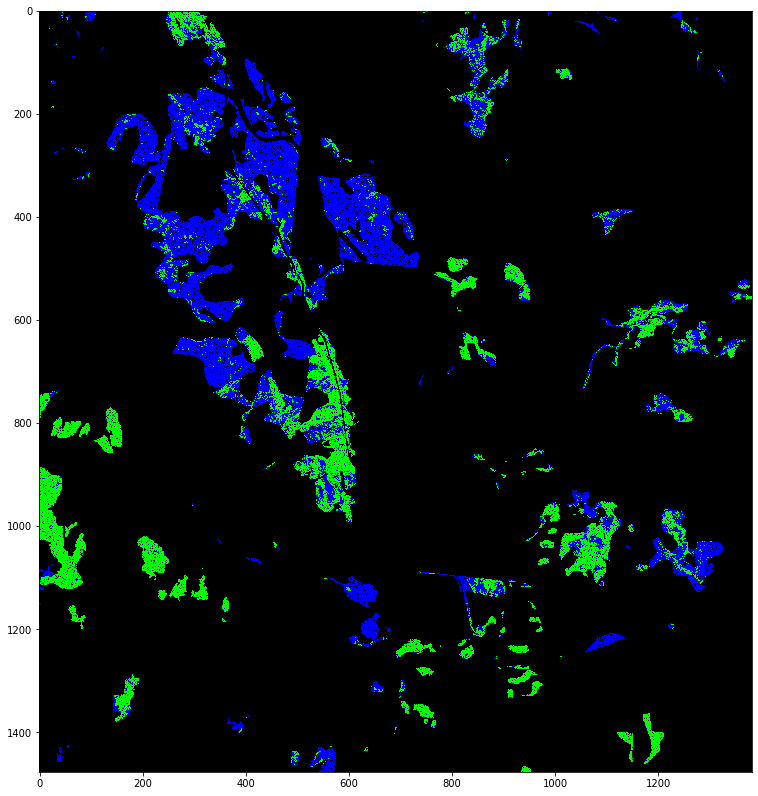

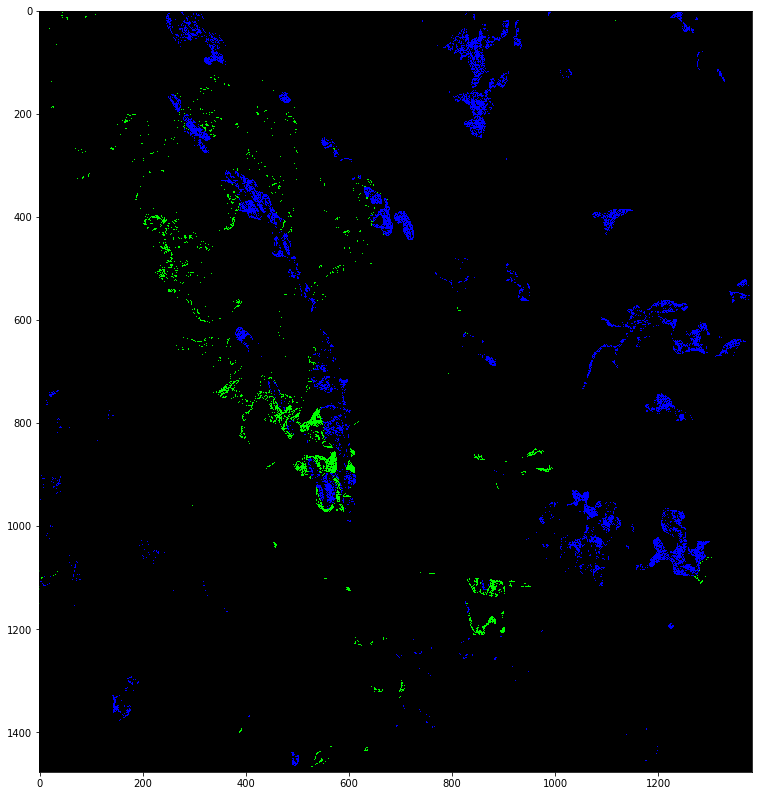

In [625]:
tandt = split_pixels_training_testing(hnon_belyando,0.1)
training_pixels = tandt[0]
testing_pixels = tandt[1]
train_and_apply_single(training_pixels,testing_pixels,spy_image_belyando,14)